# **<a>Lab 5**
**Name :** Karim Gamal Mahmoud Mohamed

**ID : 21kgmm**


> ![](https://miro.medium.com/max/1400/1*bfdCDegptoeb0SKcpoFn8g.jpeg)

> Image by [snowing](https://pl.freepik.com/autor/snowing) from [Freepik.com](https://pl.freepik.com/darmowe-zdjecie/pojecie-audiobooku-ksiazki-na-stol-ze-sluchawkami-na-nich_1203112.htm#page=1&query=audiobook&position=0)  ,This picture contains a red headset and an open book just like that. 🧚


> [Source](https://towardsdatascience.com/wav2vec-2-0-a-framework-for-self-supervised-learning-of-speech-representations-7d3728688cae)

> ## <a> Deep learning based end-to-end speech recognition </a>



> The goal of this assignment is to get familiar with applications that require speech data as input.

> We would be using the torchaudio library (pip install torchaudio==0.11.0), please carefull read this [tutorial](https://pytorch.org/tutorials/intermediate/speech_recognition_pipeline_tutorial.html) 

> Next, we would ask you to perform similar analysis on a speech dataset, i.e., speechdata.zip. Unzip this folder, you would see a folder named wavs, and a file called "labels.csv", containing annotated transcripts, including the files in the wavs folder (you have more labels in labels.csv). This dataset is selected from [This link](https://keithito.com/LJ-Speech-Dataset/,) a famous speech-based application benchmark.

> General torchaudio tutorials: [Link](https://pytorch.org/tutorials/index.html)

> **Submission: submit via onq.** 


> ### Importing Data From Google Drive

In [1]:
%%capture
!gdown --folder https://drive.google.com/drive/folders/1Q2BCKKxocAqo2Bw2L0P73VmUoar63eWw?usp=sharing

In [2]:
%%capture
!unzip "/content/Lab_5/speechdata.zip"

> ### Install `jiwer` package

In [3]:
%%capture
!pip install jiwer

> ### Import needed libraries.

In [4]:
# Import needed libraries. 
import torch
import torchaudio

# Math
from scipy.io import wavfile
from scipy import signal
import numpy as np
import pandas as pd
import librosa
import librosa.display
from IPython.display import Audio 

# path of files
from os import listdir
import re
from os.path import isfile, join


# Visualization
import matplotlib.pyplot as plt
import seaborn as sns

# import jiwer modules
import jiwer
from jiwer import wer, mer

In [5]:
# print torch and torchaudio version
print(torch.__version__)
print(torchaudio.__version__)

1.11.0+cu113
0.11.0+cu113


In [6]:
str(torchaudio.get_audio_backend())

'sox_io'

> ## <a> Task 1: Basic data exploration Select one randomly sampled wav file in the given folder, perform the following analysis:

>1) Print the shape of the picked waveform

> 2) Print the sample rate of the waveform. 

> 3) Visualize the waveform using matplotlib

> 4) Create the spectrogram representation of the picked waveform and visualize it. 

> 5) Create the MFCC representation of the picked waveform and visualize it.

> [Reference](https://www.kaggle.com/code/davids1992/speech-representation-and-data-exploration/notebook) 

In [7]:
# TODO code for task 1
# Select one randomly sampled wav file in the given folder, perform the following analysis:
SPEECH_FILE = "/content/wavs/LJ001-0001.wav"

In [8]:
print(SPEECH_FILE)

/content/wavs/LJ001-0001.wav


To load data, we use :py:func:`torchaudio.load`.






In [9]:
waveform, sample_rate = torchaudio.load(SPEECH_FILE)

> * #### <a> Print the shape of the picked waveform

In [10]:
# 1) Print the shape of the picked waveform
print("The Shape of waveform: {}".format(waveform.size()))

The Shape of waveform: torch.Size([1, 212893])


> * #### <a> Print the sample rate of the waveform.

In [11]:
# 2) Print the sample rate of the waveform.
print("The Sample rate of waveform: {}".format(sample_rate))

The Sample rate of waveform: 22050


> * #### <a> Visualize the waveform using matplotlib

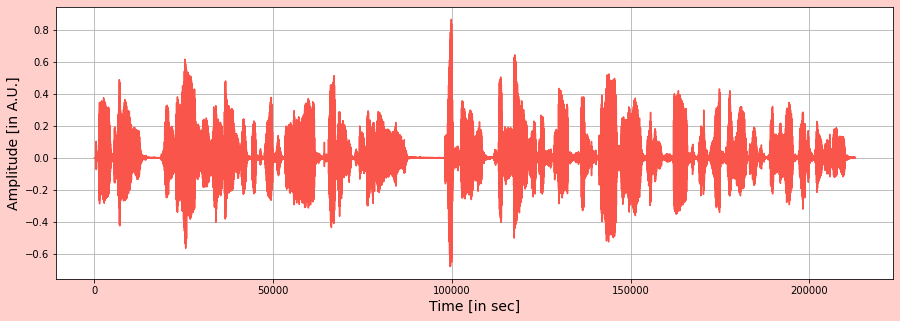

In [12]:
# 3) Visualize the waveform using matplotlib
plt.figure(figsize=(15, 5), facecolor='#ffcfcc')
plt.grid(True)
plt.ylabel('Amplitude [in A.U.]', fontsize=14)
plt.xlabel('Time [in sec]', fontsize=14)
plt.plot(waveform.t().numpy(), color='#fa554b')

> * #### <a> Create the spectrogram representation of the picked waveform and visualize it.

In [13]:
sample_rate, samples = wavfile.read(SPEECH_FILE)

> Note, that we are taking logarithm of spectrogram values. It will make our plot much more clear, moreover, it is strictly connected to the way people hear. We need to assure that there are no 0 values as input to logarithm.

In [14]:
# Define a function that calculates spectrogram.
def log_specgram(audio, sample_rate, window_size=20, step_size=10, eps=1e-10):
    nperseg = int(round(window_size * sample_rate / 1e3))
    noverlap = int(round(step_size * sample_rate / 1e3))
    freqs, times, spec = signal.spectrogram(audio, fs=sample_rate, window='hann', nperseg=nperseg, noverlap=noverlap, detrend=False)
    
    return freqs, times, np.log(spec.T.astype(np.float32) + eps)

In [15]:
freqs, times, spectrogram = log_specgram(samples, sample_rate)

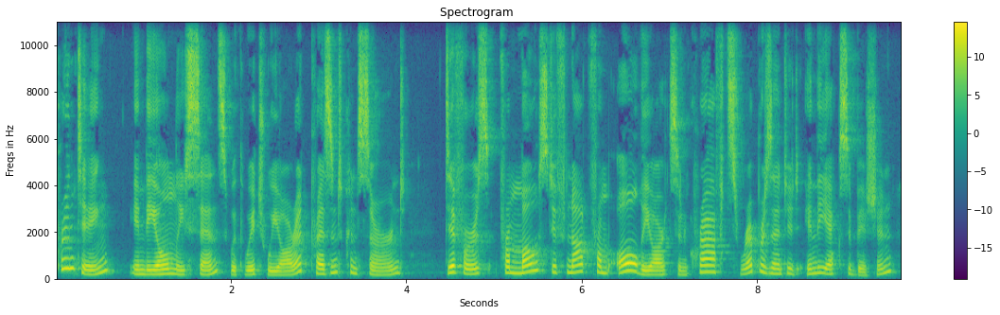

In [16]:
plt.figure(figsize=(20, 5))
plt.imshow(spectrogram.T, aspect='auto', origin='lower', extent=[times.min(), times.max(), freqs.min(), freqs.max()])
plt.title('Spectrogram ' )
plt.ylabel('Freqs in Hz')
plt.xlabel('Seconds')
plt.colorbar()
plt.show()

> If we use spectrogram as an input features for NN, we have to remember to normalize features. (We need to normalize over all the dataset, here's example just for one, which doesn't give good mean and std!)

In [17]:
mean = np.mean(spectrogram, axis=0)
std = np.std(spectrogram, axis=0)
spectrogram = (spectrogram - mean) / std

In [18]:
print('mean : ',mean[:10])
print('\nstd : ', std[:10])
print('\nspectrogram : ', spectrogram[:10])

mean :  [-3.5020978 -0.7884814  1.1595532  3.4502344  5.0942445  5.520029
  5.594339   5.4349685  5.0604873  4.980288 ]

std :  [2.681499  2.0162022 2.869157  3.9093058 3.959633  3.6073787 3.833889
 4.279295  4.2666125 4.1465077]

spectrogram :  [[-1.3610649  -1.9060111  -1.345719   ... -0.79206884 -1.1942521
  -1.3109246 ]
 [-1.5770437  -2.2424123  -0.638755   ...  0.5073977   0.43004405
   0.01547101]
 [-0.57392055  0.2529539  -0.13300963 ... -0.5211916   0.34939465
  -0.01579157]
 ...
 [-0.31055927  0.01672165  0.05308271 ...  0.1969237   0.31203955
  -0.08600408]
 [ 0.37440088  0.6197772  -0.07112705 ...  0.3786465   0.3304123
  -0.00535284]
 [-0.34898597 -0.359484   -0.48187637 ...  1.0295943   0.98388004
   0.8392166 ]]


> * #### <a> Create the MFCC representation of the picked waveform and visualize it.

> If you want to get to know some details about MFCC take a look at this great tutorial. MFCC explained You can see, that it is well prepared to imitate human hearing properties.



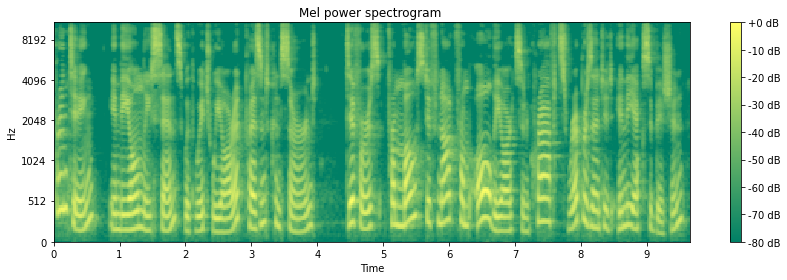

In [19]:
samples, sample_rate = librosa.load(SPEECH_FILE)
S = librosa.feature.melspectrogram(samples, sr=sample_rate, n_mels=128)

# Convert to log scale (dB). We'll use the peak power (max) as reference.
log_S = librosa.power_to_db(S, ref=np.max)

plt.figure(figsize=(12, 4))
librosa.display.specshow(log_S, sr=sample_rate, x_axis='time', y_axis='mel',cmap = 'summer')
plt.title('Mel power spectrogram ')
plt.colorbar(format='%+02.0f dB')
plt.tight_layout()

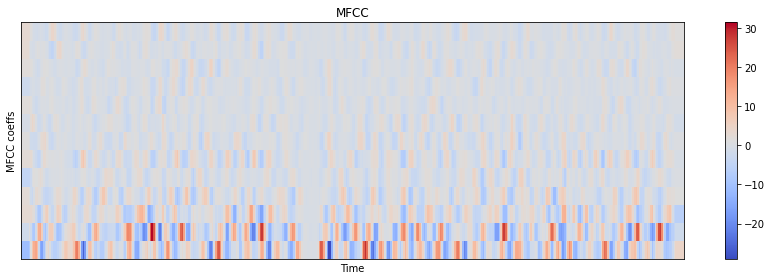

In [20]:
mfcc = librosa.feature.mfcc(S=log_S, n_mfcc=13)

# Let's pad on the first and second deltas while we're at it
delta2_mfcc = librosa.feature.delta(mfcc, order=2)

plt.figure(figsize=(12, 4))
librosa.display.specshow(delta2_mfcc)
plt.ylabel('MFCC coeffs')
plt.xlabel('Time')
plt.title('MFCC')
plt.colorbar()
plt.tight_layout()

> In classical, but still state-of-the-art systems, MFCC or similar features are taken as the input to the system instead of spectrograms.

> However, in end-to-end systems, the most common input features are probably raw spectrograms, or mel power spectrograms. For example MFCC decorrelates features, but NNs deal with correlated features well. 

> ## <a> Task 2: Creating a `Wav2Vec2` model that can perform feature extraction and classification.


> ### <a> Wav2Vec 2.0 Model Architecture

> The architecture of the final model used for prediction consists of three main parts:

> *  convolutional layers that process the raw waveform input to get latent representation - Z,
> * transformer layers, creating contextualised representation - C,
> * linear projection to output - Y.

> ![](https://miro.medium.com/max/1400/1*ZM1_82T5btyH7pzDPkBjjw.png)

> This Figure, Fine-tuned Wav2Vec 2.0 model architecture (Image by author, based on wav2vec 2.0: A Framework for Self-Supervised Learning of Speech Representations)

> That is what the model looks like after final fine-tuning, ready to be developed in a production environment. The whole magic happens during the first phase of training, in the self-supervised mode, when the model looks a little different. The model is trained without the linear projection generating an output prediction.


> #### <a> Contrastive learning:

> Contrastive learning is a concept in which the input is transformed in two different ways. Afterwards, the model is trained to recognise whether two transformations of the input are still the same object. In `Wav2Vec 2.0`, the transformer layers are the first way of transformation, the second one is made by quantization, which will be explained in the further part of this article. More formally, for a masked latent representation zₜ, we would like to get such a context representation cₜ to be able to guess the correct quantized representation qₜ among other quantized representations. 

> ![](https://miro.medium.com/max/1400/1*P38rp1OvC5evoiNuceHS6g.png)


> This Figure, `Wav2Vec 2.0` model architecture for self-supervised training (Image by author, based on wav2vec 2.0: A Framework for Self-Supervised Learning of Speech Representations)

> [Source](https://towardsdatascience.com/wav2vec-2-0-a-framework-for-self-supervised-learning-of-speech-representations-7d3728688cae)

In [21]:
# TODO code for task 2
Audio(SPEECH_FILE, autoplay=False)

> #### <a> Creating a pipeline

> First, we will create a `Wav2Vec2` model that performs the feature extraction and the classification.

> There are two types of `Wav2Vec2` pre-trained weights available in torchaudio. The ones fine-tuned for `ASR` task, and the ones not fine-tuned.

> `Wav2Vec2 (and HuBERT)` models are trained in self-supervised manner. They are firstly trained with audio only for representation learning, then fine-tuned for a specific task with additional labels.

> We will use `torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H()` here.

In [22]:
# Build the model and load pretrained weights 
bundle = torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H

print("Sample Rate:", bundle.sample_rate)

Sample Rate: 16000


In [23]:
# Model can be constructed as following. 
# This process will automatically fetch the pre-trained weights and load it into the model.
model = bundle.get_model()
# print('\nModel Architecture')
# print(model)

labels = bundle.get_labels()
print('\nlabels: ', labels)

Downloading: "https://download.pytorch.org/torchaudio/models/wav2vec2_fairseq_base_ls960_asr_ls960.pth" to /root/.cache/torch/hub/checkpoints/wav2vec2_fairseq_base_ls960_asr_ls960.pth


  0%|          | 0.00/360M [00:00<?, ?B/s]


labels:  ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


In [24]:
# Resample audio to the expected sampling rate
if sample_rate != bundle.sample_rate:
    waveform = torchaudio.functional.resample(waveform, sample_rate, bundle.sample_rate)

> ### <a> Extracting acoustic features

> The next step is to extract acoustic features from the audio.

> <div class="alert alert-info"><h4>Note: </h4><p>Wav2Vec2 models fine-tuned for ASR task can perform feature
   extraction and classification with one step, but for the sake of the
   tutorial, we also show how to perform feature extraction here.</p></div>




In [25]:
with torch.inference_mode():
    features, _ = model.extract_features(waveform)

> The returned features is a list of tensors. Each tensor is the output of
a transformer layer.




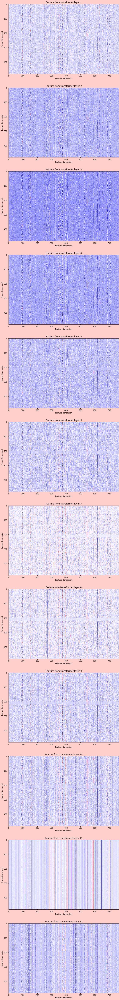

In [26]:
# plot
fig, ax = plt.subplots(len(features), 1, figsize=(25, 8.3 * len(features)), facecolor='#ffcfcc')
for i, feats in enumerate(features):
    ax[i].grid(False)
    ax[i].imshow(feats[0].cpu(), cmap = 'seismic')
    ax[i].set_title(f"Feature from transformer layer {i+1}")
    ax[i].set_xlabel("Feature dimension")
    ax[i].set_ylabel("Frame (time-axis)")

> ### <a> Feature classification

> Once the acoustic features are extracted, the next step is to classify
them into a set of categories.

> Wav2Vec2 model provides method to perform the feature extraction and
classification in one step.




In [27]:
# Infer the label probability distribution
with torch.inference_mode():
    emissions, _ = model(waveform)
print('\nemissions ', emissions)


emissions  tensor([[[ 14.9316,   1.2051,   0.3590,  ...,  -8.9404,  -6.4388, -13.4237],
         [  3.4015,  -0.8861,   0.9520,  ...,  -6.8746,  -2.5634, -10.5984],
         [ 10.5939,  -1.3360,  -2.7532,  ...,  -9.4607, -10.2677, -10.2694],
         ...,
         [ 14.7813,  -1.3944,  -3.2578,  ...,  -6.7257,  -7.6747,  -9.2240],
         [ 14.7899,  -1.3682,  -3.2692,  ...,  -6.7286,  -7.6794,  -9.2264],
         [ 14.7048,  -0.5374,  -1.8725,  ...,  -7.6599,  -8.4477,  -8.7742]]])


In [28]:
def wav2Vec2_method(SPEECH_FILE_=SPEECH_FILE):
  waveform, sample_rate = torchaudio.load(SPEECH_FILE_)
  # Resample audio to the expected sampling rate
  if sample_rate != bundle.sample_rate:
      waveform = torchaudio.functional.resample(waveform, sample_rate, bundle.sample_rate)

  # Infer the label probability distribution
  with torch.inference_mode():
    emissions, _ = model(waveform)

  # print('\nemissions ', emissions)

  plt.figure(figsize=(15, 5), facecolor='#ffcfcc')
  sns.set(palette="muted", color_codes=True)
  plt.grid(True)
  plt.ylabel('Amplitude [in A.U.] ', fontsize=14)
  plt.xlabel('Time [in sec] for ['+ SPEECH_FILE_[14:]+']', fontsize=14)
  plt.plot(waveform.t().numpy(), color='#fa554b')
  plt.show()

  return emissions

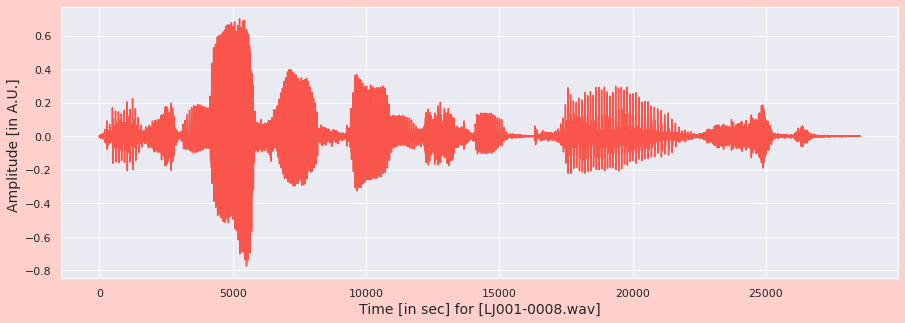

tensor([[[ 12.8178,   0.6528,  -0.1014,  ...,  -9.7091, -11.9702,  -9.5909],
         [  7.8586,  -1.6810,  -0.6130,  ...,  -5.0620,  -9.7042,  -5.0397],
         [ 15.5066,   3.3702,   2.2090,  ...,  -8.9197, -12.5757,  -8.8040],
         ...,
         [ 16.5980,   0.1475,  -3.5521,  ...,  -9.4868, -10.9996, -10.2278],
         [ 14.3846,   0.2309,  -1.5265,  ...,  -8.5338,  -9.4928,  -8.8890],
         [ 16.4570,   0.1789,  -3.4199,  ...,  -9.5049, -11.0368, -10.1238]]])


In [29]:
# to make sure that every thing is working fine.
print(wav2Vec2_method('/content/wavs/LJ001-0008.wav'))

> ## <a> Task 3: Extract acoustic features and generate predicted transcript for each waveform in the given dataset

> Getting list of files from the given Dataset

In [30]:
path = "/content/wavs"
# Getting list of file from the given path and store it in (onlyfiles) variable
onlyfiles = [f for f in listdir(path) if isfile(join(path, f))]

> we have `101` .wav files

In [31]:
print('length of the list : ' ,len(onlyfiles))

length of the list :  101


In [32]:
onlyfiles

['LJ001-0023.wav',
 'LJ001-0087.wav',
 'LJ001-0098.wav',
 'LJ001-0095.wav',
 'LJ001-0021.wav',
 'LJ001-0099.wav',
 'LJ001-0048.wav',
 'LJ001-0014.wav',
 'LJ001-0063.wav',
 'LJ001-0061.wav',
 'LJ001-0088.wav',
 'LJ001-0094.wav',
 'LJ001-0080.wav',
 'LJ001-0003.wav',
 'LJ001-0028.wav',
 'LJ001-0020.wav',
 'LJ001-0062.wav',
 'LJ001-0091.wav',
 'LJ001-0032.wav',
 'LJ001-0036.wav',
 'LJ001-0096.wav',
 'LJ001-0073.wav',
 'LJ001-0037.wav',
 'LJ001-0019.wav',
 'LJ001-0092.wav',
 'LJ001-0046.wav',
 'LJ001-0018.wav',
 'LJ001-0006.wav',
 'LJ001-0071.wav',
 'LJ001-0047.wav',
 'LJ001-0057.wav',
 'LJ001-0017.wav',
 'LJ001-0056.wav',
 'LJ001-0066.wav',
 'LJ001-0011.wav',
 'LJ001-0044.wav',
 'LJ001-0074.wav',
 'LJ001-0016.wav',
 'LJ001-0090.wav',
 'LJ001-0076.wav',
 'LJ001-0004.wav',
 'LJ001-0033.wav',
 'LJ001-0005.wav',
 'LJ001-0024.wav',
 'LJ001-0013.wav',
 'LJ001-0001.wav',
 'LJ001-0049.wav',
 'LJ001-0002.wav',
 'LJ001-0010.wav',
 'LJ001-0084.wav',
 'LJ001-0100.wav',
 'LJ001-0075.wav',
 'LJ001-0089

> Note : we need to deal with waves files formate only so we will drop any file with different format.

In [33]:
# dealing with waves files fomate only.
i = 0
for f in onlyfiles:
    if f == '.DS_Store':
      print('File_name : ', f)
      print('The index : ', i)
    i += 1


File_name :  .DS_Store
The index :  56


> To delete `.DS_Store` we will use `del` function to delete it.

In [34]:
print('Index 56 before deletion : ', onlyfiles[56])
del onlyfiles[56]
print('Index 56 after deletio ', onlyfiles[56])

Index 56 before deletion :  .DS_Store
Index 56 after deletio  LJ001-0031.wav


In [35]:
# to make sure eavry thing is okay
print('length of the list : ' ,len(onlyfiles))

length of the list :  100


> ### <a> Generating transcripts

> From the sequence of label probabilities, now we want to generate
transcripts. The process to generate hypotheses is often called
“decoding”.

> Decoding is more elaborate than simple classification because
decoding at certain time step can be affected by surrounding
observations.

> For example, take a word like ``night`` and ``knight``. Even if their
prior probability distribution are differnt (in typical conversations,
``night`` would occur way more often than ``knight``), to accurately
generate transcripts with ``knight``, such as ``a knight with a sword``,
the decoding process has to postpone the final decision until it sees
enough context.

> There are many decoding techniques proposed, and they require external
resources, such as word dictionary and language models.

> In this tutorial, for the sake of simplicity, we will perform greedy
decoding which does not depend on such external components, and simply
pick up the best hypothesis at each time step. Therefore, the context
information are not used, and only one transcript can be generated.

> We start by defining greedy decoding algorithm.




In [36]:
# TODO code for task 3

# Generating transcripts
class GreedyCTCDecoder(torch.nn.Module):
    def __init__(self, labels, blank=0):
        super().__init__()
        self.labels = labels
        self.blank = blank

    def forward(self, emission: torch.Tensor) -> str:
        """Given a sequence emission over labels, get the best path string
        Args:
          emission (Tensor): Logit tensors. Shape `[num_seq, num_label]`.

        Returns:
          str: The resulting transcript
        """
        indices = torch.argmax(emission, dim=-1)  # [num_seq,]  
        print('Predict a sequence of tokens', indices)
        indices = torch.unique_consecutive(indices, dim=-1) 
        print('\nMerge repeats ', indices)
        # Final output after dropping blank (-)
        indices = [i for i in indices if i != self.blank]
        print('\nlabels', [self.labels[i] for i in indices]) 
        return "".join([self.labels[i] for i in indices])

> Now create the decoder object and decode the transcript will be in the `decoding_method`.




In [37]:
decoder = GreedyCTCDecoder(labels=bundle.get_labels())

> create dataframe to save the `Transcript` into it for evaluation.

In [38]:
#create a data frame
df = pd.DataFrame()
#create a list for all prediction transcripts
result_ts = []
#create a list for audio names
result_file_name = []

In [39]:
def decoding_method(SPEECH_FILE_=SPEECH_FILE):
  var = wav2Vec2_method(SPEECH_FILE_)[0]

  print('\n_________________________________________________________________________________________________________\n')
  # The output is in the form of logits. It is not in the form of probability.
  # Let’s visualize this.
  
  plt.figure(figsize=(16, 6), facecolor='#ffcfcc')
  plt.imshow(var.cpu().T)
  plt.title("Classification result for ["+SPEECH_FILE_[14:]+']')
  plt.xlabel("Frame (time-axis)")
  plt.ylabel("Class")
  plt.show()
  print("Class labels:", bundle.get_labels())

  transcript = decoder(var)
  # print(type(transcript))
  result_file_name.append(SPEECH_FILE_[14:])
  result_ts.append(transcript)
  # print(Audio(SPEECH_FILE_, autoplay=False))
  print('\nTranscript for ['+SPEECH_FILE_[14:]+']:', transcript)


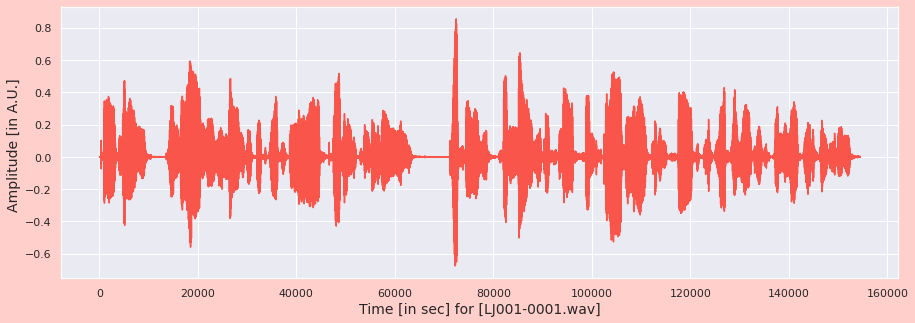


_________________________________________________________________________________________________________



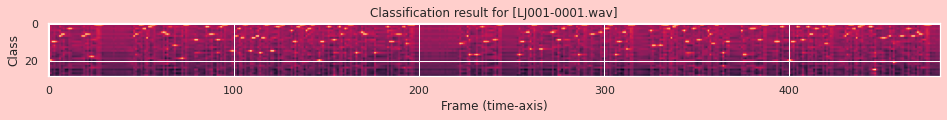

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0, 20, 10, 10,  0,  0,  7,  6,  6,  0,  0,  3,  3,  0,  0,  0,  0,  0,
         7,  7,  6,  6,  0, 18,  0,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  6,  0,  1,  1,  3,  3,  8,
         2,  2,  1,  1,  0,  0,  0,  0,  5,  0,  6,  0,  0,  0, 12,  0,  0,  0,
        19,  1,  1,  1,  0,  0,  0,  9,  9,  0,  0,  0,  0,  2,  2,  6,  6,  0,
         0,  9,  9,  2,  1,  1,  1,  0,  0, 15,  0,  7,  0,  3,  8,  8,  1,  0,
         0, 15,  8,  8,  7,  7, 16,  8,  8,  1,  1,  0, 15, 15,  0,  0,  2,  0,
         1,  1,  0,  0,  0,  4,  0, 10,  0,  2,  1,  1,  0,  4,  3,  3,  1,  1,
         0,  0, 20, 10, 10,  0,  0,  2,  0,  0,  9,  0,  0,  2,  6,  0,  3,  0,
         1,  1,  0,  0, 16,  0,  0,  5,  6,  6,  0,  0,  0,  0, 16,  0,  0,  0,
         0,

In [40]:
decoding_method()
df['transcript'] = result_ts
df['file_name'] = result_file_name

> ### **Notes on the classification results :** we can see that there are strong indications to certain labels across the time line.

In [41]:
df

,transcript,file_name
0,PRINTING|IN|THE|ONLY|SENSE|WITH|WHICH|WE|ARE|A...,LJ001-0001.wav


In [42]:
df = pd.DataFrame()
result_ts = []
result_file_name = []

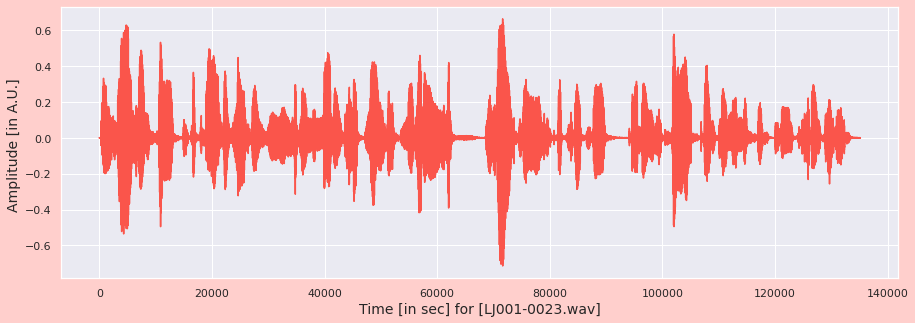


_________________________________________________________________________________________________________



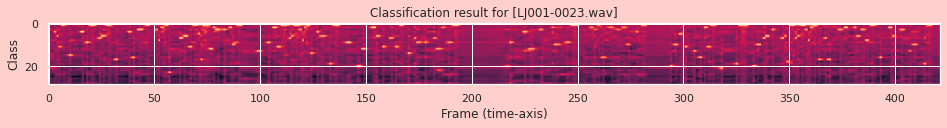

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  4,  6, 11,  0,  1,  0,  0, 15,  0,  0,  0,  0,  0,  4,  0,
         9,  0,  1,  1,  0,  0,  7,  6,  6,  0,  1,  1,  0,  0, 17,  0,  0,  0,
         0,  0,  4,  0, 16,  0,  3,  3,  3,  0,  1,  1,  0,  0,  0,  3,  8,  0,
         2,  1,  1, 23,  0,  0,  0,  0,  7,  0,  6,  6,  0, 11,  0,  1,  1,  5,
        17,  1,  1,  1, 12, 12,  2,  3,  3,  0,  0,  3,  0,  0,  2, 10,  0,  1,
         1,  1,  0,  0,  0,  0,  0,  0,  0, 13, 13,  0,  0,  0,  9,  0,  2,  2,
        11, 11,  1,  1,  1,  0,  7,  6,  1,  1,  1,  3,  8,  2,  1,  1, 14,  0,
         0,  4,  0,  6,  6,  0,  0, 19,  0,  1,  1,  0,  0,  0,  0,  9,  9,  0,
         0,  0, 20, 20, 12, 12,  0,  0,  0,  2,  2,  6,  6,  0, 11,  0,  0,  0,
         7,  0, 11,  0,  1,  1,  0,  0, 14,  0,  0,  7,  9,  9,  0,  0,  9,  0,
         0,

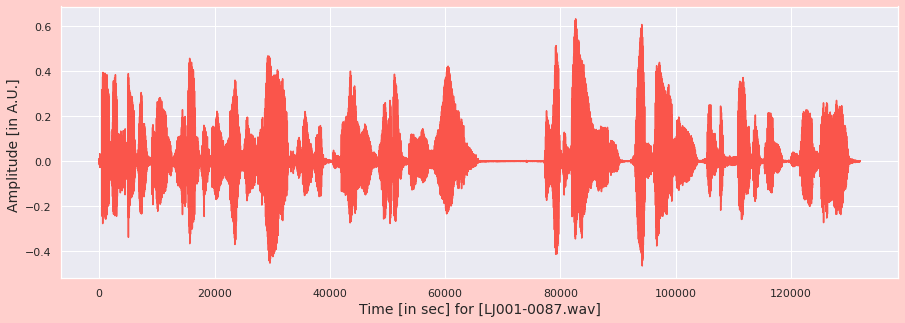


_________________________________________________________________________________________________________



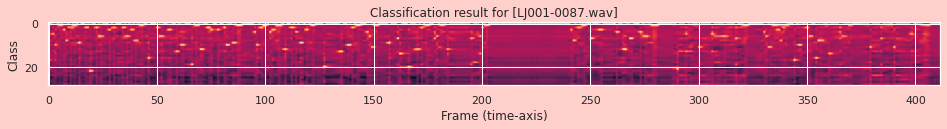

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([17,  0,  5, 10,  0,  1,  1,  3,  8,  0,  2,  1,  1,  0,  9,  0,  0,  2,
         2, 22, 22,  0,  2,  6,  6,  0,  0,  0,  3,  0,  2,  0,  0,  0,  2,  2,
         6,  0,  3,  0,  8,  0,  1,  1,  0,  0, 16,  0,  0,  0,  2,  6,  6,  0,
         0,  3,  3,  0,  0, 13,  0, 10, 10,  0,  0,  0, 19,  0,  1,  1, 12, 12,
         0,  2,  2,  3,  0,  0,  3,  0,  0,  2, 10, 10,  0,  9,  9,  1,  1,  1,
         0,  0,  0,  0,  0,  4, 10,  0,  2,  1,  1,  0,  4,  3,  3,  1,  1,  1,
         0, 12,  0,  0,  2,  0,  4,  0,  9,  9,  0,  3,  0,  1,  1,  0,  0,  0,
         0, 20,  0,  0,  0,  0,  0,  0, 13, 13,  0,  0, 10, 10,  2,  0,  1,  1,
         0,  0,  0,  4,  6, 11,  1,  1,  1,  0,  0,  0,  0,  9,  0,  0,  0,  7,
        14,  0,  0,  0, 20,  0,  0,  0, 12,  0,  2,  0,  1,  1,  0,  0,  7,  6,
         0,

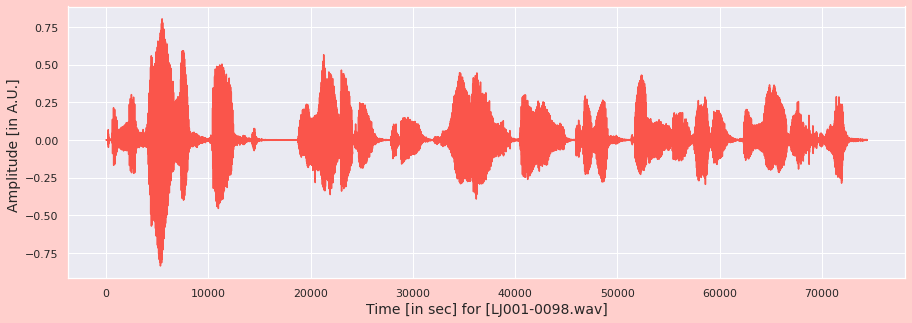


_________________________________________________________________________________________________________



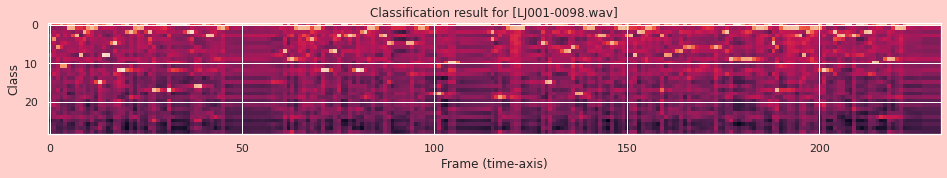

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  4,  6,  0, 11,  1,  1,  3,  8,  2,  1,  1,  0, 15,  8,  8,  0,  5,
        12, 12,  0,  2,  0,  1,  1,  0,  2, 17,  0,  0,  0, 17,  0,  0,  0,  0,
         2,  2, 16, 16,  0,  3,  3,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  7,  0,  9,  0,  1,  1,  1,  4,  1,  1, 12,
        12,  0,  7,  3,  0,  0,  3,  0, 12, 12,  2,  1,  1,  0,  0,  3,  5,  0,
         0,  0,  0,  5,  5,  0,  1,  1,  0,  0,  0, 18,  0,  0, 10, 10,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  2,  0, 19,  0,  0,  1,  1,  1,  1,  0,  0,
         0,  0,  5,  0, 15,  0,  0,  0,  7,  7,  6,  0, 18,  0,  1,  1,  0,  3,
         3,  0,  5,  0,  1,  1,  1,  3,  8,  2,  2,  1,  1,  0,  0,  3,  8,  8,
         0,  0,  7,  0,  6,  0,  0,  0,  0,  0,  0,  6,  0,  0,  2,  9,  0,  0,
         9,

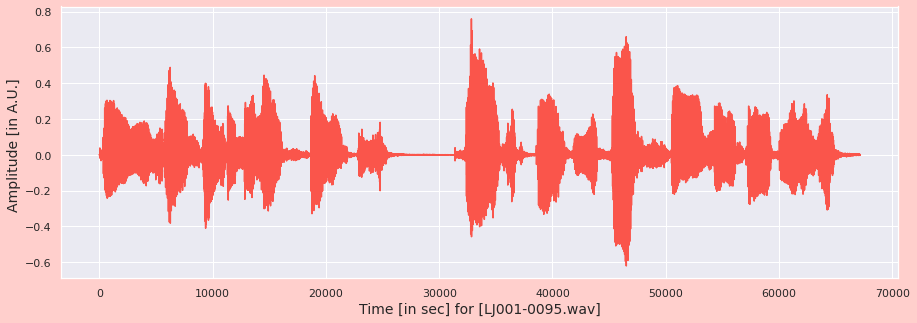


_________________________________________________________________________________________________________



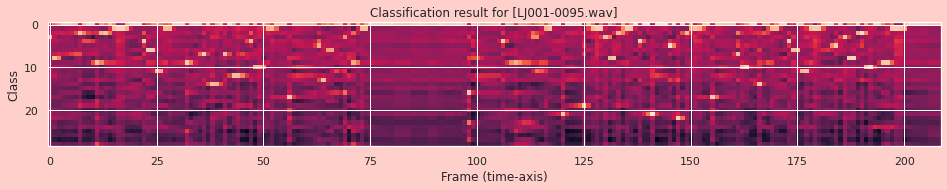

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  0,  0,  0,  0,  0,  2,  0,  0,  0,  9,  2,  2,  0,  1,  1,  1,
         1,  0,  0,  0,  4,  6,  6, 11, 11,  1,  1,  0,  0,  0,  9,  0,  0,  0,
         7,  0, 14, 14,  0,  7,  0, 12, 12,  0,  0,  4,  0, 10,  0,  1,  1,  0,
         0,  0, 17,  0,  0,  0,  0,  0,  0,  5, 13,  6,  6,  0,  0,  3,  0,  9,
         0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0, 16,  0,  0,  0,  0,  0,  0,  0,  4,  0,
         0,  9,  0,  0,  0,  3,  3,  0,  1,  1,  0,  0, 21,  0,  0,  0,  0, 19,
         0,  1,  1,  1,  3,  8,  8,  2,  0,  1,  1,  0,  4,  0,  0, 21,  0,  0,
         0,  5,  0, 22,  0,  2,  0,  1,  1,  0,  0, 17,  0,  0,  0,  0,  0,  7,
        10, 10,  0,  0, 14,  0,  0,  1,  1,  0,  0,  4,  6,  0,  0, 11,  1,  1,
         1,

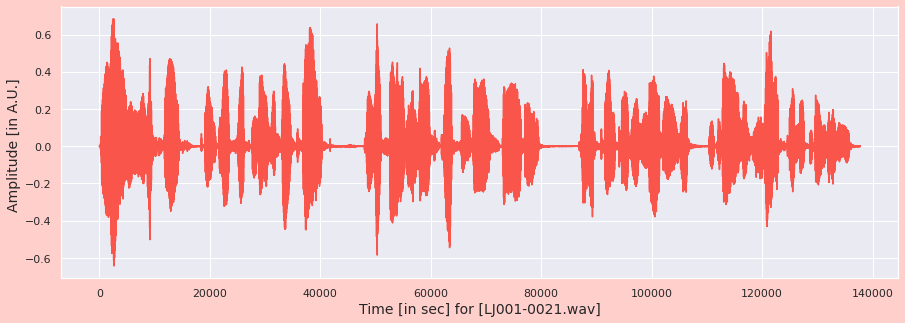


_________________________________________________________________________________________________________



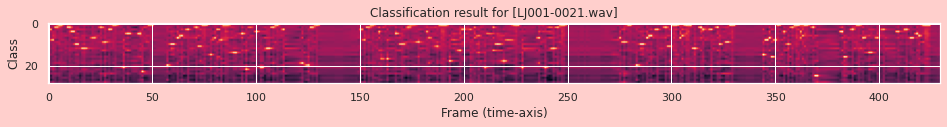

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  0,  8,  2,  2,  1,  1,  0,  0,  2,  2,  4,  4, 10, 10,  0, 12, 12,
         0,  0,  0,  7,  7,  0,  0,  2,  0,  9,  0,  3,  3,  1,  1,  0,  0,  0,
        21,  0,  5,  5,  0,  0,  0,  5,  5, 23,  0,  0,  1,  1,  0,  0,  0,  0,
         0,  0,  0, 20,  0, 10, 10,  0,  7,  6,  6,  0,  0,  3,  0,  0,  0,  2,
        11, 11,  1,  1,  1,  0, 15,  0,  7,  3,  0,  8,  1,  1,  1,  0,  0, 14,
        14,  0,  0,  5,  0, 22,  0,  0,  0,  0,  4,  0, 21, 21,  0, 12, 12,  0,
         2,  1,  1,  0,  0,  3,  0,  0,  0,  0,  0,  0,  0,  0, 19,  0,  0, 20,
         2,  2,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  3,  0,  8,  2,  2,  1,  1,  0,  0,  4, 17,  0,
         0, 17,  0,  0,  0,  5,  0, 10, 10, 10,  0,  2,  0,  0,  0,  0,  9,  0,
         0,

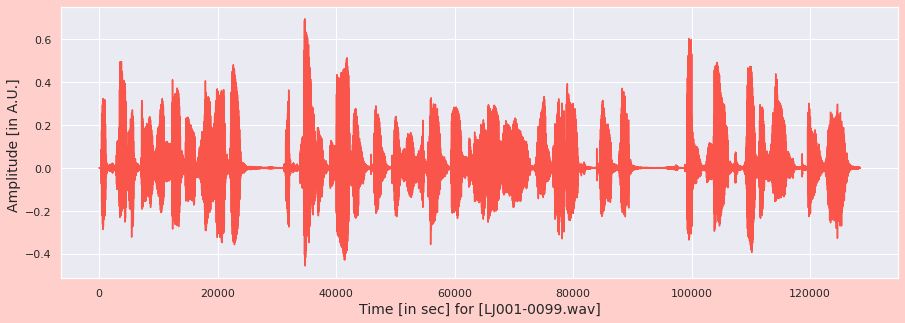


_________________________________________________________________________________________________________



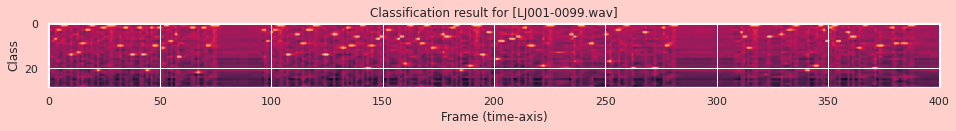

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  7,  3,  0,  1,  1,  0,  0, 14,  0,  0, 13,  0,  9,  0,  3,
         3,  1,  1,  0, 21,  0,  2,  2,  0,  1,  1,  1,  0,  0, 10,  0,  2,  2,
         0, 14, 14,  0,  0,  2, 14, 14, 21,  0,  2, 10, 10,  0,  2, 11,  1,  1,
         0,  8,  0,  5, 15, 15,  0,  0,  0,  0,  2,  2,  0, 22,  0,  2,  2, 10,
        10,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  3,  8,  0,  4,  3,  3,  1,  1,  1,  0, 14,
        14,  0,  0,  5,  5,  0,  9,  0,  3,  3,  3,  1,  1,  1,  0,  0, 14, 14,
         0,  0,  5,  0,  0,  0, 11,  0,  2, 10, 10,  0,  6,  6,  0,  1,  0, 20,
         0, 10,  0,  0,  7,  6,  0,  0,  3,  3,  0,  0,  0,  7,  6,  6, 18,  0,
         1,  1,  0,  0,  7,  9,  9,  1,  1,  0, 11,  0,  0,  0,  0,  5,  6,  6,
         0,

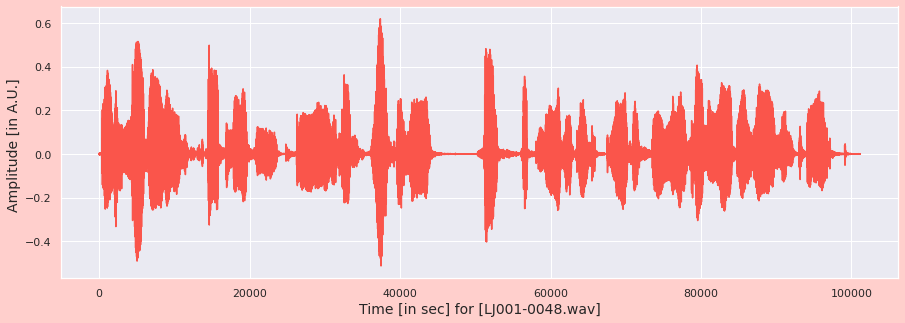


_________________________________________________________________________________________________________



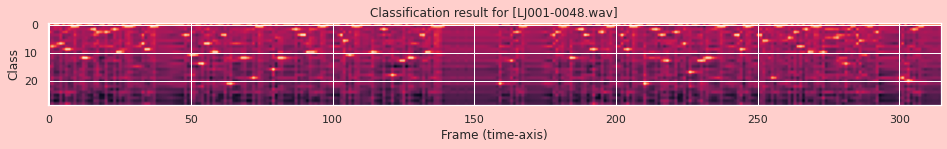

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  8,  0,  0,  7,  0,  9,  9,  1,  1,  0,  0, 12, 12,  0,  0,  2,  3,
         0,  0,  3,  0,  0,  2, 10, 10,  0,  1,  1,  1,  0,  0,  0,  7,  9,  9,
         1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,  0, 11, 11,  0, 14,
        14,  7,  7,  0, 10, 10,  0,  0,  4, 21, 21,  0,  0,  0, 12, 12,  0,  0,
        19,  1,  1,  1,  0,  0,  0, 16,  0, 12, 12,  0,  0,  0,  0,  2,  0,  4,
         4, 10, 10, 10,  0,  0,  1,  1,  0,  0,  0,  0,  0,  4,  6,  0, 11,  0,
         1,  1,  0,  0,  0,  0, 10,  0,  0,  0,  2,  0,  0, 18,  0,  0, 13, 13,
         0, 12, 12,  0,  0,  0,  4, 10, 10,  0,  1,  1,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 21,  0,  0,
         0, 13,  0,  3,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,  3,
         0,

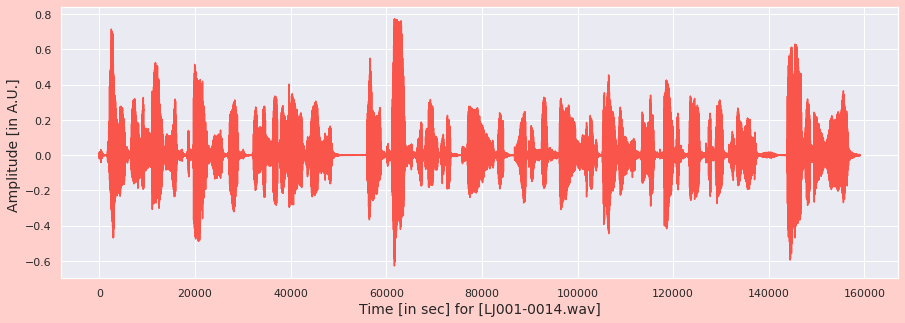


_________________________________________________________________________________________________________



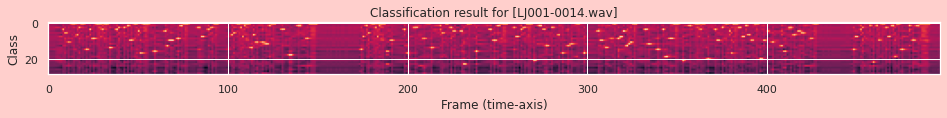

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  0,  0,  4,  6,  0, 11,  0,  1,  1,  0,  7,  3,
         1,  1,  0, 15,  0,  4,  0,  9,  0,  1,  1,  1,  4,  1,  1,  0, 14,  0,
         0,  0,  4,  3,  0,  0,  3,  0,  2,  0, 10,  0,  1,  1,  5, 17, 17,  1,
         1,  1,  0,  0,  0, 16,  0,  0,  0,  0,  0,  5, 13, 10, 10, 10,  0,  0,
         9,  2,  2,  1,  1,  1,  0,  0,  0,  0,  0,  3,  3,  8,  8,  0,  0,  4,
         0,  3,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  7,  6,  0,  1,  1,  3,
         8,  2,  1,  1, 14, 14,  7, 11, 11,  0,  0, 11,  0, 12, 12,  2,  0,  1,
         1,  0,  0,  0,  4,  4,  0,  0, 18, 18,  0,  0,  0,  2,  2,  0,  0,  0,
         9,  1,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 15,  8,  0,  2,  6,  0,
         1,

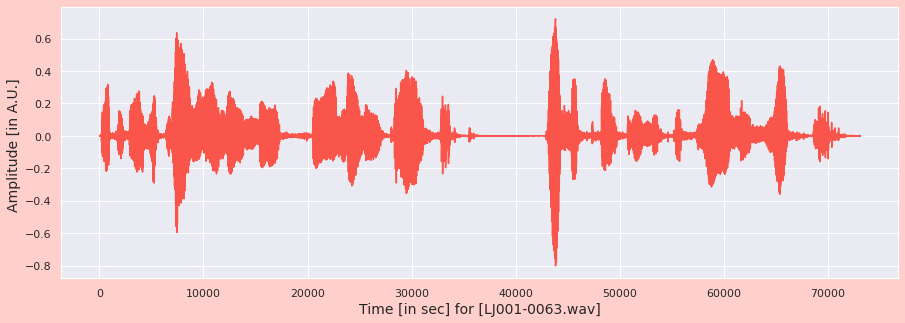


_________________________________________________________________________________________________________



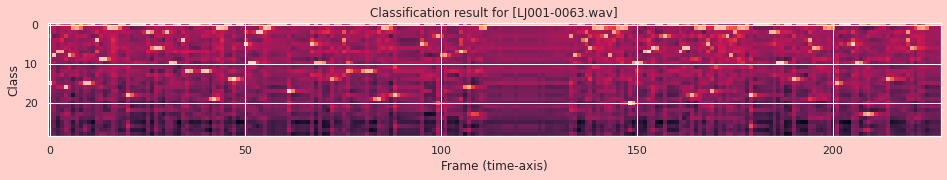

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([15,  8,  7,  7, 16,  8,  0,  1,  0, 15, 15,  0,  4,  9,  9,  1,  1,  1,
         0,  0, 18,  0,  0,  0,  0,  2,  0,  6,  6,  0,  2, 10, 10,  0,  4, 12,
         0,  0,  0, 12, 12,  0, 19,  1,  1,  0,  0, 14,  0,  0,  5, 10, 10,  2,
         2,  1,  1,  0,  0,  0,  0, 17,  0,  0,  0,  0,  0,  5,  0, 10,  0,  0,
        14,  0,  0,  4, 12,  0,  0,  0,  0, 12, 12,  0, 19,  1,  1,  0, 18,  0,
         0,  0,  0,  0,  0,  5,  0,  0,  0,  3,  0,  8,  0,  0,  0,  7,  0, 16,
         0,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  3,  8,  0,  0,  4,  6,  1,  1,  1,  3,  8,
         2,  1,  1,  1, 20, 20, 10,  0,  7,  7,  6,  0,  0,  3,  0,  0,  0,  7,
         6,  6, 18,  1,  1,  1,  5, 17,  1,  1,  1,  3,  8,  2,  1,  1,  0, 18,
         0,

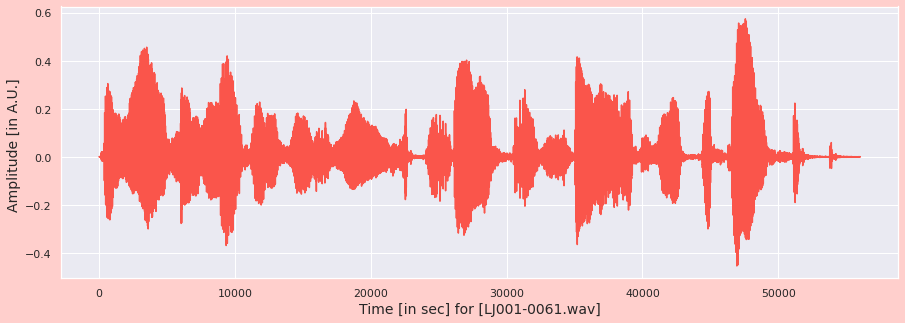


_________________________________________________________________________________________________________



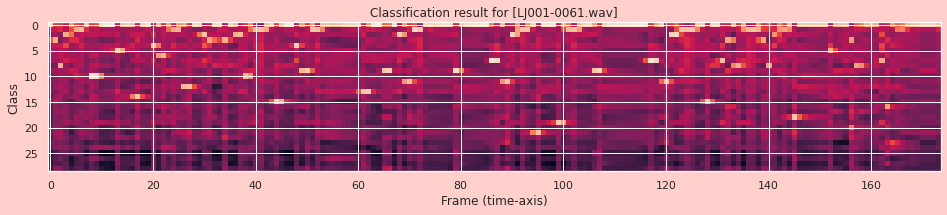

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  3,  8,  2,  0,  1,  1,  0, 10, 10,  0,  0,  0,  5,  0,  0,  0, 14,
         0,  0,  4,  0,  6,  0,  1,  1, 12, 12,  0,  0,  2,  3,  0,  0,  3,  0,
         0,  2, 10, 10,  1,  1,  0,  0, 15,  0,  0,  0,  4,  9,  9,  1,  1,  0,
         0,  0,  0,  0,  0,  0,  0, 13, 13,  0,  0,  9,  9,  0,  2,  2, 11,  1,
         1,  0,  0,  0,  0,  0,  0,  9,  0,  0,  0,  0,  0,  0,  7,  7,  0, 11,
         2,  2,  1,  1,  0, 21,  0,  0,  0, 19,  0,  1,  1,  0,  0,  0,  9,  9,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  7,  0, 11,  2,  2,  1,  1,  1,
         0,  0, 15,  0,  0,  7,  3,  0,  8,  0,  1,  1,  1,  3,  8,  2,  1,  1,
         0, 18,  0,  0,  0,  0,  0,  0,  5,  0,  0,  0,  3,  8,  8,  0,  0,  0,
         7, 16,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0])

Merge repeats  tensor([ 0,  3,  8

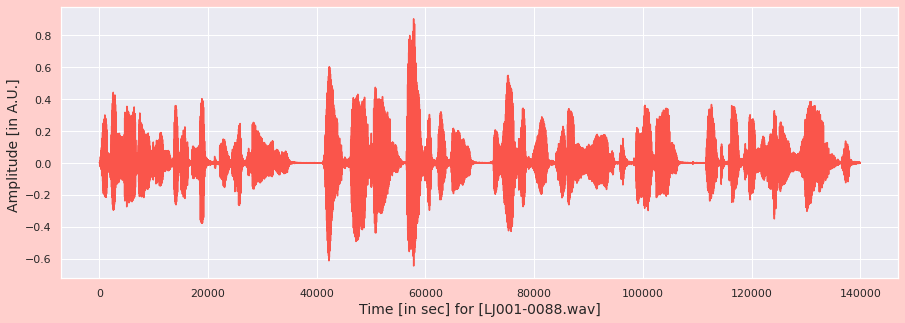


_________________________________________________________________________________________________________



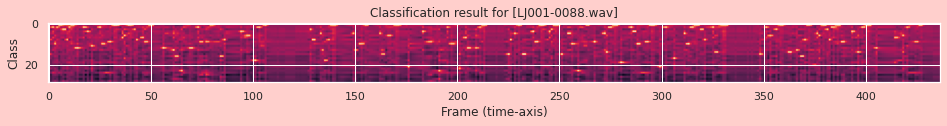

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([15,  0,  2, 10,  2,  1,  1,  3,  3,  8,  2,  1,  1, 12, 12,  0,  0,  2,
         0,  4,  0, 11,  0,  0,  0,  2, 10, 10,  0,  9,  9,  0,  1,  1,  1,  0,
         7,  6,  0,  1,  1,  0,  3,  8,  0,  0,  7,  9,  9,  1,  1,  0,  0,  0,
         0,  0, 12,  0,  0,  0,  0, 13, 16, 16,  0, 23,  0,  0,  0, 12, 12,  0,
         0,  2,  9,  9,  0,  9,  9,  1,  1,  0,  0,  0, 16, 16,  8,  0,  0,  0,
         0,  0,  0,  0,  4,  0,  0,  6,  6,  0,  0, 18,  2,  2,  0,  1,  1,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  3,  8,  8,  0,  0,  5, 13, 18, 18,  8,  1,  1,  1,  0,  0,  0,
         0,  0,  0,  0,  0,  5, 13,  0, 10, 10, 10,  1,  1,  0,  0,  0,  0,  0,
         5, 15, 15,  0,  6,  6,  0,  1,  1,  1,  0,  0,  0,  0, 21,  0,  0,  0,
         0,

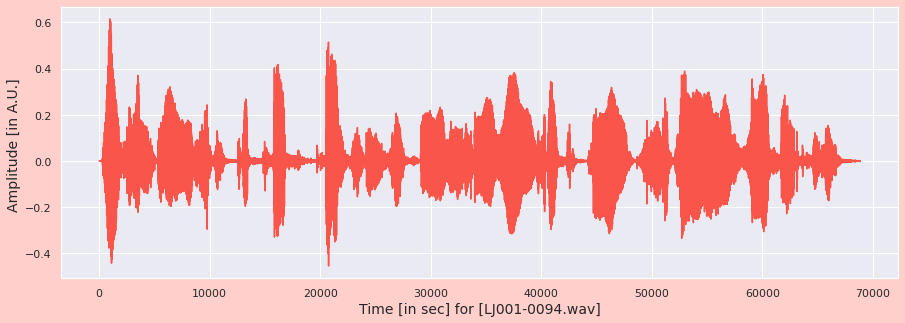


_________________________________________________________________________________________________________



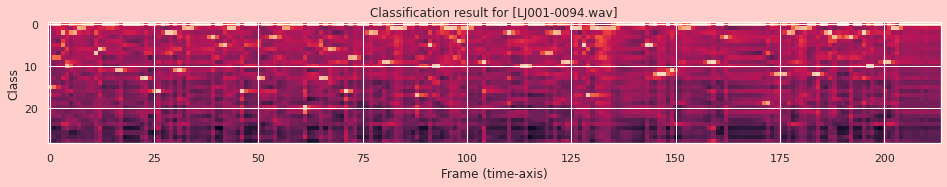

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([15,  0,  0,  2, 10,  0,  2,  1,  1,  0,  0,  7,  6,  0,  0,  0, 11, 11,
         0,  0,  0,  0, 13, 13,  0,  0, 16,  0,  2,  2,  0, 11,  0,  1,  1,  0,
         0,  0,  0,  3,  0,  0,  5,  1,  1,  0, 16,  0,  0,  0, 13,  0,  0,  0,
         3,  0,  1,  1,  0,  0,  0, 20,  0,  0,  0, 13, 13,  6,  0,  0,  0, 16,
         0,  8,  0,  0,  0,  2,  0,  0,  9,  9,  1,  1,  1,  0,  0,  0, 17,  0,
         0,  5, 10, 10,  0,  1,  1,  1,  4,  1,  1,  0,  0,  0,  9,  0,  0,  0,
         0,  0,  2,  0,  0, 10, 10,  0,  0,  0,  0,  7,  0,  2,  2,  9,  9,  1,
         1,  1,  5, 17,  1,  1,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  5,
         5,  0, 12, 12,  0, 11,  0,  0,  1,  1,  0,  0,  0,  0,  9,  9,  0,  0,
         3,  0,  0,  0,  0,  0,  0,  0,  0,  0, 19,  0, 12, 12, 12,  2,  0,  1,
         1,

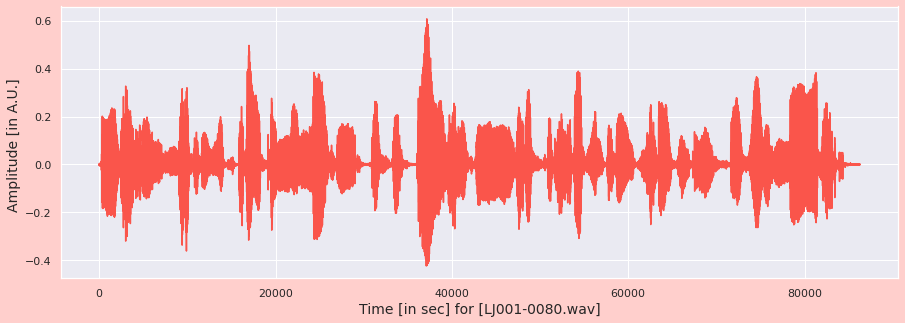


_________________________________________________________________________________________________________



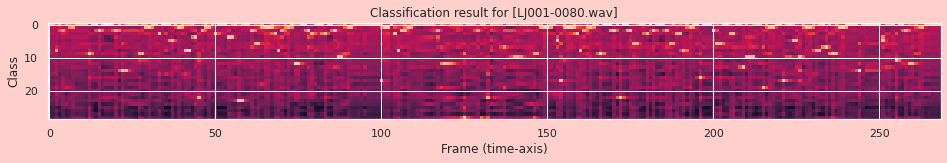

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  8,  0,  2,  0,  0,  1,  0,  0,  0,  0,  9,  0,  0,  2,  0,  0,
         0,  0,  2,  0, 14, 14,  0,  0,  0,  9,  9,  1,  1,  0,  0,  3,  0,  0,
         0,  5,  0,  1,  1,  8,  8,  0,  4, 22,  2,  0,  1,  0,  3,  0,  0,  0,
         4,  4,  0, 23, 23,  0,  0,  2,  6,  6,  1,  1,  1,  1,  3,  8,  2,  0,
         1,  0, 12, 12,  0,  0,  2,  3,  0,  0,  0,  3,  0,  0,  2, 10, 10,  0,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  0, 17,  1,  1,  0,  3,  8,  2,  2,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  2,  0, 12, 12,  0,  0,  0,  0, 28,
         0,  0,  0,  2,  0,  0, 22,  0,  0,  0,  0,  7,  0,  0, 10, 10,  0,  0,
         0,  0,  9,  9,  1,  1,  1,  0,  0,  5, 17,  1,  1,  1,  1,  3,  8,  2,
         1,  1,  0,  0,  9,  0,  0,  0,  2,  0, 22,  0,  0,  2,  6,  6,  0,  0,
         3,

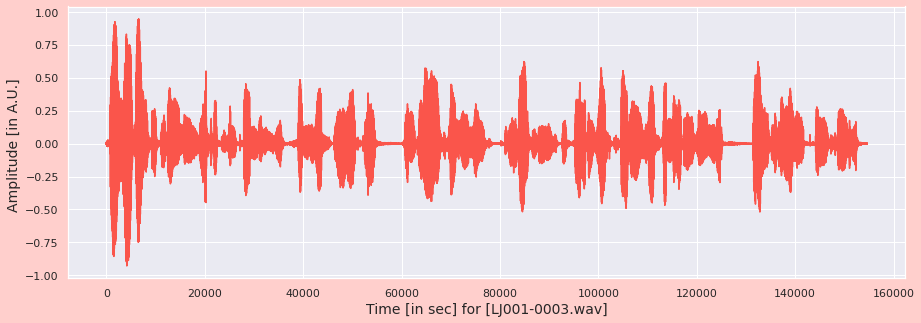


_________________________________________________________________________________________________________



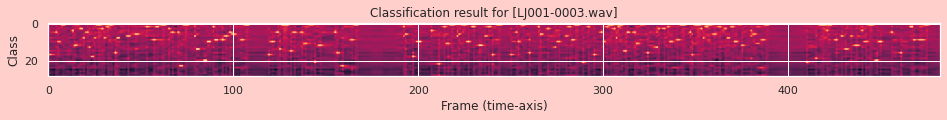

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([17, 17,  0,  0,  5, 10,  0,  1,  1,  0,  0,  0,  0,  4, 12,  0,  0,  3,
         3,  8,  0,  5, 13, 18, 18,  8,  1,  1,  1,  3,  8,  0,  2,  1,  1,  0,
        16,  8,  8,  0,  0,  0,  0,  7,  0,  0,  0,  6,  6,  0,  0,  0,  0,  2,
         0,  0,  0,  9,  2,  2,  0,  1,  1,  1,  0,  3,  0,  5,  0,  0,  5, 23,
        23,  1,  1,  1,  0,  0,  0,  7, 14, 14,  0,  0, 20, 20, 10, 10,  0,  2,
         9,  9,  0,  0,  9,  0,  7,  0,  5,  0,  6,  0,  0,  0,  9,  9,  1,  1,
         1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 17,  0, 10,  0,  0,  5, 14,
         0,  1,  1,  1,  0, 15,  0,  5,  0,  0,  0,  5, 11, 11,  0,  0,  1,  0,
        21,  0, 12, 12,  0,  0,  0,  0,  0,  0,  0,  5, 16,  0,  0, 23,  0,  0,
         0,  0,  9,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,

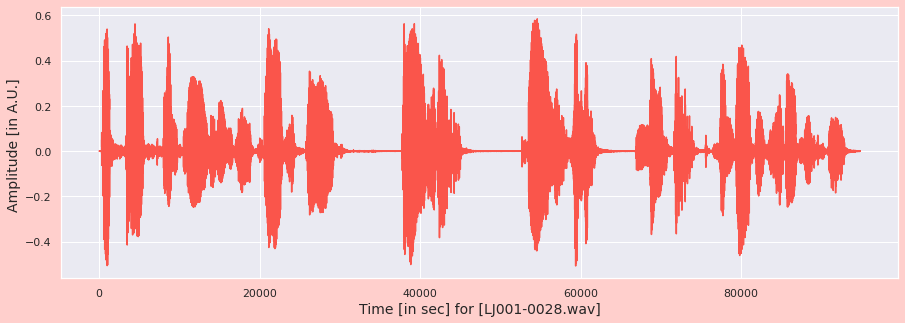


_________________________________________________________________________________________________________



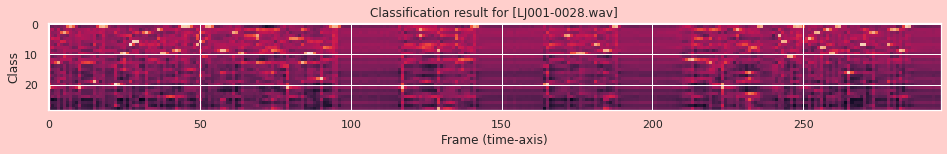

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([21,  0,  0, 13,  0,  3,  0,  1,  0,  0, 21,  0,  0,  0,  0, 19,  0,  1,
         1,  0,  0,  0, 20,  0, 10, 10,  0,  7,  6,  6,  0,  0,  3,  0,  0,  0,
         2, 10, 10,  0,  0,  0,  9,  0,  1,  1,  1,  0,  0,  7,  6,  0,  1,  1,
         0,  0,  0,  9,  9,  0,  0,  3,  0,  0, 10,  0,  0,  0,  0,  4,  0,  0,
         0,  0,  9,  0,  0,  0,  0, 21,  0,  0,  0,  0, 13,  0, 10, 10,  0,  0,
        18,  0,  0,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0, 21,  0,  0,  0,  0,  0,  2,  0,  0,
         0,  0,  0,  9,  0,  0,  0,  0,  0,  2,  0, 12,  0,  0,  0,  1,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0, 20,  0,  0,  0,  0,  0,  0,  4,  0,  0, 10, 10, 10,  0,  0,
         0,

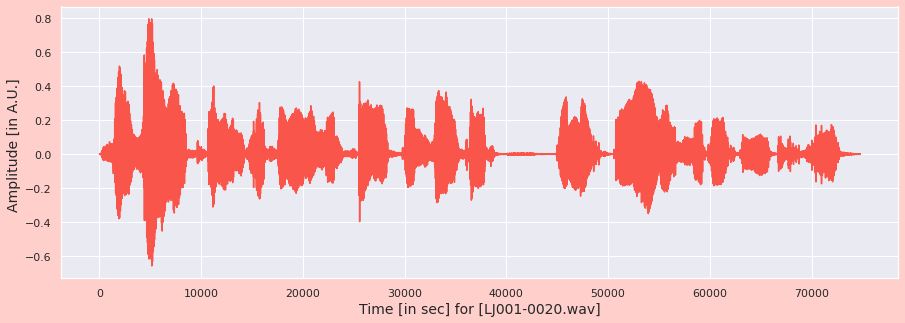


_________________________________________________________________________________________________________



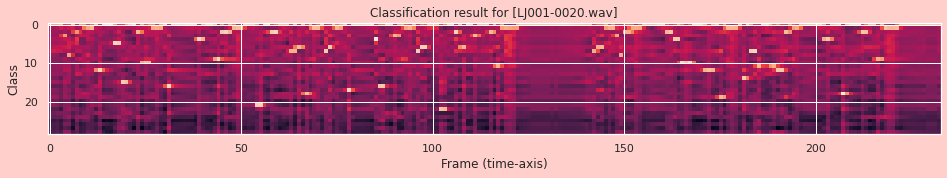

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  3,  8,  0,  2,  0,  0,  1,  1,  0, 12,  0,  0,  0,  5,
         5, 15, 15,  0,  0,  2, 10, 10, 10,  1,  1,  1,  0, 16,  0,  0,  0,  0,
         0,  0,  0,  4,  4,  0,  0,  0,  9,  2,  2,  2,  1,  1,  1,  0,  0,  0,
        21, 21,  0,  0,  2,  2,  0,  0,  0,  7,  0,  6,  0, 18,  0,  1,  1,  0,
         7,  6,  0,  1,  1,  0, 17,  0,  0,  0,  0,  0,  0,  4, 16, 16,  0,  0,
         3,  3,  0,  1,  1,  0,  7,  6,  6,  0,  0,  0, 22, 22,  0,  0,  2,  0,
         6,  0,  0,  3,  0,  0,  0,  2,  0, 11,  1,  1,  1,  1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  6,
         6,  0,  1,  1,  3,  8,  2,  2,  1,  1,  1,  0,  0,  0,  0,  0,  0,  2,
         2,  4,  4, 10, 10, 10,  0,  0,  0, 12, 12, 12,  0, 19, 19,  1,  1,  1,
         0,

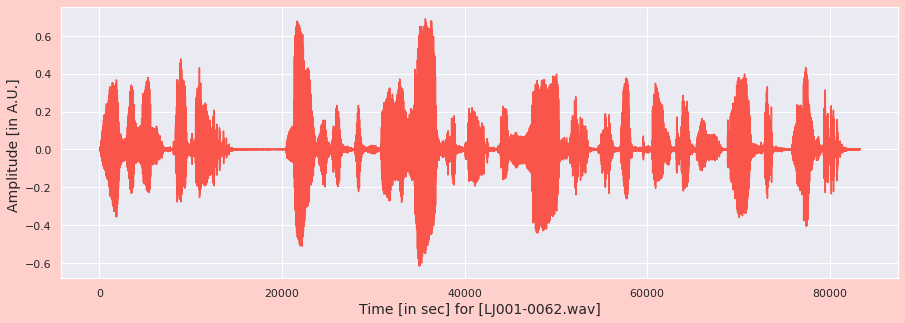


_________________________________________________________________________________________________________



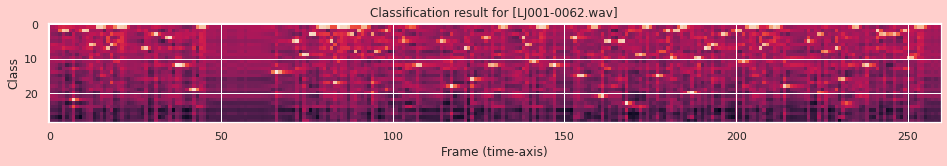

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  2,  0,  0, 22,  0,  0,  2,  2,  6,  0,  1,  1,  0,  7,
         6,  0,  1,  1,  1,  0,  0,  0,  0,  0,  7,  0,  0,  3,  0,  0,  4,  4,
         0, 12, 12,  0,  0,  0, 19,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 14,  0,  0,  0,  0,  0,
         5,  0,  9,  9,  3,  3,  0,  1,  1,  1,  5, 17,  1,  1,  1,  1,  3,  8,
         2,  1,  1,  0,  3,  8,  0,  0,  2,  0,  0,  0,  0,  5,  0,  0,  0, 12,
        12,  0,  0,  0,  0,  0,  5,  0,  0, 18,  0,  0,  0,  7,  0, 16,  0,  0,
         0,  4, 12, 12,  0,  0,  1,  0,  0,  0,  0,  0,  4,  6,  0, 11,  1,  1,
         1,  0,  0, 12,  0,  0,  0,  0,  0,  4, 15, 15,  0,  0,  1,  1,  0, 21,
         5,  5,  0,  0,  5,  5, 23,  0,  0,  0,  9,  0,  1,  0,  0, 15,  0,  0,
         2,

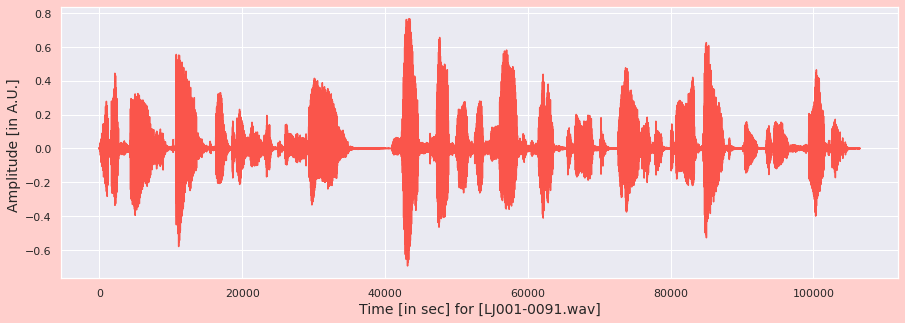


_________________________________________________________________________________________________________



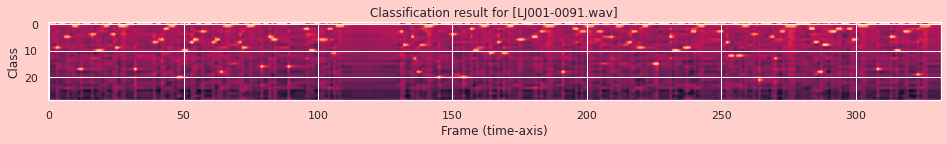

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  9,  0,  0,  5,  5,  0,  1,  1,  0, 17,  0,  0,  0,  4,  0,
        10, 10,  0,  1,  0,  0,  4,  9,  0,  1,  1,  0,  0,  0, 17,  0,  0,  0,
         0,  0,  0,  7,  0,  0,  6,  2,  2,  1,  1,  0, 20, 20, 10, 10,  0,  7,
         6,  0,  0,  3,  0,  0,  0,  7,  6,  6, 18,  0,  1,  1,  0,  0,  0,  7,
         9,  9,  1,  1,  0,  0,  0, 16,  0,  0,  5,  0,  6,  0,  0,  0,  0, 16,
         0,  0,  0,  0,  0,  0,  2, 10, 10,  0,  0,  6,  6,  0,  2,  0, 11,  1,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  3,  8,  0,  0,  5, 13, 18,  0,  8,  1,  1,  1,  0,
         0, 20,  0,  0,  0,  0,  4,  0,  0,  0, 20,  0,  0,  2, 10, 10,  0,  1,
         1,  0, 11,  0,  0,  7,  0, 11,  0,  1,  1,  0,  0,  6,  6,  0,  0,  0,
         5,

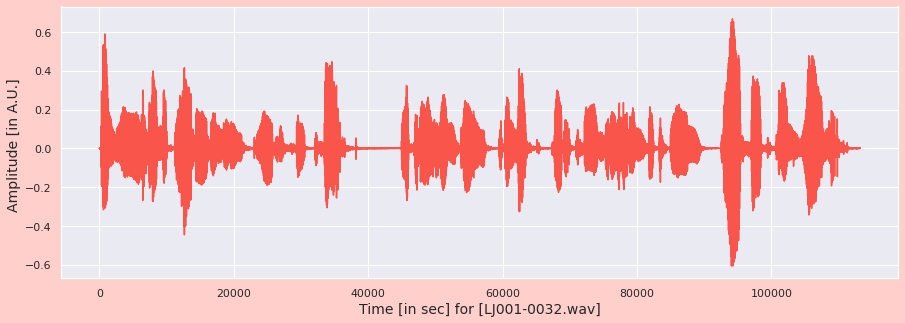


_________________________________________________________________________________________________________



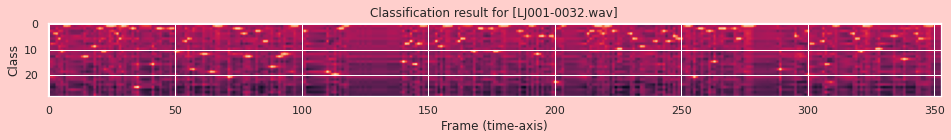

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  4,  6, 11,  0,  1,  0,  0,  0,  0,  0,  0, 13, 13,  0,  0,
         9,  0,  2, 11, 11,  1,  1,  1,  1,  4,  6,  1,  1,  0,  0,  2, 25, 25,
         0,  0,  0,  0,  0, 16,  0,  2,  2,  0,  0,  0,  2,  0, 11,  0,  0,  0,
         7,  6,  0, 18,  0,  0,  0, 12, 12,  0, 19, 19,  1,  1,  1,  0,  0, 21,
         0,  0,  2,  2,  0,  4, 13, 13,  0,  0,  3,  3,  0,  7,  7,  0, 17,  0,
         0, 13, 12, 12,  0,  0,  1,  1,  1,  0,  0,  3,  0,  0,  0,  0,  0,  0,
         0,  0, 19,  0,  0, 20,  0,  2,  2,  1,  1,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 15,  8,  0,  7,
        16, 16,  8,  1,  1,  0,  0,  0,  0,  7,  0,  9,  0,  1,  1,  1,  0,  0,
         7,  6,  6,  0,  0,  0, 11,  0,  2,  2,  0,  0,  0,  2, 11, 11,  0,  1,
         1,

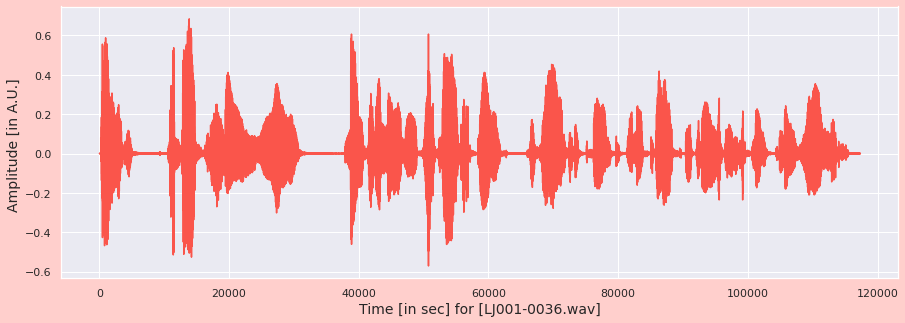


_________________________________________________________________________________________________________



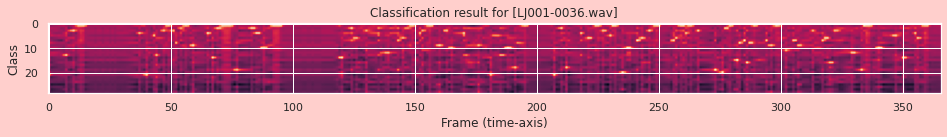

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([21,  0,  0,  0,  0,  0,  0, 13,  0,  0,  3,  0,  1,  1,  1,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  4,  0,  0, 21,  0,  0,  5, 13,  0,  0,  3,  1,  1,  0,  3,  8,  0,
         2,  1,  1,  0,  0,  9,  0,  0,  0,  0,  0,  4,  0, 14,  0,  2,  2,  1,
         1,  1,  1,  0,  0, 19,  0,  0,  0,  0,  0,  2,  2,  4,  4, 10, 10, 10,
         0,  0,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 14, 14,  0,  0,  0,  2,  6,
         6,  0,  0,  0,  3,  0,  0,  0,  0,  2,  0,  0, 12, 12,  0,  0,  0,  7,
         0,  6,  0,  2,  1,  1,  0,  0,  4,  3,  0,  1,  1,  1,  0,  0,  9,  0,
         0,  3, 10, 10,  0,  0,  0,  0,  4, 13,  0,  0,  0,  0,  9,  0,  0,  0,
         0,

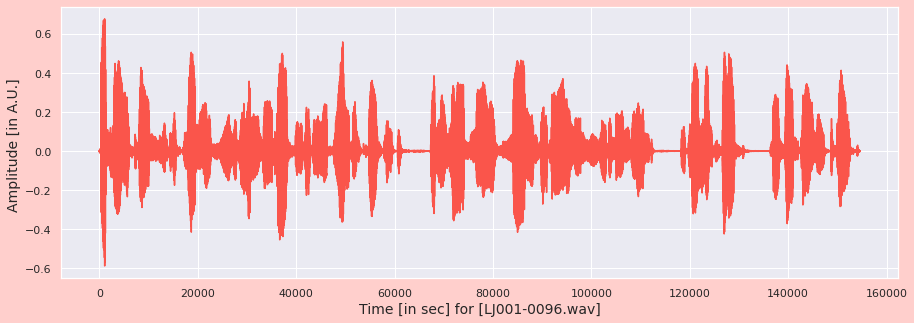


_________________________________________________________________________________________________________



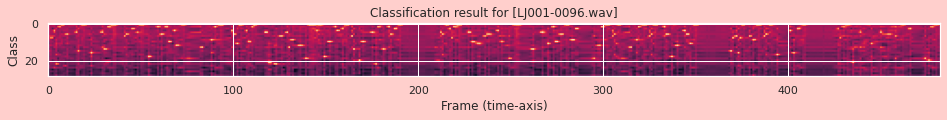

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  8,  0,  4, 22,  0,  2,  1,  1,  0,  6,  0,  0,  0,  0,  5, 15,  0,
         1,  1,  0,  0,  0, 16,  0,  0,  0,  0,  0,  5, 14, 14,  2,  2,  1,  1,
         1,  0,  0,  0,  0,  7,  6,  0,  0,  3,  3,  0,  5,  0,  1,  1,  0,  0,
        18,  0,  0,  0,  0,  2,  0,  6,  0,  2,  2, 10, 10,  0,  4, 12, 12,  0,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  0, 13, 13,  0,  0,  0,  0,  9,  0,
         2,  0,  1,  1,  1,  0,  0,  0,  0,  4,  6,  0, 11,  1,  1,  0,  0,  4,
        10, 10,  2,  1,  1,  0,  0,  0,  0,  5,  5, 21, 21,  0, 22, 22,  0,  7,
         7,  0,  0,  5, 13,  9,  9,  0,  0, 12, 12,  0,  0, 19,  0,  1,  1,  1,
         1,  4,  1,  1,  0, 18,  0, 10, 10,  0,  0,  2,  4,  0,  0,  3,  0,  1,
         1,  0,  7, 14,  0,  0, 20,  0, 10,  0,  0,  0,  0,  5,  0, 22,  2,  0,
         0,

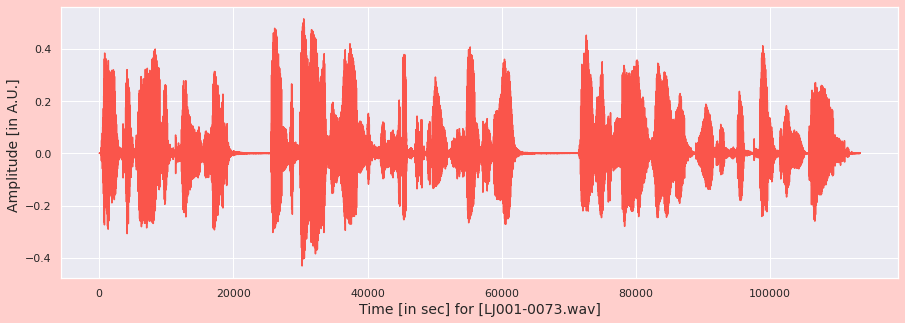


_________________________________________________________________________________________________________



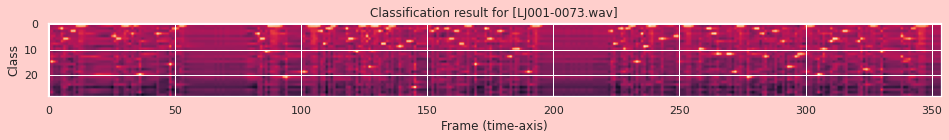

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0, 15,  0,  0,  0,  2,  6,  6,  0,  3,  3,  1,  1,  1,  1,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  5,  6,  6,  0,  1,  1,  0,  4,  0,  0,
        20,  0,  0,  0,  0,  0,  0,  4,  0,  0,  0,  0, 16,  0,  2,  0,  1,  1,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,  6,  6, 11,  1,  1,  1,
         1,  1,  0,  0, 21,  0,  0,  0,  0,  0,  0, 19,  0,  1,  1,  1,  1,  1,
         3,  8,  0,  2,  1,  1,  0,  0,  0,  0,  2,  6,  6,  0, 11,  0,  1,  1,
         5, 17,  1,  1,  1,  3,  8,  8,  2,  1,  1,  0,  0,  9,  0,  0,  7,  7,
         0, 25,  0,  0,  0,  0,  0,  0,  3,  0,  2,  0,  0,  0,  2,  6,  6,  3,
         3,  8,  8,  0,  1,  1,  0, 16,  0,  0,  0,  2,  6,  6,  0,  0,  0,  3,
         0,

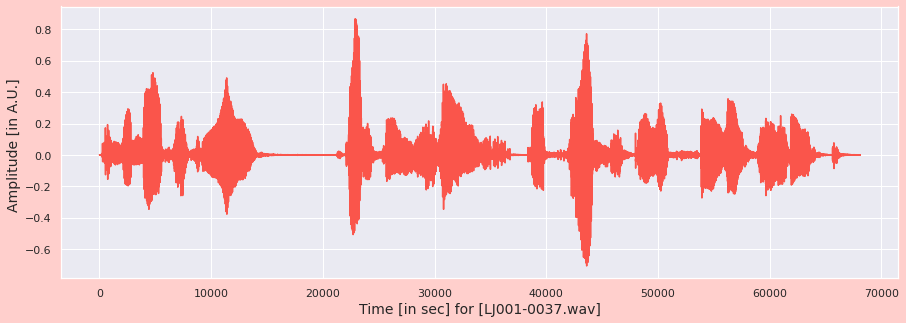


_________________________________________________________________________________________________________



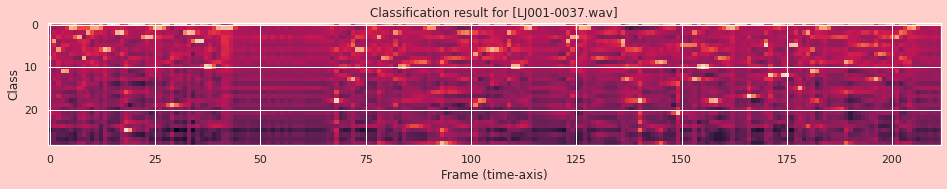

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  4,  6, 11, 11,  1,  0,  3,  8,  2,  1,  1,  0,  6,  0,  0,  0,  2,
        25,  0,  0,  0,  0,  3,  3,  1,  1,  0,  0, 19,  0,  0,  0,  2,  0,  4,
         4, 10, 10,  0,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 18,  0,  0,  0,
        13,  6,  6,  0,  0,  0,  3,  8,  0,  0,  2,  0, 10,  0,  0,  0,  0,  0,
         1,  0,  0, 28,  0,  0,  0,  0,  0,  2,  0,  7,  0,  0,  0,  6,  0,  0,
         0,  2, 10, 10,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  4,  3,  0,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  4, 13,  0,  0, 18,  0,  0,  0,
         0,  9,  0,  0,  0, 21,  0,  0,  0, 13,  0, 10, 10, 18, 18,  0,  0,  1,
         1,  0,  0,  0, 17,  0,  0,  0,  5, 12,  0,  0, 12, 12,  5,  5, 15,  0,
         2,

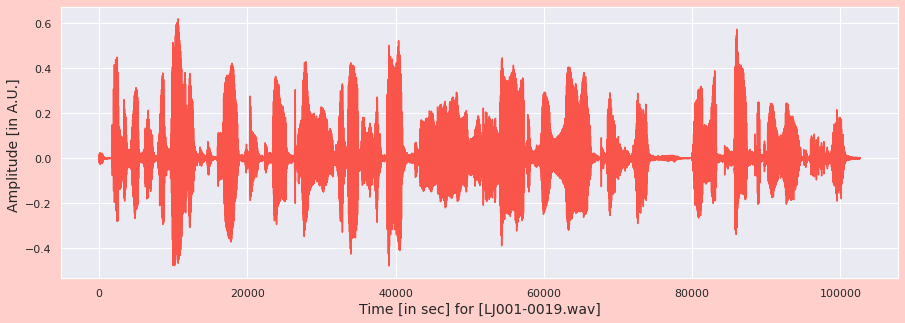


_________________________________________________________________________________________________________



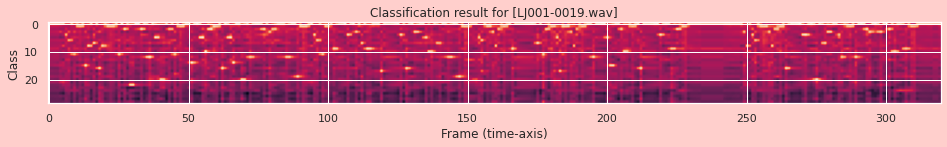

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  4,  6,  0, 11,  1,  1,  0, 15,  8,  0,  7,  0,
        16,  8,  0,  1,  1,  1,  0, 11,  0,  2,  0, 22, 22,  0,  0,  2,  0, 12,
        12,  0,  5,  5, 20, 20,  0,  2,  0, 11,  0,  1,  1,  0,  0, 14,  0,  0,
         5,  5, 10,  2,  2,  1,  1,  0, 16,  0,  5,  5, 14,  0,  0, 20, 20,  0,
        12,  0,  0,  0,  0,  2,  0,  3,  2,  2,  0,  0,  0, 12, 12,  0,  0, 19,
         1,  1,  1,  0,  0,  4,  6,  0, 11,  1,  1,  0,  9,  9,  0,  0,  0,  4,
         0,  0,  3,  0,  7,  0,  9,  9,  0,  0,  0, 17,  0,  0,  0,  0,  0,  0,
         4,  0, 16,  0,  0,  3,  3,  0,  0,  5, 10, 10,  0,  7,  7,  0,  0, 12,
        12,  0,  0, 19,  1,  1,  1,  0,  0,  0,  5,  6,  0,  1,  1,  3,  8,  2,
         1,  1,  1,  0,  9,  0,  0,  0,  0,  0,  0,  0,  0,  7,  0, 11,  2,  2,
         1,

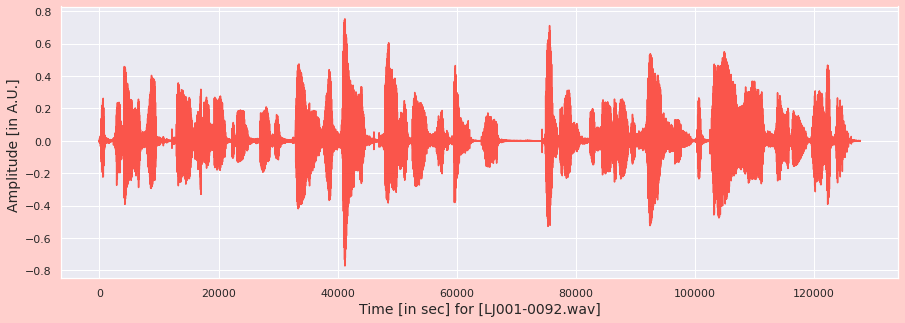


_________________________________________________________________________________________________________



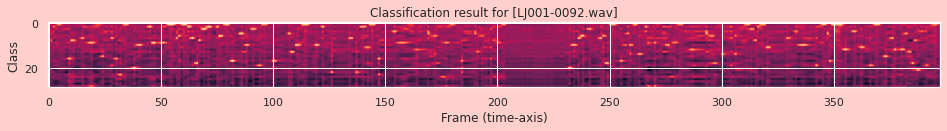

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  2,  0,  1,  0,  0,  0,  0, 16,  8,  8,  0,  0,  0,  7,  0,  0,
         9,  9,  0,  0,  0,  0, 15,  0,  0,  0,  7,  0, 16,  0, 23,  0,  1,  0,
         0,  0, 20,  0, 10, 10,  0,  0,  0,  2,  9,  9,  0,  0,  9,  9,  0,  1,
         1,  1,  0,  7,  6,  0,  1,  1,  2,  2,  7, 18, 18,  8,  3,  3,  3,  2,
         2,  0,  0,  2,  6,  6,  0,  1,  1, 17, 17,  0,  0,  5,  5,  0, 10,  0,
         0,  3,  0,  0, 19,  1,  1,  0,  0,  0, 17,  0,  0,  0,  0,  0,  0,  5,
        13,  0, 10, 10,  0,  1,  1,  1,  0,  0,  0, 10,  0,  0,  2,  0,  0,  0,
        22,  0,  0,  0,  0,  0,  0,  0,  7,  7,  0, 22,  0,  2,  2,  2, 11,  1,
         1,  0,  0, 16,  0,  0,  0,  0,  0,  0,  4,  0,  0,  9,  9,  9,  0,  0,
         0,  0, 12,  0,  0,  0,  0,  5,  0,  0,  6,  0,  0,  0, 24,  9,  0,  0,
         1,

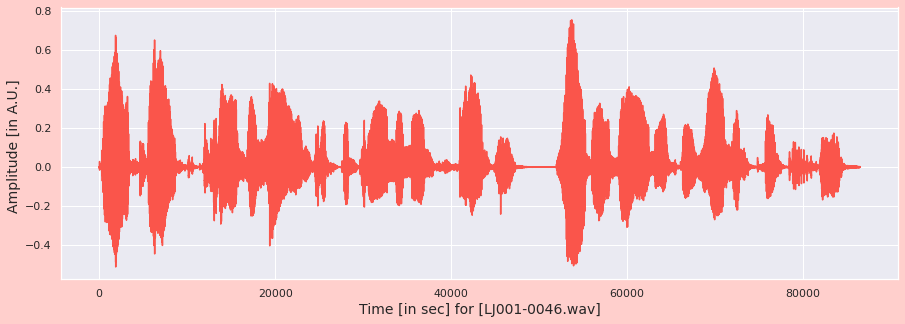


_________________________________________________________________________________________________________



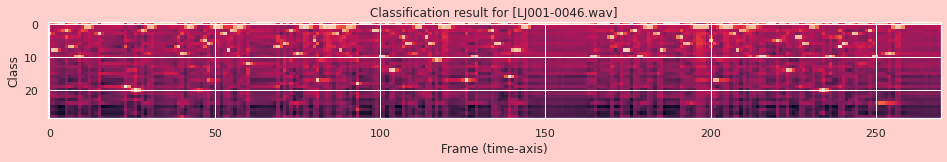

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  8,  0,  0,  2,  7,  7,  0, 10,  0,  1,  1,  0,  0,  3,  0,  0,
         0,  0,  0,  0,  0, 19,  0,  0, 20,  0,  2,  0,  1,  1,  0,  0,  0,  0,
         0,  0,  0,  7,  9,  0,  1,  1,  0,  0,  0,  5,  6,  0,  1,  1,  1,  3,
         8,  2,  2,  1,  1,  0, 12,  0,  0,  0,  0,  0,  0,  0,  0,  7,  0,  6,
         0,  2,  0,  9,  1,  1,  1,  0,  5, 17,  0,  1,  1,  1,  1,  3,  8,  2,
         1,  1,  0, 18,  0,  0,  0,  0,  2,  2, 10, 10,  0, 14, 14,  0,  0,  4,
         6,  6,  0,  1,  1,  0,  4,  6,  0, 11,  0,  1,  1,  1,  0,  0,  0,  0,
        17,  0,  0, 10,  0,  0,  0,  0,  2,  6,  6,  0,  0, 16,  0,  8,  8,  1,
         1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0, 10, 10,  0,  0,  0,  0,  4,  0,  0,  3,  8,  8,  0,  2, 10, 10,
         1,

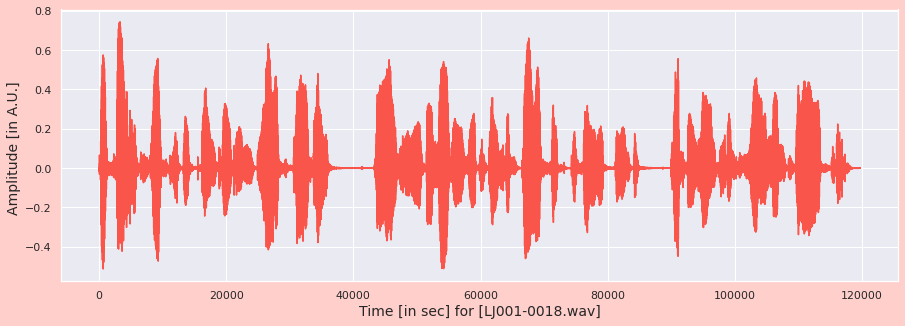


_________________________________________________________________________________________________________



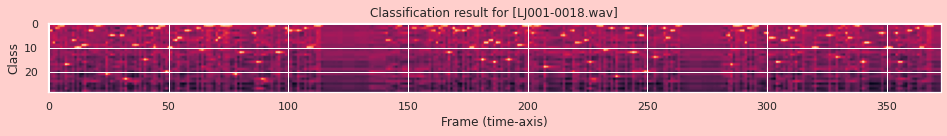

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  3,  8,  2,  0,  1,  1, 17,  0,  0,  7,  0, 10,  0,  9,  9,  0,  3,
         3,  0,  1,  1,  0,  0, 21,  0,  5,  5,  0,  0,  5,  0, 23,  0,  0,  0,
         9,  9,  1,  0, 15,  0,  0,  2, 10,  2,  0,  1,  1, 20, 10, 10,  0,  7,
         6,  6,  0,  3,  3,  0,  0,  0,  2,  0, 11,  1,  1,  1,  1,  0,  7,  6,
         1,  1,  1,  1,  0,  0, 21,  0, 12,  0,  0,  0,  0,  0,  4, 16,  0, 23,
         0,  0,  1,  1,  0, 12, 12,  0,  0,  2,  3,  3,  0,  0,  3,  0,  0,  2,
        10, 10, 10,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  7,  0,
         0,  0,  1,  0,  0,  0,  0,  0,  0,  2,  0,  0,  0,  0,  1,  1,  1,  3,
         8,  2,  0,  1,  1, 12,  0,  2,  3,  0,  0,  3,  0,  2, 10, 10,  1,  1,
         0,

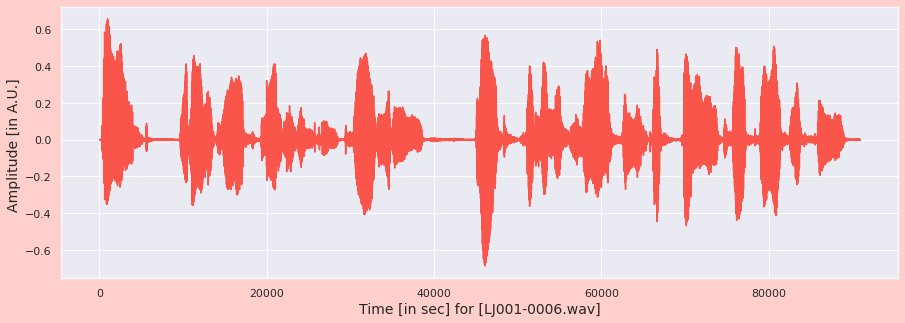


_________________________________________________________________________________________________________



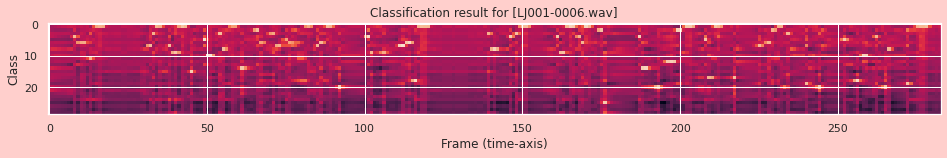

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  0,  0,  4,  0,  6,  6,  0, 11,  0,  1,  1,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  3,  1,  1,
         0,  0,  7,  0,  9,  0,  1,  1,  0, 15,  0,  0,  0,  5, 10, 10,  0,  0,
         3,  8,  0,  0,  1,  1,  0, 14,  0,  0,  0,  0,  2,  6,  0,  0,  0,  3,
         7,  7,  0,  5,  6,  6,  0,  0,  0,  1,  1,  0,  0,  7,  6,  0,  1,  1,
         0,  0, 20,  0,  0,  0,  0,  0,  0,  0,  0,  4,  9,  0,  0,  0,  9,  0,
         0,  0,  0,  7,  7,  6,  6, 18, 18,  1,  1,  1,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  0,  8,  0,  0,
         0,  0,  4,  0,  3,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,
         9,  9,  0,  1,  1,  0,  4,  6,  1,  1,  0,  0,  0,  2, 25,  0,  0,  0,
         0,

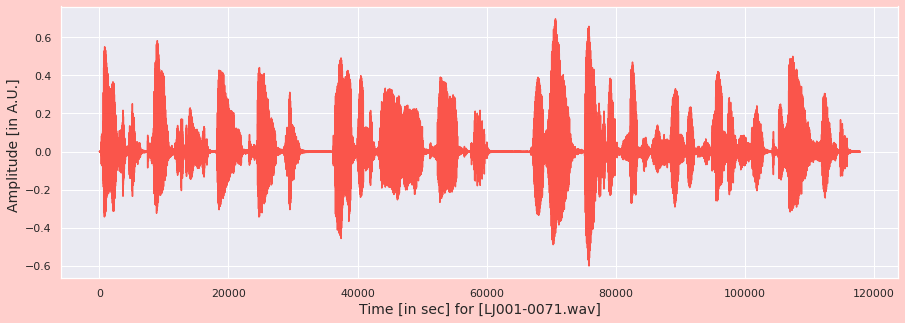


_________________________________________________________________________________________________________



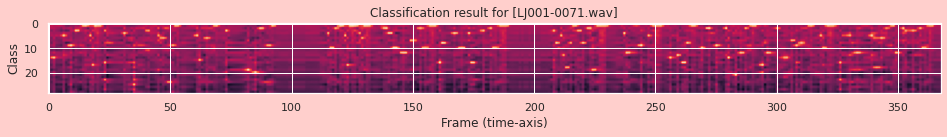

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0, 14,  0,  0,  0,  5,  0,  0,  9,  0,  3,  3,  0,  1,  1,  0,  5,
        17,  1,  1,  1,  0, 16,  0,  0,  0,  0,  0,  0,  0,  4,  0,  0,  0, 25,
         0,  0,  0,  0,  3,  3,  0,  0,  0,  5,  6,  6,  0, 24, 24,  9,  1,  1,
         0,  0,  0,  0,  0,  0,  0,  5, 15,  0,  0,  6,  0,  0,  1,  1,  0,  0,
         0,  3,  0,  0,  0,  0,  0,  0,  0,  0, 19,  0,  0, 20,  0,  2,  2,  0,
         9,  9,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  4, 10, 10,  2,  0,  1,  1,  5, 17,  1,  1,
         1,  1,  4,  6,  1,  1,  1,  0,  0,  0,  0,  0,  2,  2,  4,  4, 10, 10,
         0, 12, 12, 12,  0,  7,  7,  0,  0,  2, 10, 10,  0,  1,  1,  1,  0, 16,
         8,  8,  0,  0,  0,  4,  0, 10, 10, 10,  0,  4, 16, 16,  0,  0,  0,  3,
         0,

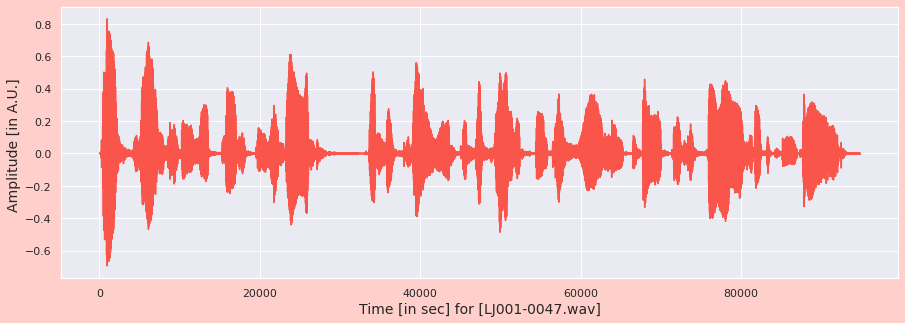


_________________________________________________________________________________________________________



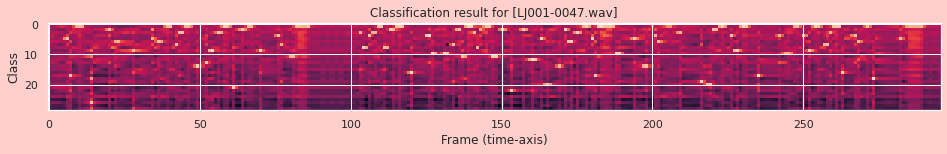

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  5, 17,  0,  1,  1,  1,  0,  0, 26,  0,  0,  0,
         0,  0,  2,  0,  6,  6,  0,  0,  0,  0,  9,  0,  0,  0,  0,  0,  5,  0,
         6,  6,  0,  1,  1,  0,  7,  3,  3,  1,  1,  0,  0, 14,  0,  0, 13,  9,
         9,  0,  3,  3,  1,  1,  0, 21,  0,  0,  2,  0,  1,  1,  0,  0,  9,  0,
         0,  0,  0,  0,  4,  7,  0,  0,  0, 11,  1,  1,  1,  1,  1,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  8,  0,  4,  3,
         3,  1,  1,  8,  0,  2,  2,  1,  1,  1,  0,  0, 16,  0,  0,  0,  0,  4,
         4, 10,  0,  0,  0, 10, 10,  0,  7,  0,  2, 11,  1,  1,  1,  3,  8,  2,
         0,  1,  1, 11, 11,  0,  2,  0,  0, 22,  0,  0,  0,  2,  0,  0, 12, 12,
         0,  5,  0, 20,  0,  0,  0, 14,  0,  2,  6,  6,  0,  3,  0,  1,  1,  1,
         5,

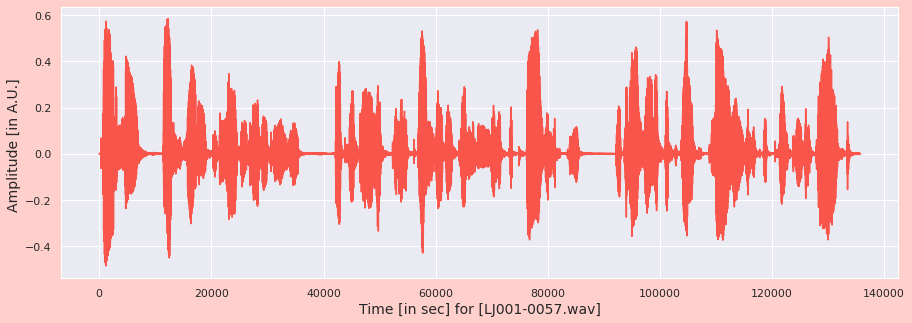


_________________________________________________________________________________________________________



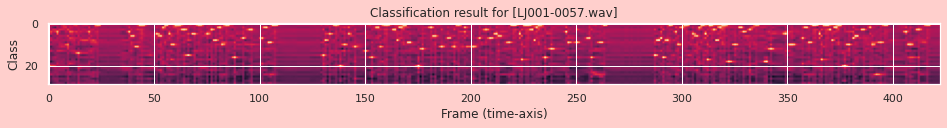

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([20,  0,  0,  0,  4,  0,  0,  0,  0, 10,  0,  0,  0,  0, 14,  0,  0,  0,
         0,  4,  0,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  4,  6,  6, 11, 11,  1,  1,  1,  0,  0,  0,  0,  0,  5,  0,  6,
         2,  1,  1,  5, 10, 10,  1,  1,  1,  3,  3,  3, 15,  0,  5,  5,  0,  1,
         1,  0,  0,  5,  0,  3,  8,  8,  0,  2, 10,  0,  1,  1,  0,  0, 16,  0,
         0,  0,  7,  0,  0,  3,  3,  0,  0,  0,  0,  7,  2,  2,  9,  9,  1,  1,
         1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0, 15,  8,  0,  5,  0,  1,  1,  0, 20,  0, 10,  0,  5,  0,
         0, 11,  0,  0,  0,  0, 13,  0,  0, 16,  0,  2,  2, 11,  0,  1,  1,  0,
         0,  3,  3,  8,  2,  2,  1,  1,  9,  9,  0,  0,  0, 20,  0, 12,  0,  0,
         0,

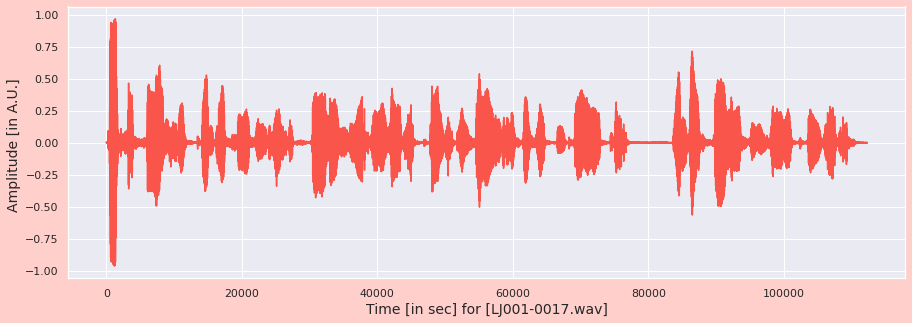


_________________________________________________________________________________________________________



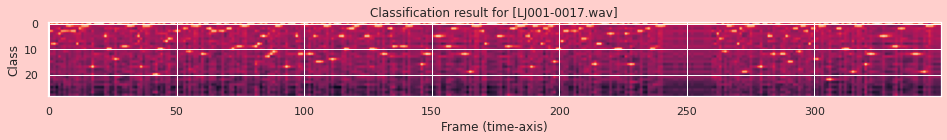

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  0,  8,  0,  4,  3,  3,  1,  1,  3,  3,  8,  2,  1,  1,  1,  0, 17,
         0,  0,  0,  0,  5, 10, 10,  0, 14,  0,  0,  9,  9,  1,  1,  0,  0,  5,
        17,  1,  1,  1,  0,  0, 20, 10, 10,  0,  7,  6,  0,  0,  3,  0,  0,  2,
         0, 11,  0,  1,  1,  0, 12,  0,  0,  2,  3,  3,  0,  0,  3,  0,  2,  2,
        10,  0,  9,  9,  1,  1,  0,  0,  0,  9,  8,  0,  5,  0, 13, 12, 11,  1,
         1,  0,  0, 17,  0,  0,  0,  5, 12, 12,  0,  0, 12,  0,  5, 15, 15,  0,
         1,  1,  0, 14,  0,  0,  5,  5, 10, 10,  2,  2,  1,  1,  0,  0,  5,  5,
        10, 10,  1,  1,  1, 12,  0,  0,  2,  9,  0,  0,  9,  9,  1,  1,  1,  0,
         0,  0, 16,  0, 12, 12,  0,  0,  5,  5,  0,  0,  9,  9,  2,  2,  0,  0,
        12, 12,  0, 19,  1,  1,  1,  0,  3,  8,  0,  0,  0,  0,  5,  5,  0,  0,
         9,

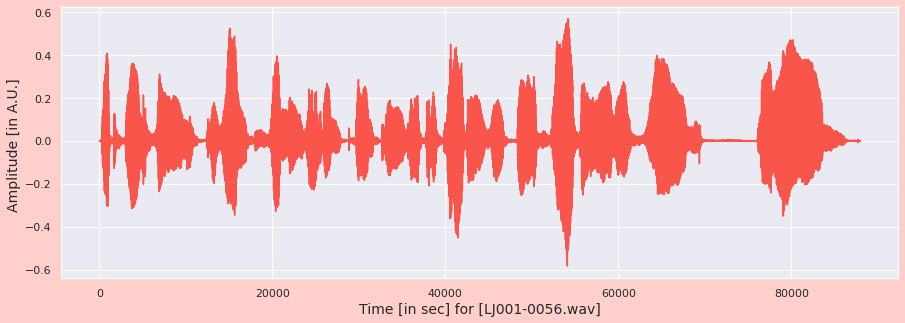


_________________________________________________________________________________________________________



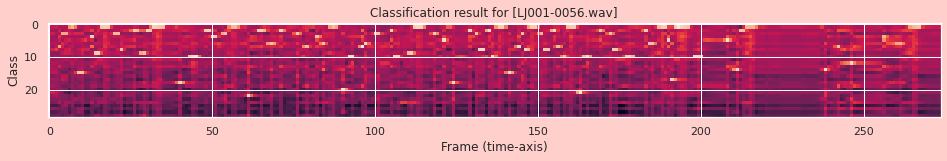

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  7,  3,  3,  0,  1,  0, 15, 15,  0,  0,  4,  9,  9,  1,  1,
         1,  0,  3,  3,  8,  0,  0,  0,  2,  2,  0,  9,  2,  2,  1,  1,  1,  1,
         0,  0,  0,  0, 18,  0,  0, 10, 10, 10,  0,  0,  2,  2,  4,  4,  0,  3,
         3,  0,  1,  1,  0,  0,  0, 22,  0,  0,  2,  2,  0,  0,  6,  0,  0,  2,
         0,  0,  0,  0,  3,  0,  0,  7,  0,  0,  4,  0,  6,  0,  1,  1,  0,  0,
        20,  0, 10, 10,  0,  0,  7,  6,  0,  0,  3,  3,  0,  0,  0,  2, 10, 10,
         0,  0,  9,  9,  1,  1,  1,  0,  0,  0,  3,  0,  0,  5,  0,  0, 18,  0,
         0,  0,  0,  2,  0,  3,  8,  8,  0,  2, 10,  0,  1,  1,  0, 15,  0,  0,
         7,  3,  8,  8,  1,  1,  0,  3,  8,  8,  0,  2,  7,  0, 10,  1,  1,  1,
         0, 21,  0, 10,  0,  0,  0,  2,  0,  0,  3,  8,  8,  0,  0, 10, 10, 10,
         0,

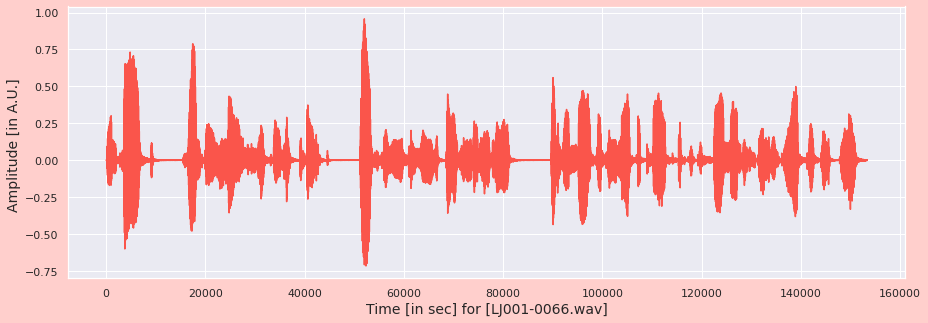


_________________________________________________________________________________________________________



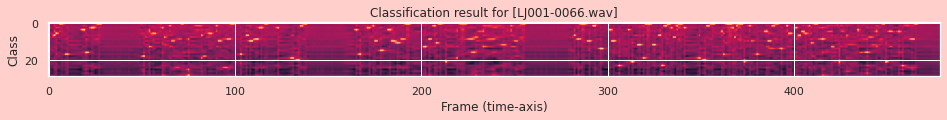

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  7,  6,  0,  1,  1,  0, 17, 17,  0,  0,  0,  0,  0,  0,  0,
         4,  4, 16, 16,  0,  3,  3,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 18,  0,  0,
        13,  0,  6,  6,  0,  0,  0,  3,  8,  0,  0,  2, 10, 10,  0,  0,  0,  1,
         1,  0,  0, 28,  0,  0,  0,  0,  0,  0,  7,  0,  0,  0,  6,  6,  0,  0,
         2, 10, 10,  0,  0, 24,  9,  9,  1,  1,  0,  0,  0, 17,  0,  0,  7,  7,
        10, 10,  0,  9,  9,  3,  3,  0,  1,  1,  0,  0,  0,  0,  0,  3,  0,  0,
         0,  0,  0,  0, 19, 19,  0, 20, 20,  2,  2,  1,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  4,  0, 17,  0,  0,  0,  0,  3,  0,  2, 10, 10,  0, 15, 15,
         0,

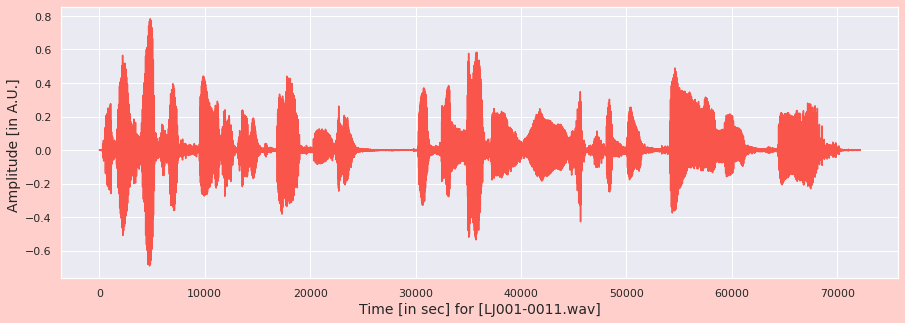


_________________________________________________________________________________________________________



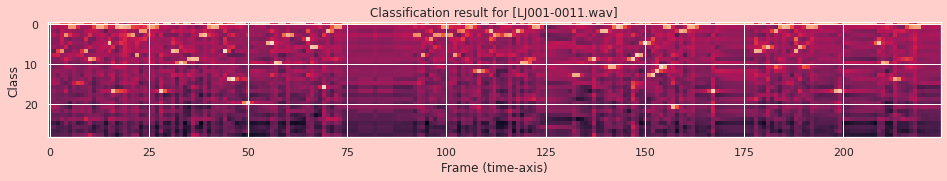

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  7,  3,  1,  1,  0,  0,  7,  9,  0,  1,  1,  0,  5, 17,  1,
         1,  1,  1,  3,  8,  2,  2,  1,  1,  0, 17,  0,  0,  7,  7, 10,  0,  9,
         9,  9,  0,  3,  0,  1,  1,  0,  7, 14, 14,  0,  0,  0, 20,  0,  0,  0,
         0,  0,  5, 10,  0,  0,  3,  0,  0,  0,  0,  4,  6,  6,  0, 16,  2,  0,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  3,  8,  0,  4,  3,  3,  1,  1,  3,  8,  0,  2,  1,  1,  0,
        12,  0,  0,  2,  3,  0,  0,  0,  3,  0,  2, 10, 10,  0,  1,  1,  0,  0,
         0,  0,  0,  0,  0,  0, 13, 13,  0,  0,  0,  9,  0,  2,  2, 11, 11,  1,
         1,  0,  0,  9,  8,  0,  5,  0, 13, 12, 11, 11,  1, 21,  0,  2,  2,  1,
         1,  0,  0,  0,  0, 17,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  7,
         0,

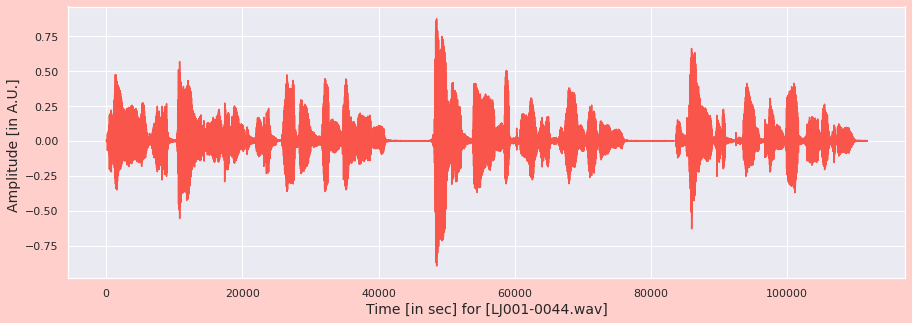


_________________________________________________________________________________________________________



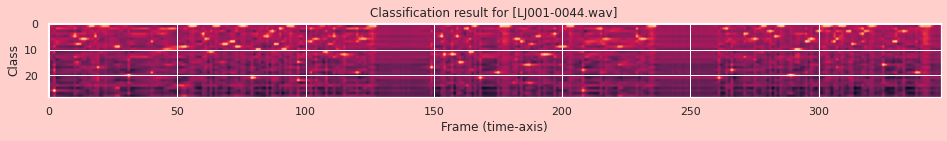

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0, 26,  0,  0,  0,  0,  0,  0,  0,  5,  8,  0,  6,  6,  0,  1,  1,
         5, 17,  0,  1,  1,  0,  0,  0,  9,  9,  0,  0,  0, 20,  0,  0,  0,  0,
         0,  0,  0,  0,  7,  0,  0,  0,  0, 10, 10,  2,  2,  0,  0,  0,  9,  9,
         0,  1,  1,  1,  0,  0,  4,  6,  0, 11,  0,  1,  1,  0,  8,  8,  0,  7,
         7,  9,  9,  1,  1,  0,  0, 21,  0, 10, 10,  0,  0,  5,  0,  3,  8,  8,
         2, 10, 10,  1,  1,  1,  0, 22,  0,  0,  0,  0,  7,  0,  6,  0,  0,  0,
        11,  0,  0,  5,  0,  0,  0, 12,  0,  0,  0,  0, 19,  0,  6,  6,  0,  1,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0, 17,  0,  0,  0,  5, 12,  0,  0, 12,  0,  5, 15,  0,
         0,  2, 11, 11,  1,  0, 21,  0,  0,  0,  0,  0,  0, 19,  1,  1,  1,  1,
         0,

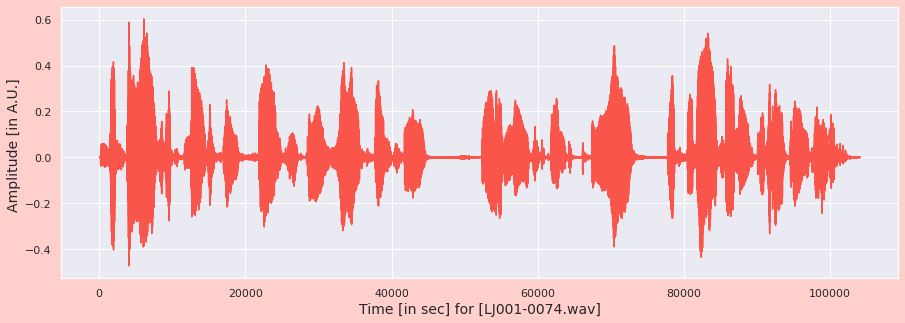


_________________________________________________________________________________________________________



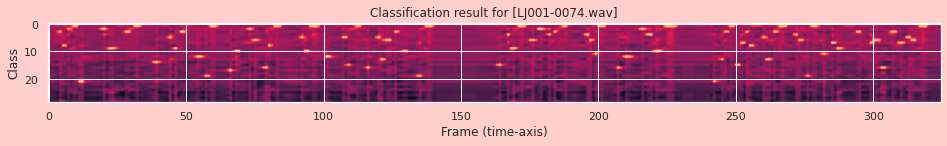

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  3,  8,  0,  2,  0,  1,  1, 21, 21,  0,  0,  0,  0,  0,
         0,  0,  2,  0,  9,  9,  0,  0,  0,  0,  3,  3,  0,  0,  1,  0,  0,  0,
         0,  0,  0, 14,  0,  0,  0,  0,  5,  0,  9,  0,  3,  3,  0,  0,  0,  0,
        12, 12,  0, 19, 19,  1,  1,  0,  0,  0,  0,  0, 17,  0, 10, 10,  0,  0,
         0,  2,  0,  6,  0,  0,  0, 16,  8,  0,  1,  1,  0,  0,  0,  0,  0,  0,
         0,  0,  5, 10, 10,  1,  1,  1,  0,  0,  0, 12, 12,  0,  0,  0,  0,  5,
         5, 15,  0,  0,  1,  1,  0,  0, 16,  0,  0,  0,  5, 13,  0,  6,  6,  0,
         3,  0,  0, 10, 10,  0,  0,  0, 19, 19,  0,  1,  1,  1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0, 15,  0,  0,  4,  9,  9,  0,  1,  1,  0,  0,  6,  6,  0,  2,  2,
         0,

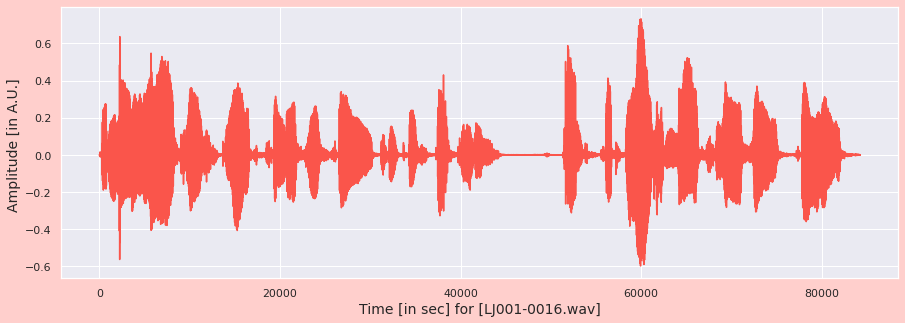


_________________________________________________________________________________________________________



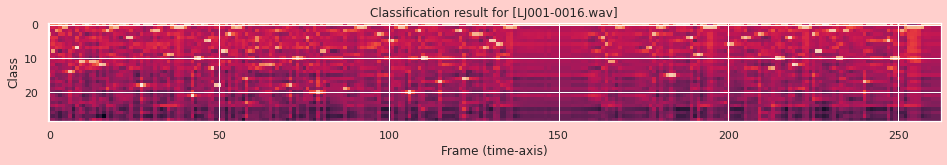

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  2,  0,  1,  0, 14,  0,  7, 11, 11,  0, 11, 11,  0, 12, 12,  2,
         0,  1,  1,  0,  0,  4,  4,  0,  0, 18,  0,  0,  0,  2,  2,  0,  0,  9,
         0,  1,  1,  1,  0,  0, 21,  0, 10,  0,  5,  5, 13, 18, 18,  8,  0,  3,
         0,  1,  1,  0, 16,  0,  0,  4,  0,  0, 12, 12,  0,  7,  0,  0,  0, 18,
         0, 10,  0,  0,  4,  0,  0, 20,  0,  8,  0,  0,  0,  0,  0, 19,  0,  0,
         0,  1,  1,  1,  0,  0,  0,  3,  0,  0,  0,  5,  0,  1,  1,  0, 20,  0,
         0,  2, 10, 10,  0,  0,  0, 17,  0,  0,  0,  0,  0,  2, 16,  0,  0,  3,
         3,  0,  7,  0,  5,  5,  6,  0,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  4,  6, 11, 11,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  7,  3,  0,
         1,

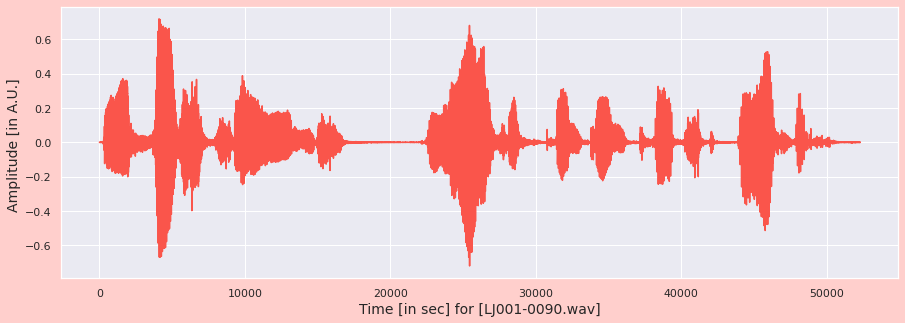


_________________________________________________________________________________________________________



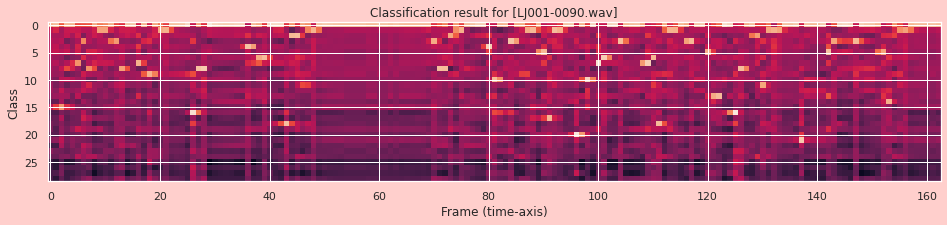

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0, 15,  0,  0,  7,  3,  8,  0,  1,  1,  0,  3,  8,  0,  0,  7,  0,
         9,  0,  1,  1,  0,  0,  0,  0, 16,  8,  8,  0,  0,  0,  0,  0,  0,  0,
         4,  0,  6,  6,  0,  0,  0, 18,  2,  2,  0,  0,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  8,
         8,  2,  0,  1,  0,  0,  0,  0,  4, 10,  0,  0,  3,  0,  0,  1,  1,  0,
         5, 17,  1,  1,  0,  0, 20,  0, 10,  0,  7,  6,  0,  0,  3,  0,  0,  0,
         0,  7,  6, 18,  0,  1,  1,  0,  0,  3,  0,  0,  5, 13, 13,  0,  0, 16,
         8,  0,  0,  2, 11,  1,  1,  1,  0,  0,  0, 21,  0,  0,  0,  0,  5,  3,
         0,  0,  0,  3,  0,  0,  0,  0,  5, 14,  0,  1,  1,  0,  0,  0,  0,  0,
         0])

Merge repeats  tensor([ 0, 15,  0,  7,  3,  8,  0,  1,  0,  3,  8,  0,  7,  0

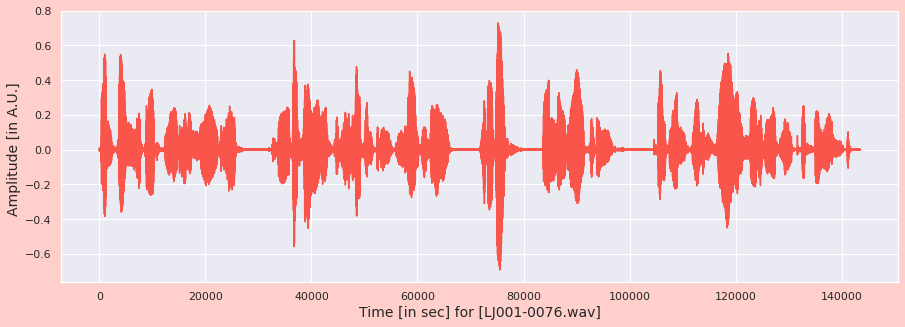


_________________________________________________________________________________________________________



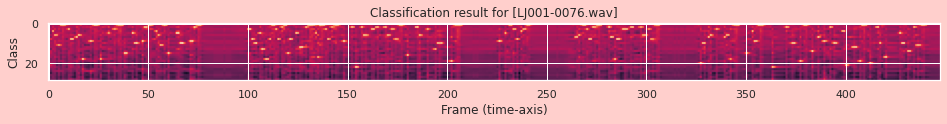

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  4,  6,  0, 11,  1,  1,  1,  0,  3,  8,  8,  0,  7,  6,  0, 18,
         0,  0,  0,  9,  0,  1,  1,  0, 18,  0,  0,  0,  5,  0,  0,  3,  0,  1,
         1,  1, 15, 15,  0,  0,  5, 10, 10,  0,  0,  9,  2,  2,  1,  1,  0,  0,
         4,  6, 11, 11,  1,  0, 15,  0,  0,  0,  5,  5, 10, 10,  0,  0,  0,  9,
         9,  2,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  3,  8, 10, 10,  0,  5, 13,
        13, 18, 18,  8,  1,  1,  3,  8,  0,  2,  1,  1, 15,  8,  0,  0,  5,  5,
        12, 12,  0,  2,  0,  1,  1,  1,  5, 17,  1,  1,  1,  3,  8,  0,  2,  0,
         1,  1,  0,  0,  9,  0,  0,  0,  2,  0, 22, 22,  0,  2,  6,  6,  0,  0,
         3,  3,  0,  2,  0,  0,  0,  2,  6,  0,  3,  3,  8,  8,  1,  1,  0,  0,
        16,

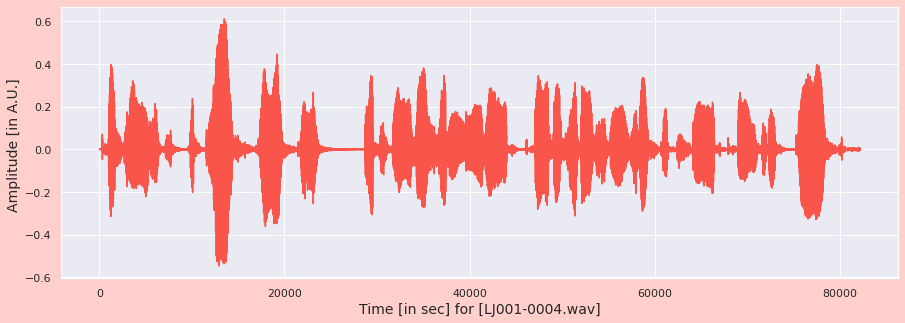


_________________________________________________________________________________________________________



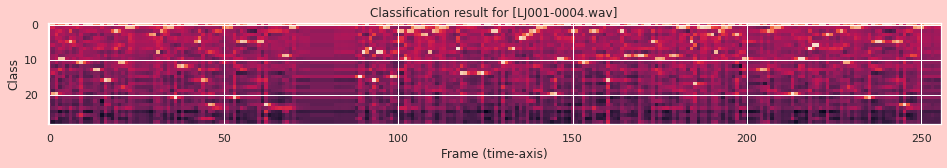

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0, 20, 10, 10,  0,  5,  0,  0, 11,  0,  0,  0, 13, 13,  0, 16, 16,
         0,  2, 11, 11,  1,  1,  1,  0,  0,  0,  0,  0,  3,  8,  2,  0,  1,  0,
        21,  0, 12,  0,  0,  0,  0,  5, 16,  0, 23, 23,  0,  0,  0,  1,  0, 21,
         0,  5,  5,  0,  0,  0,  5,  0, 23,  0,  0,  0,  0,  9,  9,  1,  1,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 15,
         8,  0,  7, 16,  8,  8,  1,  1, 15, 15,  2,  2, 10,  2,  2,  1,  1,  1,
         3,  8,  2,  2,  1,  1,  0,  0,  0,  7, 14, 14,  0,  0,  0,  0, 14,  0,
         0,  2,  2,  0, 11,  0,  0,  7,  0,  4,  4,  3,  2,  2,  1,  1,  0,  0,
         0, 20, 10, 10,  0,  0,  2,  0,  0, 11,  0,  0,  2,  0,  0,  0, 16,  0,
         0,  0,  2,  9,  0,  0,  0,  9,  9,  0,  0,  5,  0, 10,  0,  0,  0,  9,
         0,

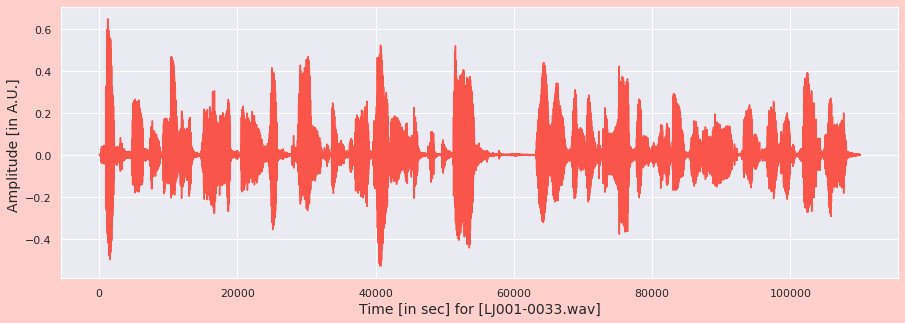


_________________________________________________________________________________________________________



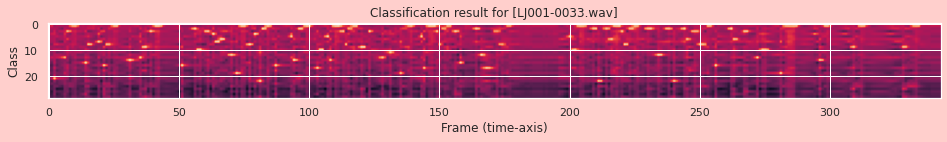

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0, 21,  0,  0,  0, 13,  3,  0,  1,  1,  0,  0,  0, 15,  8,  0,  0,
         0,  7,  0, 16,  8,  8,  0,  1,  1,  0,  0,  0,  0, 14,  0,  0,  0, 13,
         9,  9,  0,  3,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0, 16,  0,  0,
         0,  0,  2, 10, 10,  0,  3,  3,  0,  4,  7,  7,  6,  6,  0,  0, 12,  0,
        19, 19,  1,  1,  0,  8,  0,  4,  0, 22,  2,  2,  1,  0,  0, 16,  0,  0,
         0,  0,  0,  5, 14,  0,  2,  2,  1,  1,  1,  0,  0, 17, 10, 10,  0,  5,
        14,  1,  1,  1,  1,  3,  8,  2,  2,  1,  1,  0,  9,  9,  0,  3,  0,  0,
         0,  0, 13,  0,  0, 11,  0,  0,  0, 19,  0,  0,  1,  1,  0,  0,  0,  5,
        17,  0,  1,  1,  1,  3,  8,  2,  2,  1,  1,  0,  3,  0, 15,  0,  0,  0,
         0,  0,  2,  2, 12, 12, 17, 17,  0,  0,  3,  8,  8,  0,  1,  1,  0,  0,
         0,

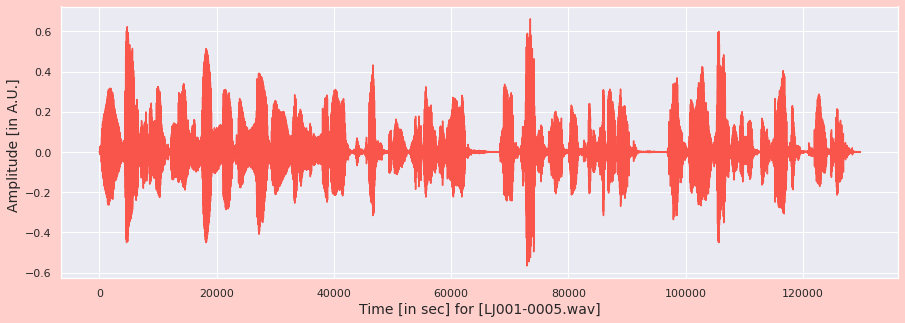


_________________________________________________________________________________________________________



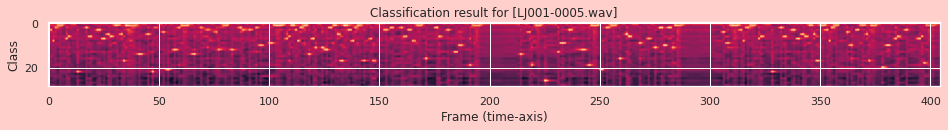

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  3,  8,  2,  0,  1,  1,  0,  7,  6,  0,  0,  0, 22,  0,  0,  0,  2,
         6,  6,  0,  0,  3,  3,  7,  7,  0,  5,  6,  0,  1,  1,  0,  5, 17,  1,
         1,  1,  1,  1,  0, 14, 14,  0,  0,  5,  0, 22,  0,  0,  0,  0,  4,  0,
        21,  0,  0, 12, 12,  2,  1,  1,  1,  1,  0,  0, 14,  0,  0,  2,  0,  0,
         3,  0,  0,  0,  4, 12,  0,  0,  1,  1,  0, 12,  0,  0,  0,  2,  3,  0,
         0,  3,  0,  0,  2,  0, 10,  0,  0,  0,  9,  9,  1,  1,  1,  1,  0,  0,
         7,  6,  1,  1,  3,  8,  2,  2,  1,  1, 14,  0,  7, 11,  0,  0, 11,  0,
        12,  2,  2,  1,  1,  5, 17, 17,  1,  1,  3,  3,  8,  2,  1,  1,  0, 17,
         0,  0,  7, 17,  0,  0,  0,  0,  3,  3,  0,  2,  2,  0,  0,  0,  2,  6,
         6,  3,  3,  8,  0,  1,  1,  0,  0, 16,  0,  0,  0,  0,  2,  6,  0,  0,
         0,

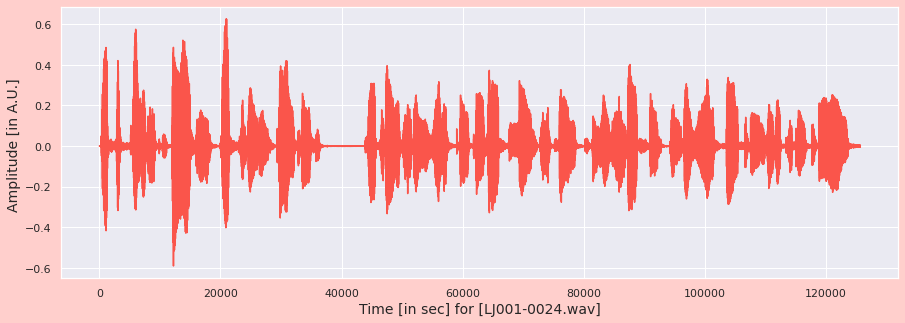


_________________________________________________________________________________________________________



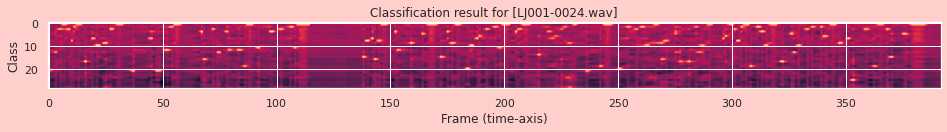

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([21,  0,  0, 13,  0,  3,  1,  1,  3,  3,  8,  2,  0,  1,  0,  0, 17,  0,
         0,  7,  0, 10, 10,  0,  9,  9,  0,  3,  3,  0,  1,  1,  1,  0,  0,  0,
         0, 21,  0,  0,  0,  0,  0,  0,  7,  7,  0, 21, 21,  0,  0, 12, 12,  0,
         2,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4, 16,  0,  0,  0,
         3,  0, 13, 13,  0,  0,  4, 12,  0,  0,  0, 12, 12,  0, 19,  1,  1,  1,
         0,  0, 11,  0,  0,  0,  0,  4,  4,  0,  0,  0,  3,  0,  0,  0,  2,  2,
        11,  0,  1,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 15,  8,  8,  0,  7, 16,
         0,  8,  1,  1,  1,  0,  0,  0,  4, 12,  0,  0,  0,  0,  0,  9,  0,  0,
         0,  0,  5,  0,  0,  1,  1,  1,  0,  0, 15,  0,  0,  4,  0,  9,  0,  1,
         1,

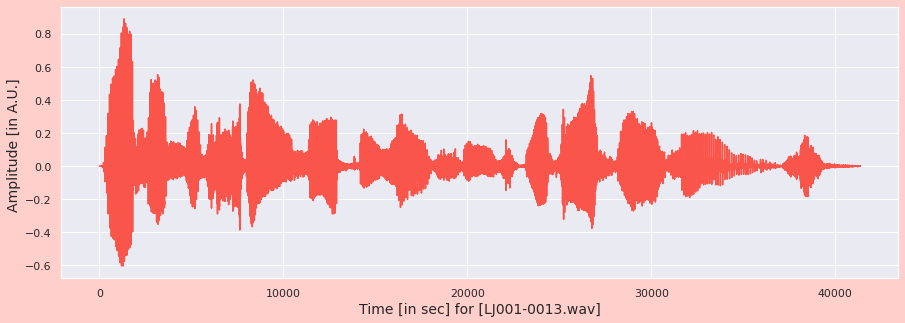


_________________________________________________________________________________________________________



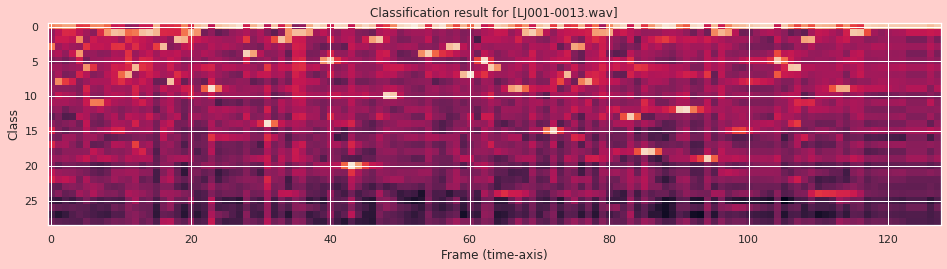

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  4,  6,  0,  0,  1,  1,  1,  7,  6,  1,  1,  1,  3,  8,
         2,  2,  1,  0,  0,  9,  0,  0,  0,  0,  4,  0,  0, 14,  0,  2,  0,  1,
         1,  0,  0,  0,  5,  0,  0, 20,  0,  0,  0,  2, 10, 10,  0,  0,  0,  0,
         4,  0,  0,  3,  3,  7,  7,  0,  5,  6,  0,  0,  9,  9,  1,  1,  0,  0,
        15,  0,  7,  3,  0,  8,  1,  1,  1,  0,  0, 13,  0, 18, 18,  0,  0,  0,
        12, 12,  0,  0, 19,  0,  1,  1,  0,  0,  0,  0,  0,  0,  5,  0,  6,  6,
         2,  2,  0,  0,  0,  9,  9,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0])

Merge repeats  tensor([ 0,  4,  6,  0,  1,  7,  6,  1,  3,  8,  2,  1,  0,  9,  0,  4,  0, 14,
         0,  2,  0,  1,  0,  5,  0, 20,  0,  2, 10,  0,  4,  0,  3,  7,  0,  5,
         6,  0,  9,  1,  0, 15,  0,  7,  3,  0,  8,  1,  0

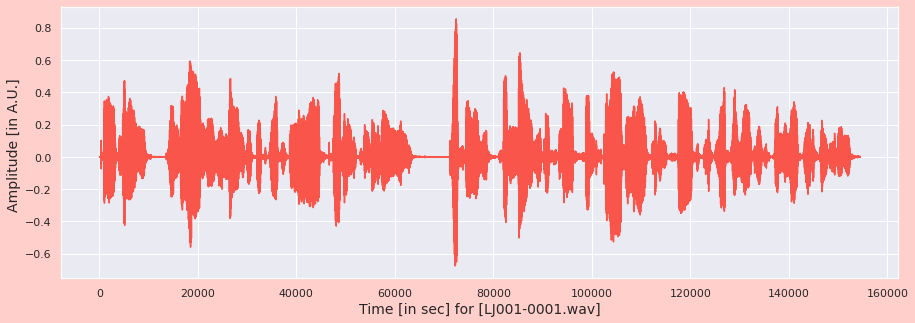


_________________________________________________________________________________________________________



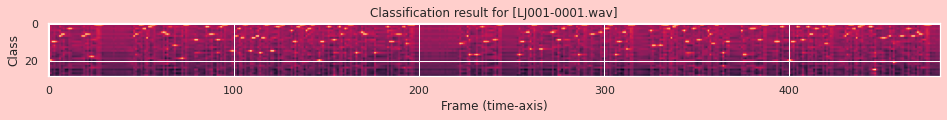

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0, 20, 10, 10,  0,  0,  7,  6,  6,  0,  0,  3,  3,  0,  0,  0,  0,  0,
         7,  7,  6,  6,  0, 18,  0,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  6,  0,  1,  1,  3,  3,  8,
         2,  2,  1,  1,  0,  0,  0,  0,  5,  0,  6,  0,  0,  0, 12,  0,  0,  0,
        19,  1,  1,  1,  0,  0,  0,  9,  9,  0,  0,  0,  0,  2,  2,  6,  6,  0,
         0,  9,  9,  2,  1,  1,  1,  0,  0, 15,  0,  7,  0,  3,  8,  8,  1,  0,
         0, 15,  8,  8,  7,  7, 16,  8,  8,  1,  1,  0, 15, 15,  0,  0,  2,  0,
         1,  1,  0,  0,  0,  4,  0, 10,  0,  2,  1,  1,  0,  4,  3,  3,  1,  1,
         0,  0, 20, 10, 10,  0,  0,  2,  0,  0,  9,  0,  0,  2,  6,  0,  3,  0,
         1,  1,  0,  0, 16,  0,  0,  5,  6,  6,  0,  0,  0,  0, 16,  0,  0,  0,
         0,

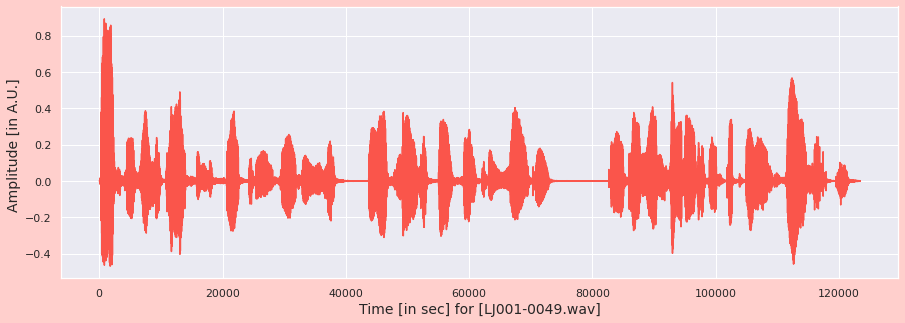


_________________________________________________________________________________________________________



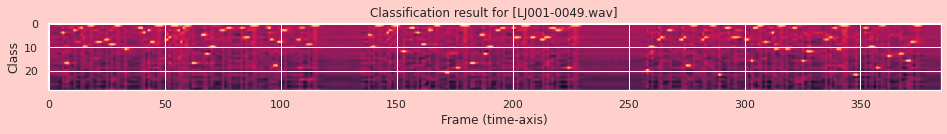

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  4, 17, 17,  0,  0,  3,  0,  0,  2, 10, 10,  0,
         1,  1,  0,  8,  8,  0,  0,  7,  0,  9,  0,  1,  1,  0,  0, 11,  0,  0,
         0,  0,  0,  2,  2,  4,  0,  3,  8,  8,  1,  1,  1,  0,  0,  7,  6,  1,
         1,  1,  3,  8,  2,  1,  1,  0, 17, 17,  0,  0,  5,  5, 13,  0, 10, 10,
         0,  0,  0,  3,  0,  2,  2,  0,  0,  0,  0,  2,  0,  6,  6,  0,  1,  1,
         0,  0,  0,  0,  0,  2,  7, 18, 18,  8,  8,  3,  3,  0,  0,  0,  0,  0,
         7,  2,  0,  0,  9,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  5,  0, 10,  0,  1,  1,
         0,  0,  4,  3,  0,  1,  1,  0,  0, 12,  0,  0,  2,  2,  0,  4,  0,  9,
         9,  0,  3,  0,  0,  1,  1,  0,  0,  0, 21,  0,  0,  0, 19,  0,  1,  1,
         1,

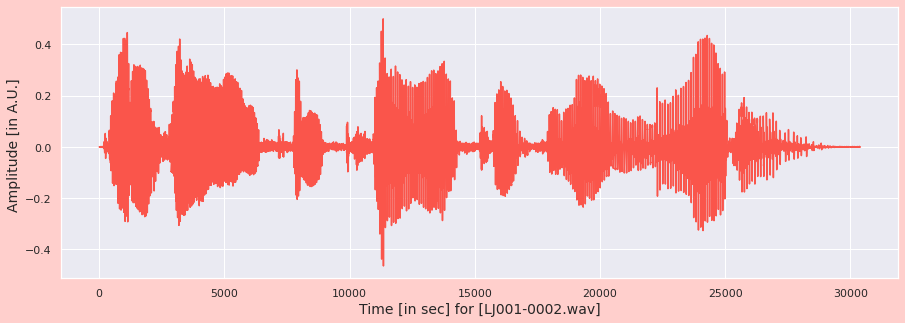


_________________________________________________________________________________________________________



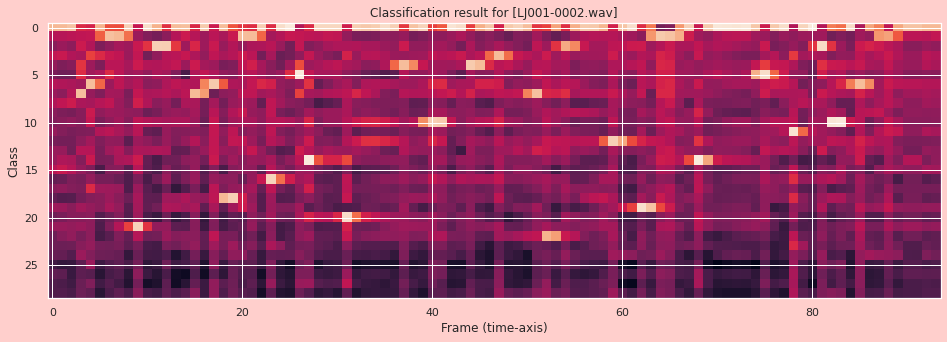

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  7,  6,  0,  1,  1,  0, 21,  0,  2,  2,  0,  0,  7,  0,  6,
         0, 18,  1,  1,  0, 16,  0,  0,  5, 14,  0,  0,  0, 20,  0,  0,  0,  0,
         0,  4,  0,  0, 10, 10,  0,  0,  4,  4,  0,  3,  0,  0,  0,  7, 22,  0,
         2,  0,  0,  0,  0, 12,  0,  0, 19, 19,  1,  1,  1,  0, 14,  0,  0,  0,
         0,  0,  0,  5,  0,  0, 11,  0,  0,  2, 10, 10,  0,  6,  0,  1,  1,  0,
         0,  0,  0,  0])

Merge repeats  tensor([ 0,  7,  6,  0,  1,  0, 21,  0,  2,  0,  7,  0,  6,  0, 18,  1,  0, 16,
         0,  5, 14,  0, 20,  0,  4,  0, 10,  0,  4,  0,  3,  0,  7, 22,  0,  2,
         0, 12,  0, 19,  1,  0, 14,  0,  5,  0, 11,  0,  2, 10,  0,  6,  0,  1,
         0])

labels ['I', 'N', '|', 'B', 'E', 'I', 'N', 'G', '|', 'C', 'O', 'M', 'P', 'A', 'R', 'A', 'T', 'I', 'V', 'E', 'L', 'Y'

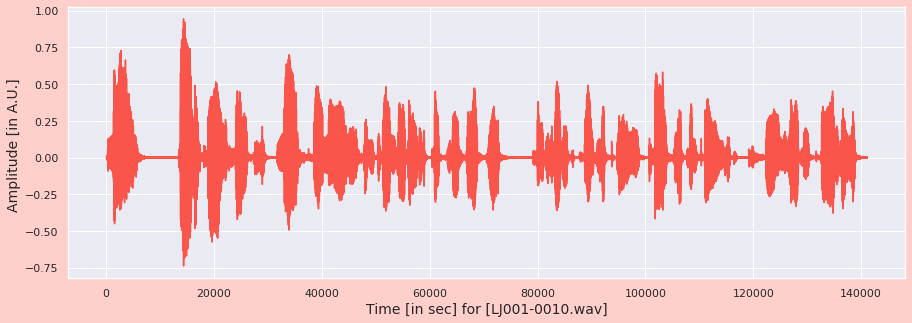


_________________________________________________________________________________________________________



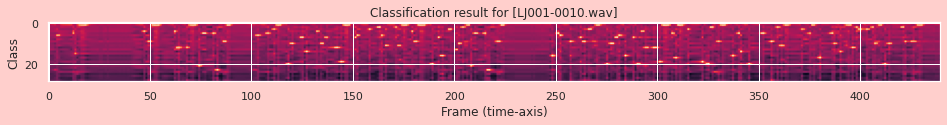

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  6,  6,  0,  0,  0,  0,  0,  0,  5, 15,  0,  1,  1,  1,
         1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,  0,  9,  9,  1,  1,  1,
         1,  0,  0,  0,  0,  0,  0,  0,  4, 12, 12,  0,  0,  0, 12,  0,  1,  1,
         1,  0, 21,  0,  5,  5,  0,  0,  0,  5,  0, 23,  0,  0,  9,  9,  1,  1,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  6,  0,  0,  0,  0,
         5,  0,  0,  3,  0,  1,  1,  0,  0,  0, 20, 10, 10,  0,  0,  0,  7,  7,
         0, 14,  0,  0,  0,  0,  4,  0, 10, 10,  0,  7,  0,  0,  0, 12, 12,  0,
        19, 19,  1,  1,  1,  0,  0,  7,  6,  0,  0,  0,  0,  0,  3,  0,  0,  0,
         2,  2,  6,  0, 11,  0,  0,  0,  0,  2, 11, 11,  1,  1,  1,  0,  0,  4,
         9,

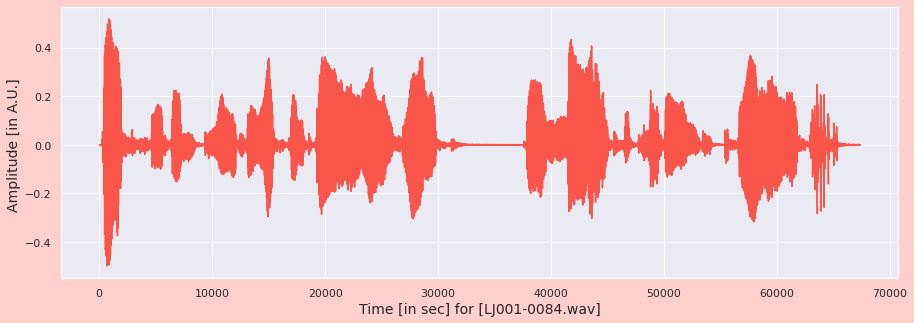


_________________________________________________________________________________________________________



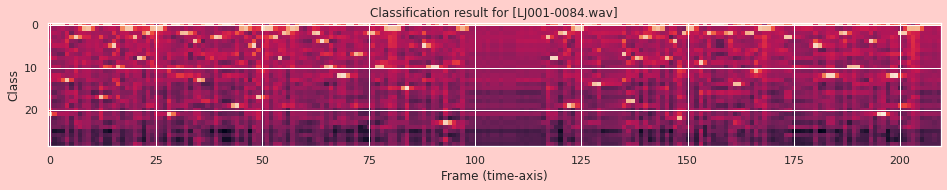

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([21,  0,  0,  0, 13,  0,  3,  0,  1,  1,  0,  0, 17,  0,  0,  5, 10,  0,
         1,  1,  3,  8,  0,  2,  1,  1,  1,  0, 21,  0,  0,  2,  2,  0,  4, 13,
         0,  0,  0,  3,  3,  0,  0,  0, 19,  1,  1,  0,  5, 17,  1,  1,  1,  3,
         8,  2,  2,  1,  1,  0,  0,  0,  2,  2,  4, 10, 10,  0, 12, 12,  0,  0,
         7,  0,  0,  0,  2, 10, 10,  1,  1,  1,  1,  0, 15,  0,  0,  0,  5,  0,
        10, 10,  0, 23,  0,  0,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  8,  8,  0,  2, 19,  0,  1,  1,
         0,  0, 14, 14,  0,  0,  0,  0,  0,  7, 18, 18,  8,  0,  3,  0,  1,  1,
         0,  8,  0,  4, 22,  2,  1,  1,  0,  9,  0,  2,  0,  0,  0,  0,  2, 14,
        14,  0,  2,  2, 11,  1,  1,  1,  0,  0,  0,  3,  3,  0,  0,  0,  0,  0,
         5,

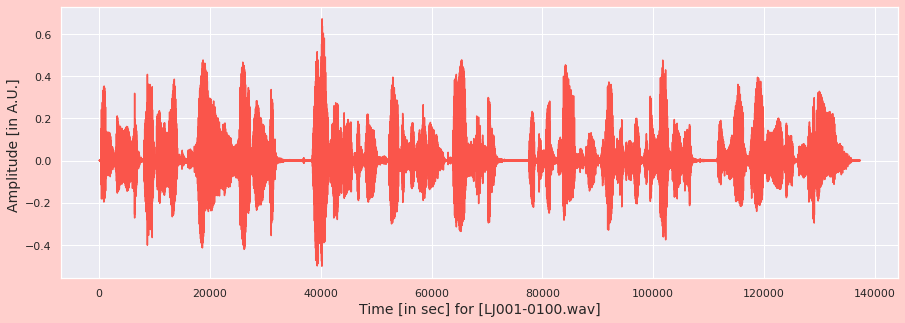


_________________________________________________________________________________________________________



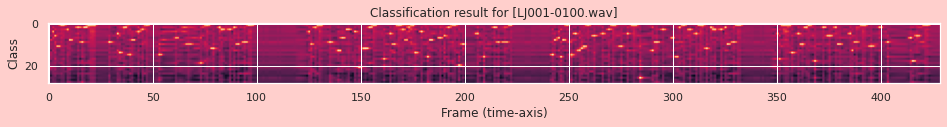

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  4,  6, 11, 11,  1,  1,  0,  3,  8,  8,  0,  0,  2,  0,  9,  2,
         2,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  9,  0,  0,  0,  5, 14,  0,
         2,  2,  0, 15,  8,  8,  0,  4,  0,  3,  0,  1,  0,  0,  0,  0,  0, 15,
         0,  0,  0,  0,  0,  0,  0,  7,  0,  0,  0,  0, 10, 10, 10,  0,  0,  0,
         0, 19,  0,  1,  1,  0, 12, 12,  0,  0,  2,  3,  3,  0,  0,  3,  0,  2,
        10, 10,  0,  0,  9,  9,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,
        10,  0,  2,  1,  1,  1,  0,  0,  0,  9,  0,  0,  0, 13, 13,  7,  7,  3,
         3,  0,  0,  4,  0, 21, 21, 12, 12, 12,  2,  2,  1,  1,  0,  0,  0, 17,
         0,  0,  5, 10, 10,  0,  1,  1,  3,  8,  8,  2,  1,  1, 14,  0,  0,  4,
         0,

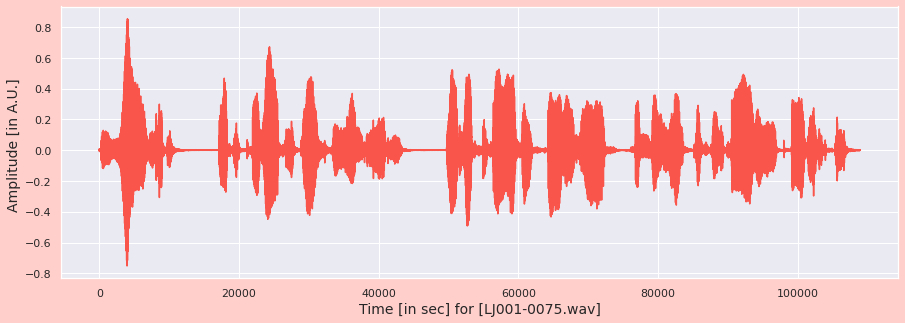


_________________________________________________________________________________________________________



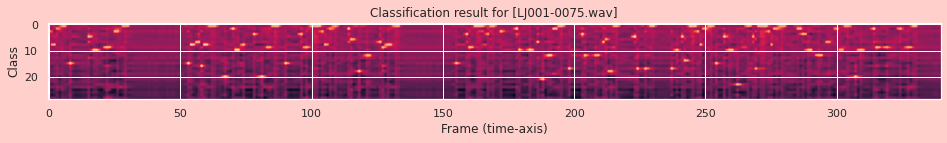

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  8,  2,  0,  1,  1,  0, 15,  0,  0,  0,  0,  0,  0,  5,  0, 10,
        10,  0,  0,  0,  9,  9,  0,  3,  3,  0,  1,  1,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 15,
         8,  0,  7,  7, 16,  8,  8,  1,  1,  1,  0,  0,  0, 20,  0,  0,  2, 10,
        10,  0,  8,  0,  0,  0,  4,  0,  0, 20,  0,  9,  9,  1,  1,  1,  0,  0,
        15,  0,  0,  0,  0,  0,  4,  0,  9,  0,  1,  1,  1,  1,  3,  8,  0,  2,
         1,  1,  0,  0,  0,  0,  2,  6,  0,  0, 18,  0,  0, 12, 12,  0,  0,  0,
         7,  9,  0,  8,  8,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 15,  0,  0,  0,  4,  9,  9,
         1,  1,  1,  1,  0,  4,  1,  1,  0,  0,  3,  0,  0,  0,  0,  0,  2, 10,
         0,

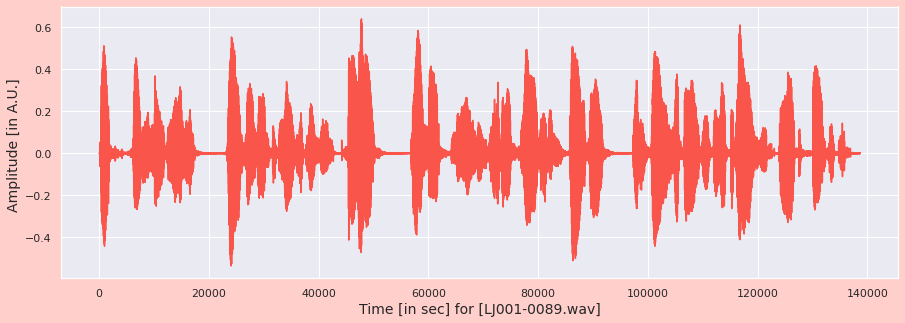


_________________________________________________________________________________________________________



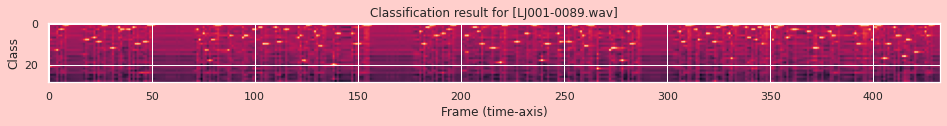

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([21,  0,  0,  0, 13,  0,  3,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,
         8,  8,  0,  0,  7,  0,  9,  0,  1,  1,  0,  0,  0, 12,  0,  0,  2,  3,
         0,  0,  0,  3,  0,  2,  0, 10,  0,  0,  9,  9,  1,  1,  1,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         3,  8,  0,  5, 13,  0, 18,  8,  8,  1,  1,  1,  0,  0,  0, 13,  6,  0,
         0,  0,  0,  0,  7,  6,  6,  0,  0,  3,  3,  0,  2,  2, 10, 10, 10,  0,
         0,  0,  2,  9,  9,  0,  0,  3,  0,  0,  0,  0,  0,  7,  6,  0, 18,  1,
         1,  0,  0,  4,  6,  0, 11,  1,  1,  0,  0,  0, 20,  0,  5,  5,  0,  0,
         0,  0,  0,  5,  0, 10, 10, 10,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         4,

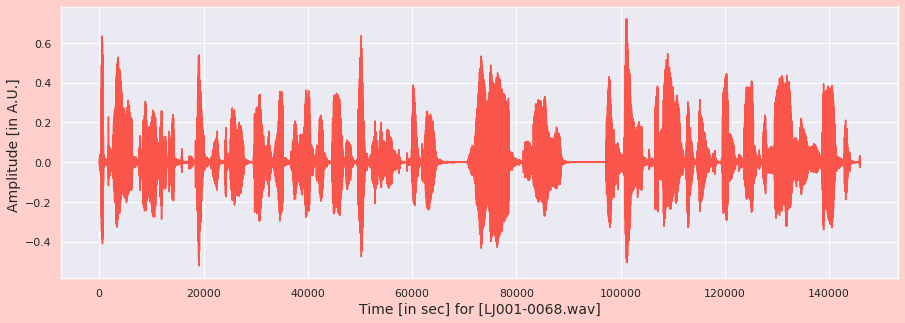


_________________________________________________________________________________________________________



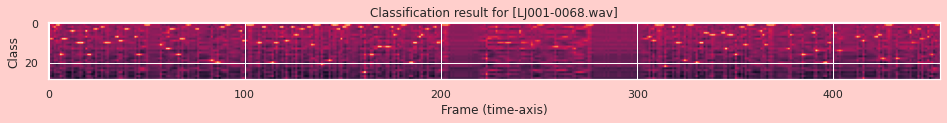

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  0,  2,  1,  1, 16,  8,  8,  0,  0,  0,  4,  0,  0, 10, 10, 10,
         0,  4, 16, 16,  0,  0,  3,  0,  0,  2,  0, 10, 10,  0,  0,  0,  0,  7,
         9,  9,  0,  3,  3,  0,  0,  0,  7,  0, 16,  0,  0,  1,  1,  1,  0,  0,
         0,  0,  0, 11,  0,  0, 13, 13,  3,  3,  0,  0, 16,  8,  8,  0,  0,  1,
         0,  0,  0,  0,  3,  0,  0,  0,  0,  0,  0, 19,  0,  0, 20,  0,  2,  2,
         0,  1,  0,  0,  0,  0,  0,  0,  4,  9,  9,  1,  1,  1,  0,  0,  0, 10,
         0,  2,  2,  0,  0,  0, 20,  0, 10,  0,  0,  2,  0,  9,  0,  0,  2,  0,
         6,  0,  0,  3,  0,  0,  2,  2, 11,  0,  1,  1,  0, 21,  0,  0,  0, 19,
         0,  1,  1,  1,  3,  8,  2,  2,  1,  1,  0,  0,  0,  0,  0,  2,  0, 25,
         0,  0, 16, 16,  2,  2, 12, 12,  0,  0, 12, 12,  0,  2,  6,  0,  3,  0,
         1,

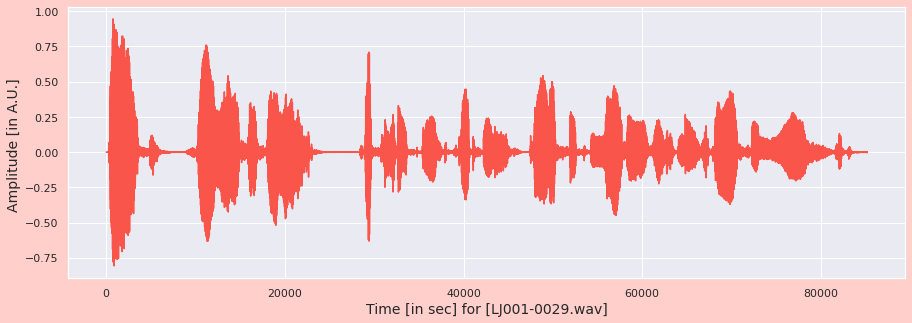


_________________________________________________________________________________________________________



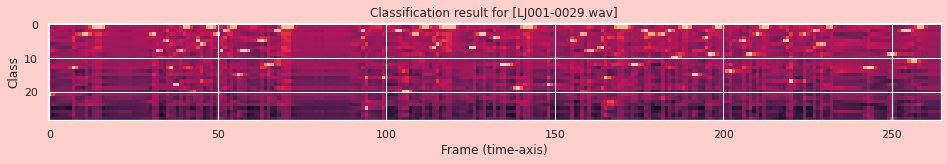

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([21,  0,  0,  0,  0,  0,  0, 13,  0,  0,  3,  3,  0,  1,  1,  1,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  8,  0,  0,  5,
        13, 18, 18,  8,  1,  1,  0,  0,  5,  6,  0,  1,  1,  0,  3,  8,  2,  0,
         1,  1, 15,  8,  8,  0,  0,  0,  0,  5,  0, 12,  0,  2,  2,  1,  1,  1,
         1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  2, 25,  0,  0,  0,  0, 16,  0,  0,  0,  2,  2, 20, 20,  0,
         3,  3,  0,  1,  1,  0,  7,  6,  0,  1,  1,  1,  1,  0,  0,  0,  0,  7,
         7,  0,  3,  3,  0,  0,  4,  0, 12, 12, 12,  0,  0, 19,  0,  1,  1,  1,
         0,  0,  0,  0, 18,  0,  0,  0,  0,  0,  0,  5,  0,  0,  3,  3,  8,  8,
         0,  0,  7, 16,  0,  0,  1,  1,  1,  1,  0, 12, 12,  0,  0,  2,  3,  0,
         0,

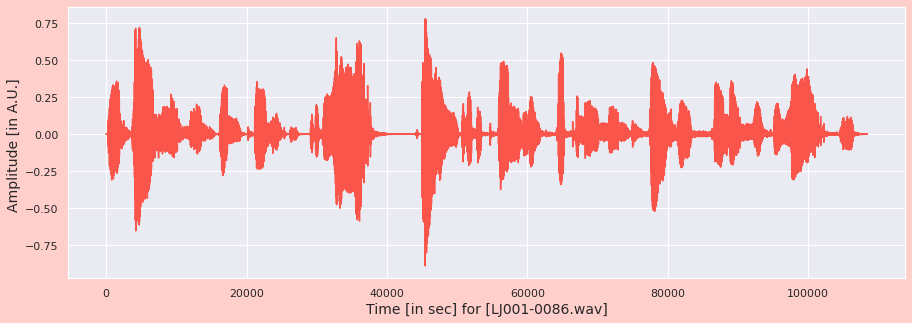


_________________________________________________________________________________________________________



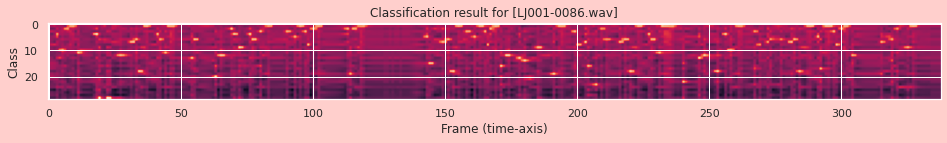

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  4, 10, 10,  2,  2,  1,  1,  0, 11,  0,  0,  0,  0,  0,  4,
         4, 28,  0,  0, 28, 28,  0,  0,  0, 12,  0,  0,  0,  7,  7,  6, 18, 18,
         1,  1,  0,  0,  0,  4,  6,  0, 11,  1,  1,  1,  0,  0,  0,  0,  0,  0,
        13,  6,  6,  0,  0,  0,  0,  0,  0, 20,  0, 12, 12,  0,  0,  2,  4,  4,
         9,  9,  0,  0,  4,  6,  6,  0,  3,  0,  0,  1,  0,  0,  0,  0,  0,  0,
         3,  3,  0,  5,  0,  1,  0,  3,  8,  0,  2,  1,  1,  1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  2, 19,  2,  2,  1,  1,  1,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  5,
        15, 15,  0,  0,  0,  7,  0,  6, 18, 18,  1,  1,  1,  0,  3,  3,  0,  5,
         0,  1,  1,  3,  8,  2,  1,  1,  1, 16,  0, 12, 12,  0,  0,  0, 13,  0,
        14,

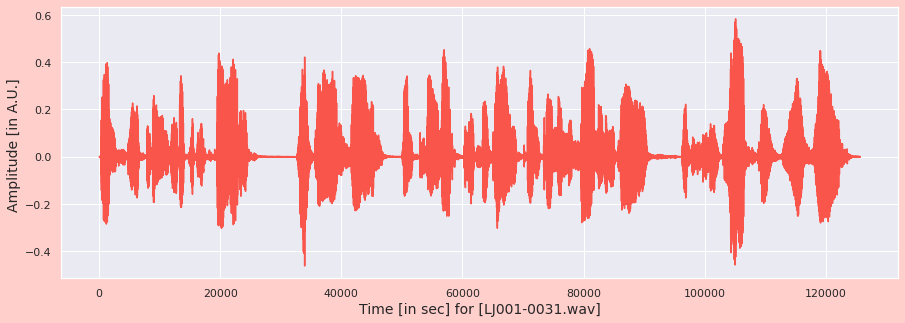


_________________________________________________________________________________________________________



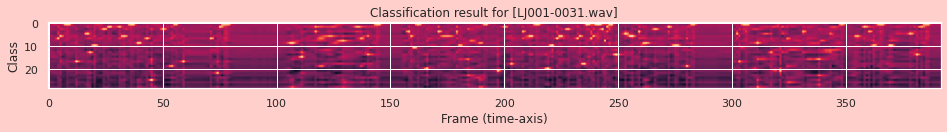

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  7,  6,  0,  1,  1,  1,  0,  0, 17,  0,  0,  0,  5,  5,
        13,  0, 10,  0,  0,  0,  3,  0,  2,  2,  0,  0,  0,  2,  6,  6,  0,  0,
         1,  1,  0,  9,  9,  0,  0,  7,  0, 25,  0,  0,  0,  0,  3,  0,  0,  0,
        19,  1,  1,  0,  0, 17,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,
         0,  0, 22,  2,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  9,  9,
         0,  0,  0, 15,  0,  0,  0,  0,  0,  4,  0,  0, 19,  0,  0,  6,  6,  0,
         0,  0,  0,  8,  0,  0,  0,  0,  0,  2,  2,  7,  0,  0, 14,  0,  0,  1,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,  6, 11, 11,
         1,  0,  0,  0, 20,  0,  0,  0,  0,  4,  0,  0,  6,  6,  6,  0,  0,  4,
        10,

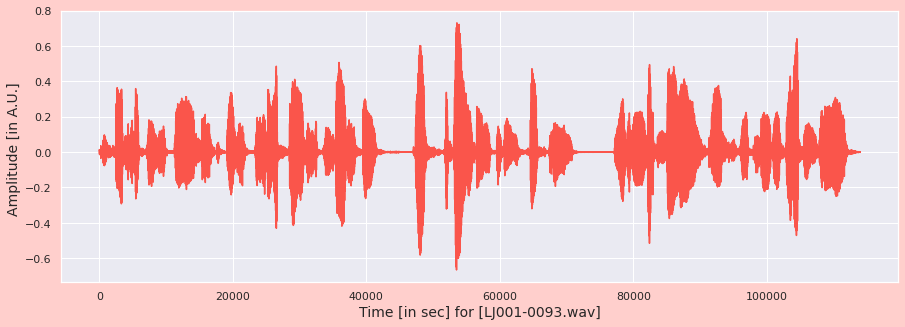


_________________________________________________________________________________________________________



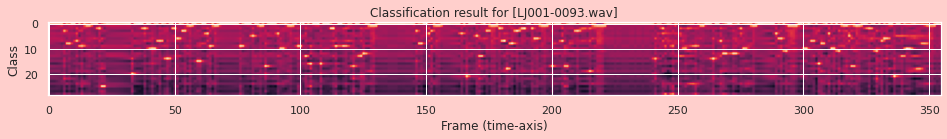

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  3,  8,  8,  0,  0,  7,  0,  9,  0,  1,  1,  0,
         0,  0,  2, 25, 25,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 20,  0,  0,
         0,  0,  2,  0,  0, 10, 10,  0,  7,  0,  0, 14,  0,  0,  2,  6,  0,  3,
         3,  0,  1,  0,  0, 15, 15,  0,  0,  4,  9,  0,  1,  1,  0,  0,  0,  0,
         0,  0,  0,  0,  9,  9,  0,  0,  0,  5,  0,  0,  1,  1, 17,  0,  0,  0,
         0,  4, 10, 10,  0,  1,  1,  0,  0,  9,  9,  0, 13,  0, 16,  0,  0,  0,
        16,  0,  0,  0,  2,  2,  9,  0,  0,  9,  9,  0,  0, 17,  0,  0, 13, 12,
         0,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  3,  8,  8,  0,  0,  4,  3,  0,  1,  1,  0,  0,  0,  0,  0,  0,
         0,  0,  4,  0, 21,  0,  0,  0,  5, 13, 13,  0,  3,  3,  1,  1,  1,  2,
         7,

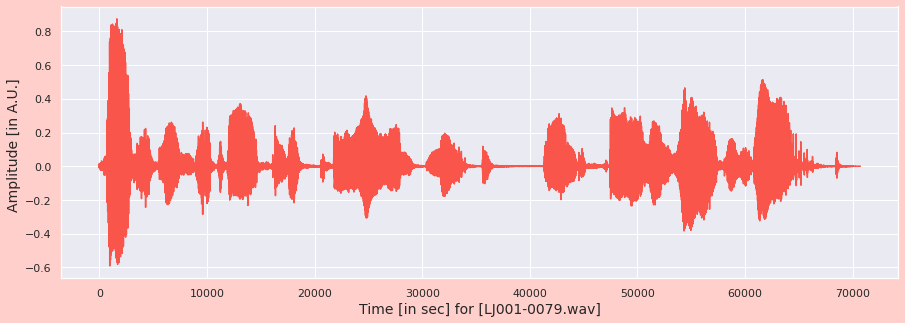


_________________________________________________________________________________________________________



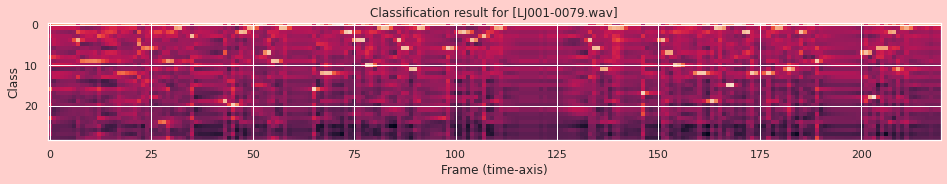

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([16,  0,  0,  0,  0,  0,  0,  4,  0,  9,  9,  9,  9,  0,  0,  0,  0, 12,
         0,  0,  0,  0,  5,  0,  6,  0,  0,  0, 24,  9,  0,  1,  1,  0,  0,  3,
         0,  0,  0,  0,  0,  0,  0, 19,  0, 20,  0,  2,  2,  1,  1,  0,  0,  0,
         7,  9,  9,  1,  1,  0,  0,  0,  0,  0,  0, 16,  0,  0, 12, 12,  0,  0,
         0,  2,  2,  0,  4,  4, 10, 10,  0,  0,  1,  1,  0,  0,  4,  6,  6, 11,
        11,  1,  1,  0,  0,  0,  0,  0,  6,  0,  0,  0,  2,  0,  4,  0,  0,  3,
         0,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  4,  6,  6,  0, 11,  1,  1,  1,  1,  0,  0,
         0,  0, 17,  0,  0,  0,  0,  4,  7,  7, 10, 10,  0,  0,  0,  0, 12, 12,
         0, 19,  1,  1,  0, 15, 15,  0,  0,  2,  2, 12,  0,  0,  0, 12,  0,  1,
         1,

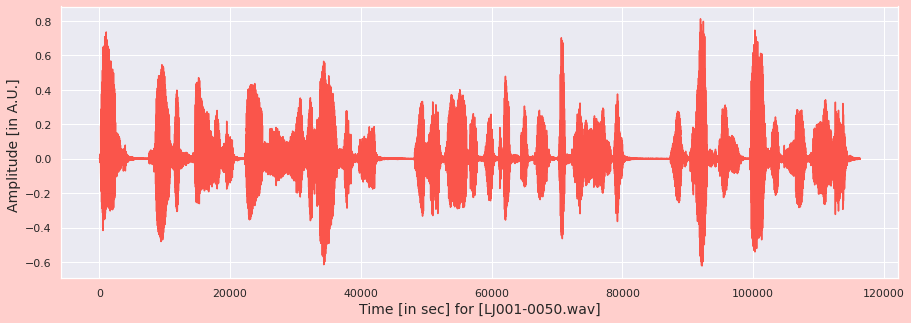


_________________________________________________________________________________________________________



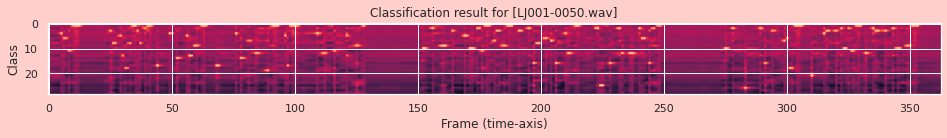

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  4,  6,  0, 11,  0,  1,  1,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  3,  8,  0,  0,  5, 13, 18,  0,  8,  1,  1,
         3,  8,  0,  2,  1,  1,  0,  0, 17,  0,  0,  0,  0,  4,  0,  0, 14,  0,
         0,  0,  5, 13, 13,  9,  9,  0,  1,  1,  0,  0,  0,  0, 17, 17,  0,  0,
         0,  0,  0,  0,  4,  0, 14,  0,  0,  7,  0,  0, 12, 12,  0,  0,  0, 19,
         0,  1,  1,  1,  0,  0,  5, 17,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,
         0,  4,  0,  0, 12,  0,  0,  0, 11,  0,  0,  0,  0,  5,  0,  0,  0,  9,
         0,  0,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0, 10, 10,  0,  0,  2,  0,  0,  9,  9,  9,
         0,  0,  3,  0,  0,  0,  0,  5,  0, 10, 10,  0,  2,  2, 11,  1,  1,  1,
         0,

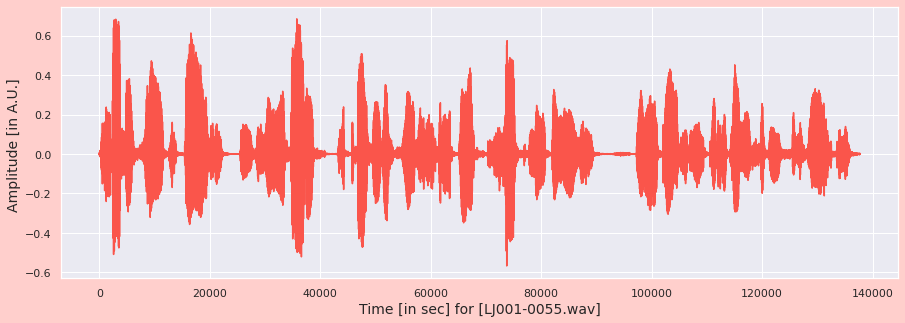


_________________________________________________________________________________________________________



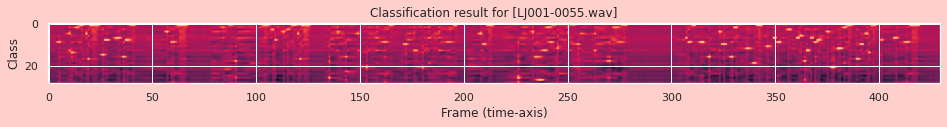

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  9,  0,  0,  0,  0,  5, 14,  0,  2,  0,  1,  1,  0,
         5, 17,  1,  1,  1,  1,  0,  0, 15,  8,  8,  0,  0,  0,  0,  7,  7,  0,
        16,  8,  8,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  4,  0,  9,  9,  0,  1,  1,  1,  1,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  2,  0,  0,  1,  1,  0,
        18,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  0,  0,
         3,  8,  0,  0,  0,  4,  0,  3,  0,  1,  1,  1,  5, 17,  1,  1,  1,  1,
         0,  0,  0,  0,  0,  0,  0,  0,  0, 26,  0,  0,  0,  4,  0,  0,  0, 16,
         0,  0,  0,  0,  0,  5,  0,  0,  0, 21,  0,  0,  0,  0,  7,  0,  0,  9,
         9,  0,  1,  1,  0,  0,  0,  0,  0, 10, 10,  0,  0,  0, 13, 13,  0,  0,
        21,

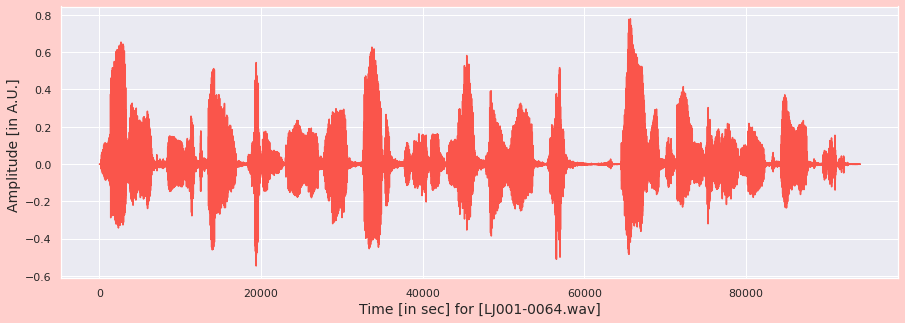


_________________________________________________________________________________________________________



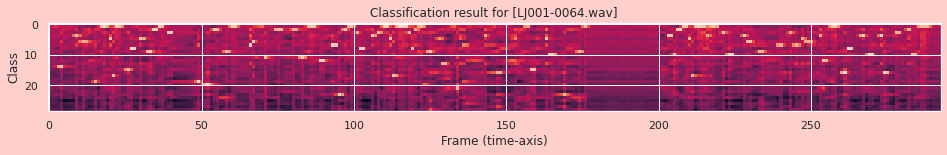

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0, 14,  0,  0,  0,  0,  4,  0,  6,  6,  0,  0, 19,  0,  1,
         1,  1,  5, 17,  1,  1,  0,  0, 15,  8,  8,  0,  5,  0,  9,  9,  2,  2,
         1,  1,  0,  3,  3,  0,  0,  0,  0,  0,  0,  0,  0, 19,  0, 20, 20,  0,
         2,  2,  0,  0,  9,  0,  1,  1,  0,  0,  0,  0,  7,  6,  0,  0,  0, 11,
         0,  0,  0,  2,  0,  0,  0,  0,  2,  0,  0, 11,  0,  1,  1,  1,  0, 12,
        12,  0,  0,  7,  7, 23,  0,  2,  1,  1,  0,  3,  8,  8,  0,  0,  4,  0,
         3,  0,  1,  1,  5, 17,  1,  1,  1,  1,  3,  8,  2,  1,  1,  0,  9,  9,
         0,  0,  5, 13, 13,  0,  0,  0, 21,  0,  7,  0,  0,  0,  0,  0,  0,  4,
         0,  0,  0, 16, 16,  0,  0,  0,  0,  5,  0,  0,  1,  1, 15, 15,  0,  0,
         0,  5, 10, 10,  0,  0,  0, 23,  0,  0,  0,  0,  9,  0,  1,  0,  0,  0,
         0,

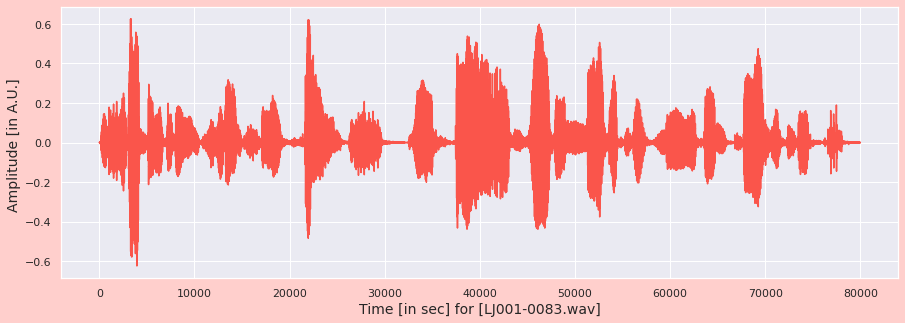


_________________________________________________________________________________________________________



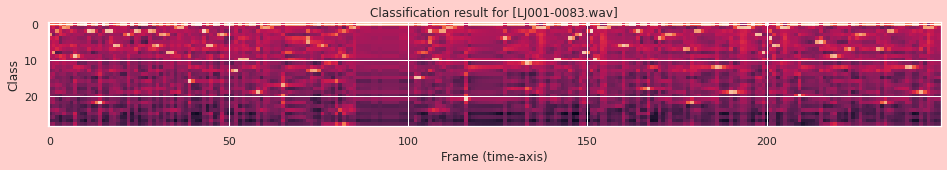

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  2,  0,  1,  0,  0,  9,  0,  0,  0,  2,  2,  0, 22,  0,  2,  2,
         6,  6,  0,  0,  3,  0,  2,  0,  0,  0,  2,  0,  6,  0,  3,  8,  8,  0,
         1,  1,  0, 16,  0,  0,  0,  2,  6,  6,  0,  0,  3,  0,  0,  0, 13, 10,
        10, 10,  0,  0, 19,  0,  1,  1,  0,  0,  0, 17,  0,  0,  0,  0,  0,  0,
         5, 13,  0,  0,  6,  0,  0,  0,  3,  0,  9,  0,  1,  1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 15, 15,  0,  0,  2, 10,
        10,  2,  2,  1,  1,  0,  0,  0, 21,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  4,  0,  0,  0,  0,  0, 11,  0,  0,  1,  1,  1,  0,  0, 10, 10,  0,
         0,  4,  0,  0,  3,  8,  0,  2, 10,  1,  1,  1,  0,  0,  0,  0,  6,  0,
         0,  0,  2,  0,  0, 18,  0,  0,  4,  0,  3,  3,  0,  0,  0,  7,  0, 22,
         2,

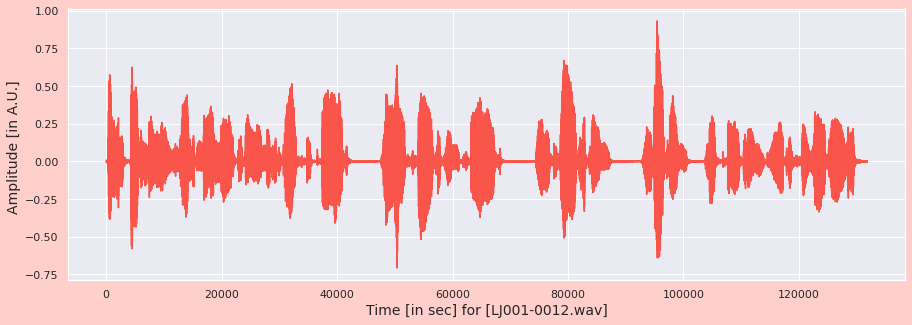


_________________________________________________________________________________________________________



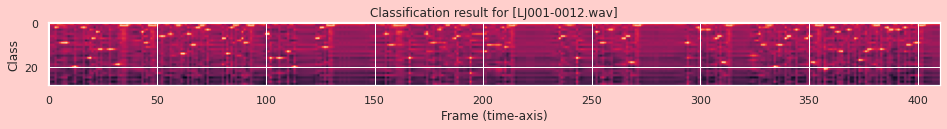

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  2,  0,  0,  9,  9,  9,  0,  0,  0, 20,  0,  0,  0,  2,  0,
         0, 16,  7,  0,  4, 12, 12,  0,  0,  0, 12,  0,  0,  0, 19,  1,  1,  1,
         1,  0,  0,  0,  0,  0,  0,  4,  9,  9,  1,  1,  1,  1,  0,  0,  6,  0,
         0,  0,  5,  0,  0,  1,  1, 14, 14,  0,  5,  0, 10, 10,  2,  2,  1,  1,
         0,  3,  0,  0,  0,  0,  0,  0,  7,  7, 14,  0,  2,  0,  1,  0,  0,  7,
         9,  9,  1,  1,  1,  0,  0,  0,  0,  0,  5,  5, 16,  0,  0,  0, 16,  0,
         0,  0, 13,  0,  0, 20,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  7,  2,
         2, 11,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  5,  0, 10, 10,  1,  1,  1,
         1,  1,  0,  0, 16,  0,  0,  0,  0,  0,  0,  0,  5,  0,  0,  9,  0,  0,
         3,

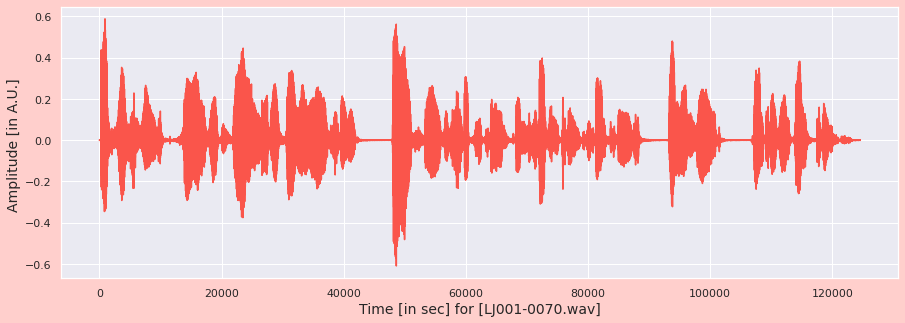


_________________________________________________________________________________________________________



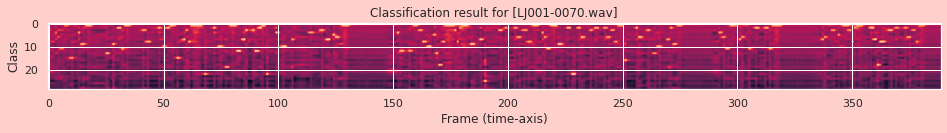

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  4,  6,  0, 11,  1,  0,  0, 15,  0,  0,  4,  9,  9,  0,  1,
         1,  0,  0,  0,  0,  0,  0, 13,  0,  0,  9,  0,  2,  2, 11,  1,  1,  1,
         0,  0,  0,  0,  0,  3,  0,  8,  0,  0,  0,  0,  2,  0, 10,  2,  2,  1,
         1,  0, 15,  0,  0,  7,  3,  8,  1,  1,  1,  1,  1,  0, 22,  0,  0,  0,
         2,  0, 10, 10,  0, 19, 19,  1,  1,  1, 12, 12,  0,  7,  3,  0,  0,  3,
        12, 12,  2,  1,  0, 22,  0,  0,  0,  4,  0,  0, 10, 10,  0,  0,  7,  0,
         0,  0,  0,  0,  0,  0,  4,  0,  0,  0,  0,  3,  0,  7,  7,  0,  5,  6,
         6,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  4, 12, 12,  0,  0, 12,  0,  1,  1,  0,
         3,  8,  8, 10, 10,  0,  5, 13, 18, 18,  8,  1,  1,  1,  1,  3,  8,  2,
         1,

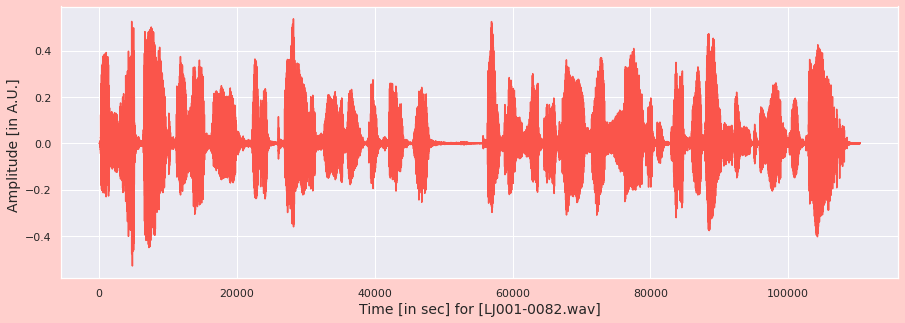


_________________________________________________________________________________________________________



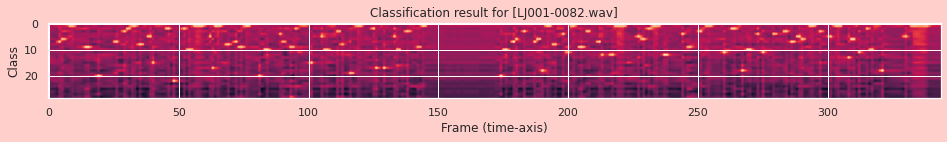

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  7,  6,  6,  0,  1,  1,  0,  0,  0,  0,  9,  9,  0,  0,
         0, 20,  0,  0,  0,  0,  0,  7,  7,  0,  0,  3,  2,  2,  1,  1,  0,  8,
         0,  0,  5,  5, 15,  0,  0,  0,  0,  2,  2,  0, 22,  0,  0,  0,  2,  0,
        10, 10,  1,  1,  1,  1,  0,  0,  5, 17,  1,  1,  1,  0,  8,  8,  0,  0,
         7,  9,  9,  0,  1,  1,  0,  0,  0, 20,  0, 10, 10,  0,  0,  0,  0,  4,
         7,  0,  0,  9,  9,  2,  0,  0,  0,  0,  0, 15,  0,  0,  0,  5, 10, 10,
         0,  0,  0,  3,  3,  8,  0,  0, 19, 19,  0,  1,  1,  0,  0,  0,  0,  2,
        17,  0,  0, 17,  0,  0,  0,  5, 10, 10,  0,  0,  3,  0,  0,  0,  9,  9,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 20, 10, 10,  0,  0,  7,
         6,

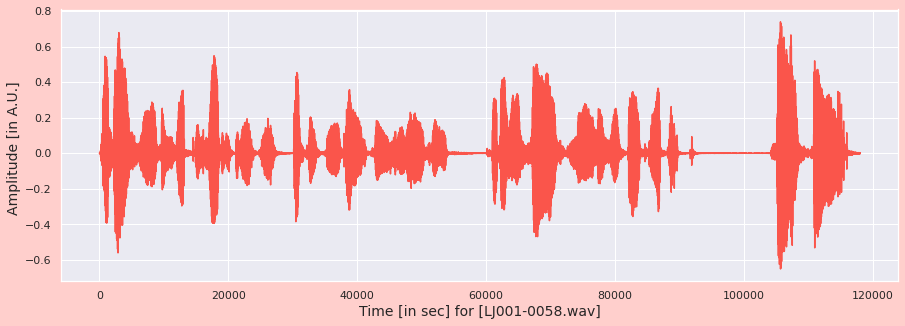


_________________________________________________________________________________________________________



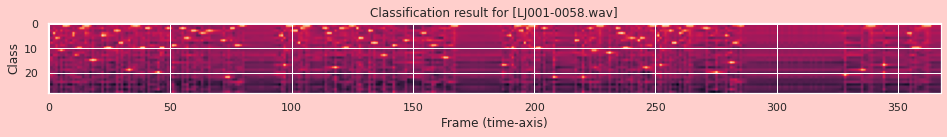

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  4,  6,  0, 11,  1,  1,  0,  0,  4,  0, 10,  2,  2,  1,  1,  0,
        15,  0,  0,  0,  5,  0, 10, 10,  0,  0,  3,  8,  8,  0,  0, 19,  0,  1,
         1,  0, 10, 10,  0,  2,  0,  0,  0, 20, 10, 10,  0,  2,  0,  9,  0,  0,
         0,  2,  6,  6,  0,  3,  3,  0,  0,  4,  0,  0,  3,  0,  0,  0,  0,  0,
         7, 22, 22,  2,  2,  9,  9,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  5, 17,  0,  1,  1,  3,  3,  8,  2,  1,  1,  1,
         0,  0,  0,  0,  0,  0,  2,  4,  4,  0, 18,  0,  2,  2, 10, 10,  0,  1,
         0,  2,  6,  6,  0,  0,  3,  8,  8,  0,  0,  0, 13,  0,  0,  0,  9,  0,
         0,  0,  0,  7,  0,  0,  0,  0,  0,  0,  4,  4,  0,  0,  9,  9,  0,  0,
         0, 14, 14,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,

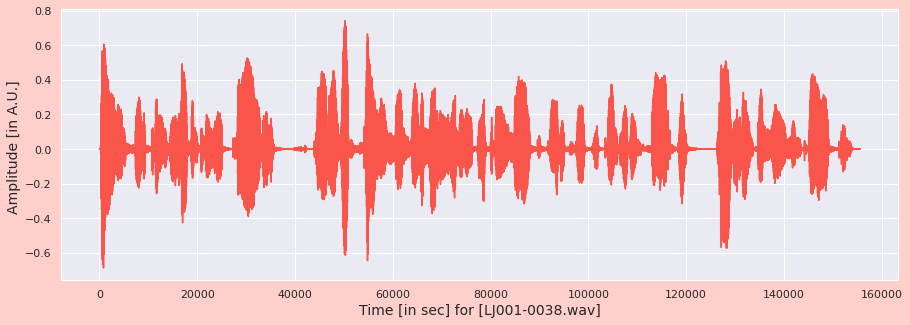


_________________________________________________________________________________________________________



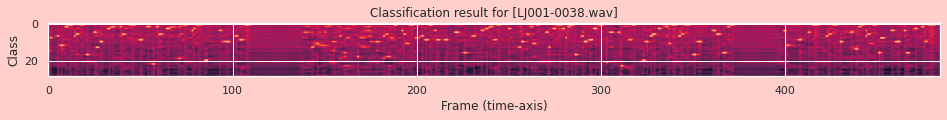

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([15,  8,  0,  0,  0,  7,  0, 12, 12,  2,  2,  1,  1,  1,  7,  6,  6,  1,
         1,  0,  0, 17,  0,  0,  0,  5, 13, 13, 10, 10,  0,  0,  0,  3,  0,  2,
         0,  0,  0,  2,  6,  6,  0,  0,  0,  1,  1,  0,  0,  0,  9,  0,  0,  0,
         2,  0,  0, 22,  0,  2,  6,  6,  0,  0,  3,  3,  0,  0,  0,  0,  0, 19,
         0,  1,  1,  1,  0,  0,  4,  3,  0,  1,  1,  0,  0, 20, 20,  0,  0,  0,
         0,  0,  0,  4,  0,  0, 10, 10, 10,  0,  0,  0,  7,  0,  9,  9,  0,  1,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 13,
         0,  0, 11,  0,  0,  0,  5,  0,  0,  0,  0, 10,  0,  0,  7,  0,  0, 16,
         8,  0,  0,  1,  0,  0, 18,  0,  0,  0,  0,  0,  2, 10,  0,  0, 10, 10,
         0,

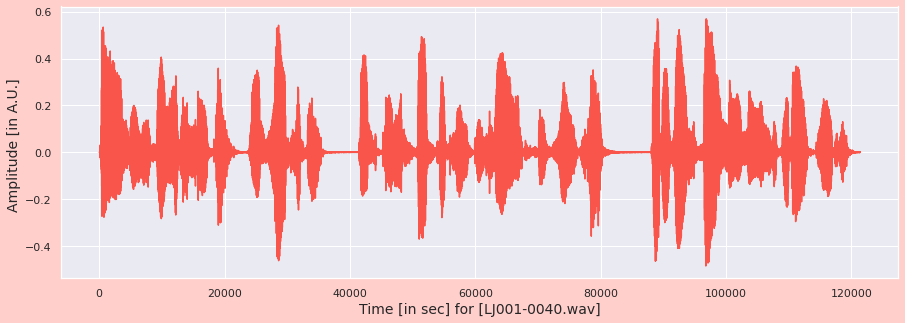


_________________________________________________________________________________________________________



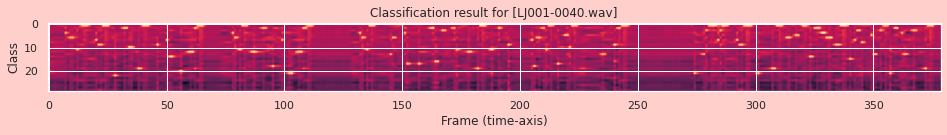

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  0,  4,  0,  6,  6,  0, 11,  0,  1,  1,  1,  0,
         0,  0,  7,  9,  9,  1,  1,  1,  0,  0, 22,  0,  0,  0,  2,  2, 10, 10,
         0,  0, 19, 19,  1,  1,  1,  0,  0,  0,  9,  0,  0,  0,  7, 14, 14,  0,
         0,  0, 20,  0,  0,  0, 12, 12,  2,  1,  1,  1,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  4,  6,  0, 11,  1,  1,  1,  0, 12, 12,  0,  0,
         0,  2,  2,  0,  0, 18,  0,  0,  0,  7,  0,  0, 21, 21,  0,  0, 12, 12,
         2,  2,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  4,  6,  0, 11,  1,  1,  1,  0,  0,  0,  0,  0,
         0, 13,  6,  0,  0,  0,  0,  4, 17,  0,  0,  0,  0, 17,  0,  0,  0,  0,
         2,  2, 16, 16,  0,  3,  3,  0,  0,  0,  2, 11,  0,  0,  0,  0, 12, 12,
         0,

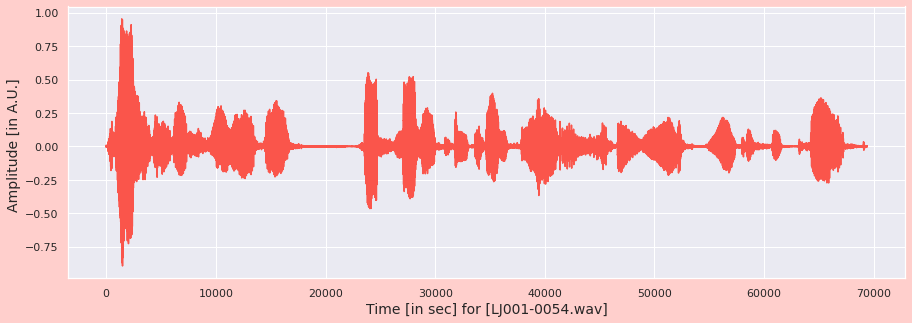


_________________________________________________________________________________________________________



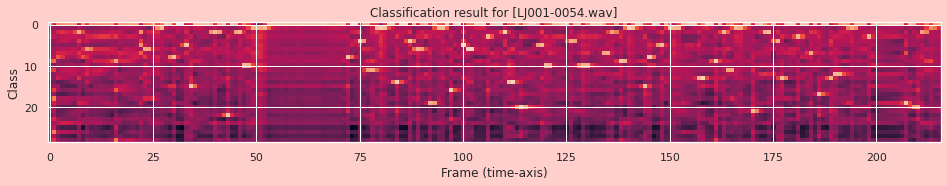

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0, 18,  0,  0,  0,  0,  0,  2,  0,  6,  0,  0,  0,  0,  0,  0,  9,  0,
         0,  0,  0,  0,  2,  6,  6,  0,  1,  1,  0,  0,  8,  0,  0,  5, 15,  0,
         0,  0,  0,  0,  2,  0,  0, 22,  0,  0,  2, 10, 10,  1,  1,  1,  1,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         8,  0,  0,  4,  0,  0, 11,  1,  1,  1,  0,  0, 14,  0,  0,  4,  0,  6,
         0,  0, 19, 19,  1,  1,  0, 16,  0,  0,  5,  6,  6,  0,  0,  0,  3,  0,
         0,  0,  2, 14, 14,  0, 20,  0,  0,  0,  0,  5, 10, 10,  0,  0,  0,  0,
         4,  0,  0, 10, 10,  0,  0,  0,  7,  7,  2,  0,  9,  9,  1,  1,  0,  0,
        15,  8,  0,  0,  5,  0,  1,  1,  1,  0,  0,  0,  0, 13, 13,  0,  0,  9,
         0,  2, 11, 11,  1,  1,  0,  0, 21,  0,  0,  2,  2,  0,  4, 13,  0,  0,
         0,

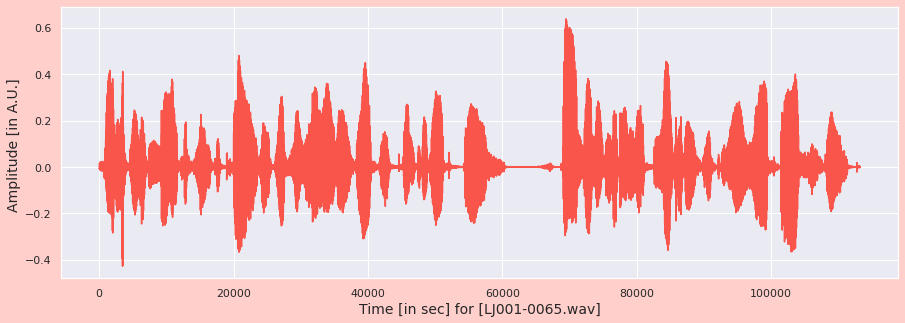


_________________________________________________________________________________________________________



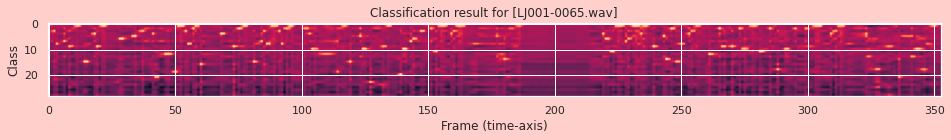

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  3,  8,  0,  0,  7,  0,  9,  0,  0,  1,  0,  0, 15, 15,  0,  0,
         4,  9,  0,  1,  1,  0,  0,  0,  0,  0,  6,  6,  0,  0,  0,  5,  5,  0,
         0,  3,  0,  0,  0,  4, 21, 21,  0,  0, 12, 12,  0,  0, 19,  1,  1,  1,
         3,  8,  0,  2,  1,  0, 16,  0,  0,  0,  0,  0,  0,  0,  4,  4,  0,  0,
         0,  9,  0,  2,  2,  1,  1,  0,  0, 15,  0,  0,  7,  3,  8,  8,  1,  1,
         1,  3,  8,  0,  2,  1,  1,  0,  0,  0,  0,  2,  2,  4, 10, 10,  0,  0,
         0, 12, 12, 12,  0,  0, 19,  0,  1,  1,  0, 15,  0,  0,  0,  5, 10, 10,
         0, 23,  0,  0,  0,  0,  9,  9,  1,  0,  0,  0,  0, 20, 10, 10,  0,  7,
         6,  0,  0,  3,  3,  0,  0,  2,  0, 11,  1,  1,  1,  0,  0,  4,  3,  1,
         1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  5,  0,  0,
        14,

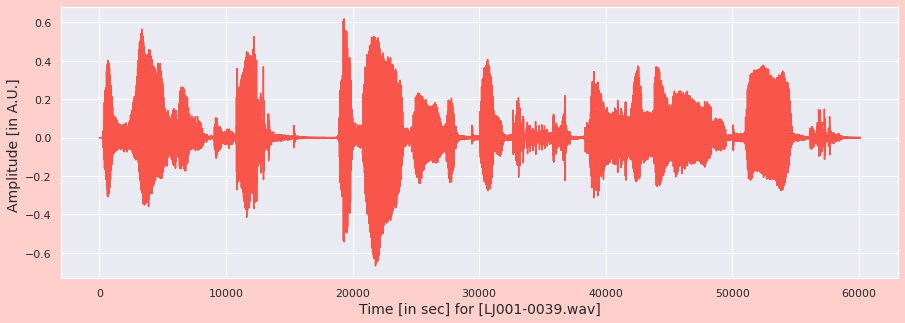


_________________________________________________________________________________________________________



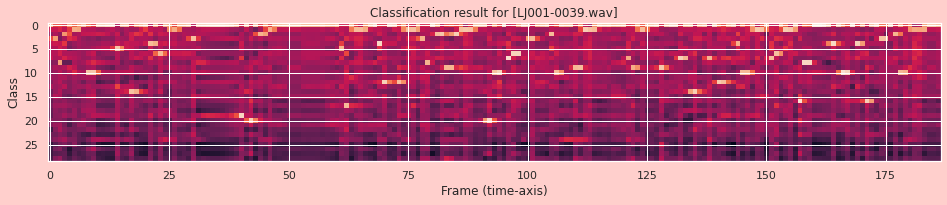

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  3,  8,  2,  0,  1,  1,  0, 10, 10,  0,  0,  0,  0,  5,  0,  0, 14,
        14,  0,  0,  4,  4,  6,  0,  0,  1,  0,  0,  0,  3,  0,  0,  0,  0,  0,
         0,  0,  0,  0, 19,  0, 20,  0,  2,  2,  1,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  5, 17,  0,  1,  1,  1,  0,  0,  4, 12,  0,
         0, 12,  0,  1,  1,  0,  3,  8,  0,  2,  2,  9,  9,  2,  1,  1,  1,  0,
         0,  0, 20, 10, 10,  0,  7,  6,  6,  0,  0,  3,  0,  0,  0,  2, 10,  0,
         0,  0,  9,  9,  1,  1,  1,  0,  0,  0,  0,  0,  0,  7,  9,  0,  1,  0,
         0,  0,  9,  0,  0,  0,  7,  0,  0, 14,  0,  0,  7,  0, 12, 12,  0,  0,
         4, 10, 10,  0,  1,  1,  0,  7,  6,  0,  1,  1,  0, 16,  8,  8,  0,  0,
         0,  0,  4,  0, 10, 10,  0,  4,  0, 16,  0,  0,  3,  3,  0,  2, 10, 10,
         1,

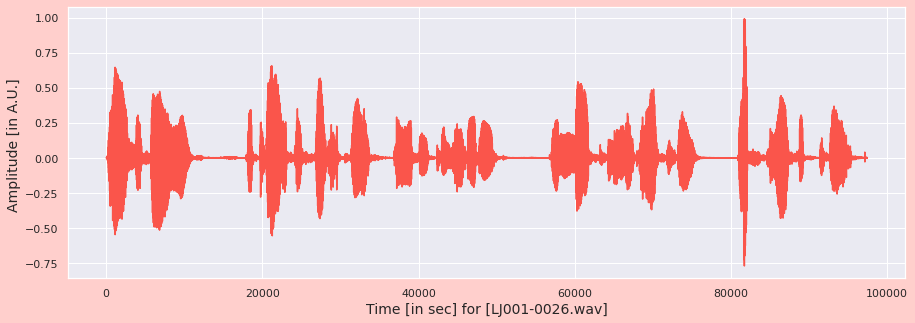


_________________________________________________________________________________________________________



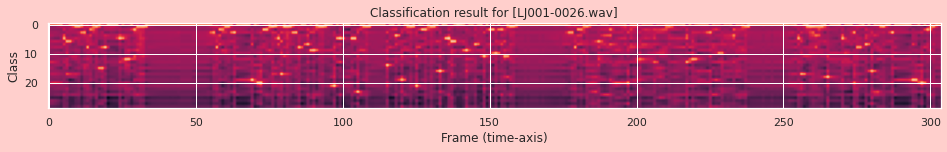

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  5,  6,  0,  0,  1,  1,  0,  3,  8,  2,  1,  1,  0,
        15,  8,  0,  0,  0,  0,  5,  0, 12, 12,  0,  2,  1,  1,  1,  1,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  3,  8,  2,  0,  1,  1,  0,  3,  0,  0,  0,  0,  0, 19,  0, 20,
        20,  2,  2,  1,  1,  1,  5, 17,  1,  1,  1,  3,  3,  8,  0,  0,  7,  9,
         9,  0,  1,  1,  0,  0,  0, 21,  0,  5,  0,  0,  0,  5,  5, 23,  0,  1,
         1,  1,  0,  0,  0,  0,  0, 14,  0,  0,  4,  0, 19,  0,  0,  1,  0, 21,
         0,  2,  2,  0,  1,  1,  0, 16,  0,  0,  5,  6,  6,  0,  0,  0,  9,  0,
         0,  7,  0,  0, 11,  0,  2,  2, 10,  0,  2, 11, 11,  1,  1,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  3,  8,
         2,

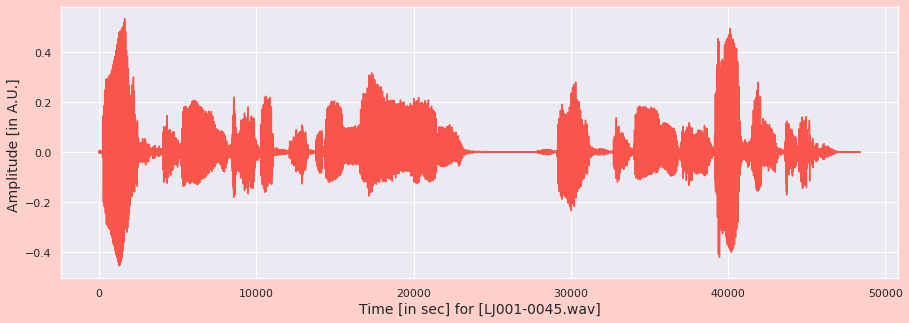


_________________________________________________________________________________________________________



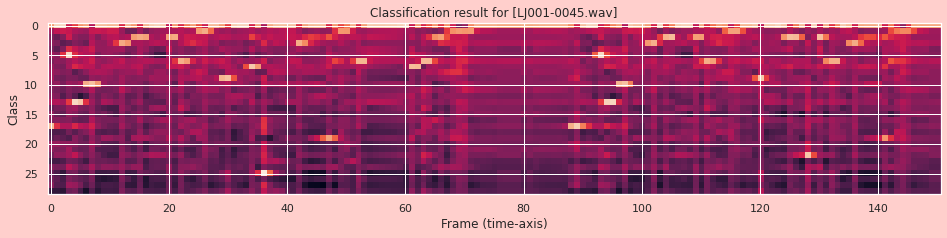

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([17,  0,  0,  5, 13, 13, 10, 10,  0,  0,  0,  0,  3,  0,  2,  2,  0,  0,
         0,  0,  2,  2,  6,  6,  0,  1,  1,  0,  0,  9,  9,  0,  0,  0,  7,  0,
        25,  0,  0,  0,  0,  0,  3,  0,  0,  0,  0, 19,  0,  1,  1,  0,  6,  6,
         0,  0,  0,  0,  0,  0,  0,  7,  7,  6,  6,  0,  2,  0,  1,  1,  1,  1,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 17, 17,
         0,  0,  0,  5, 13, 13, 10, 10,  0,  0,  0,  0,  3,  0,  2,  2,  0,  0,
         0,  2,  0,  6,  6,  0,  0,  1,  1,  0,  0,  0,  9,  0,  0,  0,  0,  2,
         2,  0, 22,  0,  2,  0,  6,  6,  0,  0,  3,  0,  0,  0,  0, 19,  0,  1,
         1,  1,  0,  0,  0,  0,  0])

Merge repeats  tensor([17,  0,  5, 13, 10,  0,  3,  0,  2,  0,  2,  6,  0,  1,  0,  9,  0,  7,
         0, 25,  0,  3,  0, 19,  0,  1

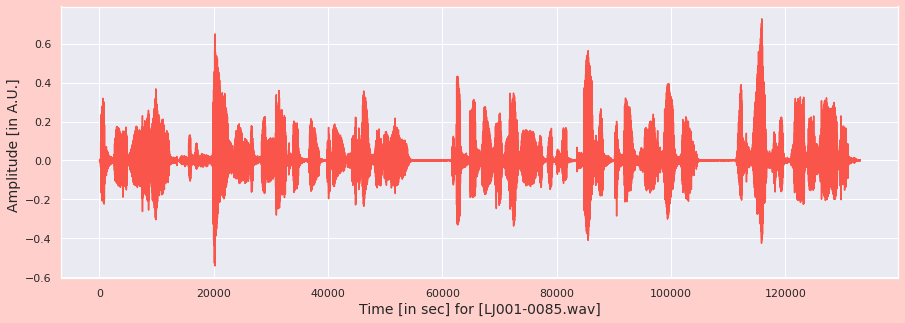


_________________________________________________________________________________________________________



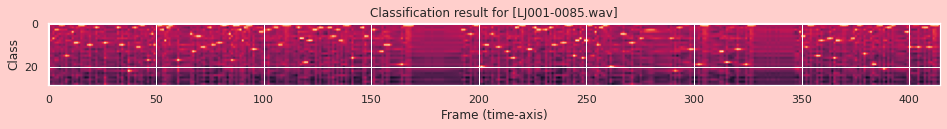

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  7,  3,  3,  0,  1,  0, 15,  0,  0,  4,  9,  9,  0,  1,  1,  0,
         0, 10,  0,  0,  2,  0,  0,  0,  9,  0,  0,  0,  0,  0,  2,  0, 10,  0,
         0, 22,  0,  0,  2, 11, 11,  1,  1,  0, 17,  0,  5, 10,  0,  1,  1,  3,
         8,  2,  1,  1,  0,  0, 17,  0,  0,  0,  0,  0,  5, 13,  0,  6,  6, 11,
        11,  0,  0,  2, 10,  0,  0,  9,  9,  1,  1,  0,  5, 17,  1,  1,  1,  3,
         8,  2,  1,  1,  0, 12,  0,  0,  4,  4,  0,  0,  3,  0,  0,  2,  2, 10,
        10,  1,  1,  1,  0,  0,  0,  0,  2,  7,  7, 18, 18,  8,  8,  3,  3,  0,
         2,  0,  0,  0,  2,  2,  6,  0,  3,  8,  8,  0,  1,  1,  0, 16,  0,  0,
         0,  0,  2,  6,  0,  0,  0,  3,  0,  0,  0, 13, 10, 10, 10,  0,  0,  0,
         0,  0, 19,  1,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,

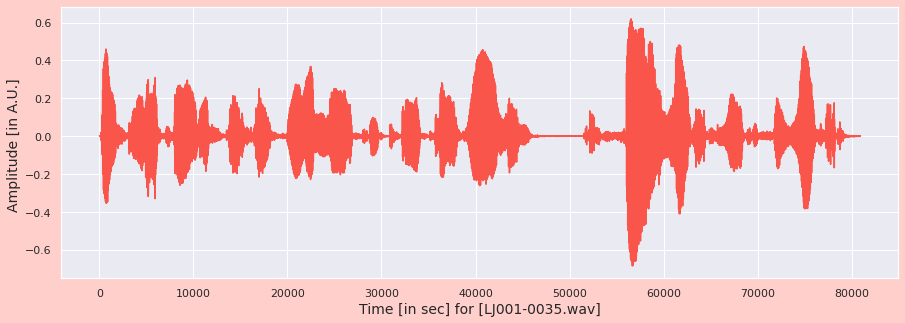


_________________________________________________________________________________________________________



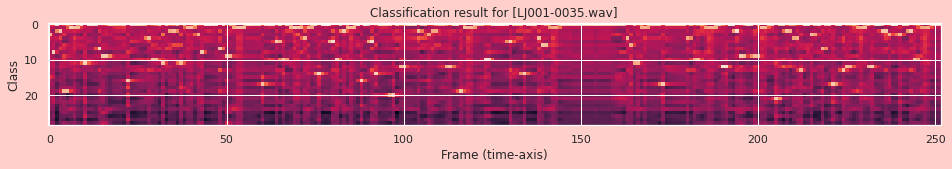

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  0,  2, 19, 19,  1,  1,  1,  0, 11,  0,  0,  0,  7,  9,  9,  0,
         0,  0,  0,  0, 16,  0,  0,  0,  0,  0,  4, 10, 10,  0, 11,  0,  2,  2,
         0, 11,  0,  1,  1,  0,  3,  8,  0,  0,  0,  0,  7,  0,  9,  9,  1,  1,
         1,  1,  0,  0,  0,  0, 17,  0,  0,  0,  5,  0, 10,  0,  1,  1,  1,  1,
         4,  1,  0,  0, 14,  0,  0,  0,  5, 10,  0,  2,  1,  1,  1,  0, 16,  0,
         0,  5, 14,  0,  0,  0,  0, 20,  0, 12, 12,  0,  0,  0,  2,  0,  0,  3,
         2,  2,  0,  0, 12, 12,  0,  0, 19,  1,  1,  1,  0,  0,  0, 10, 10,  0,
         0,  0,  0,  0,  5,  0,  0,  0, 14,  0,  0,  0,  4,  6,  6,  1,  1,  1,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  4,  6,  0, 11,  1,  1,  0,  0,  0,  0, 17,  0,  0,  0,  0,  0,  0,
         4,

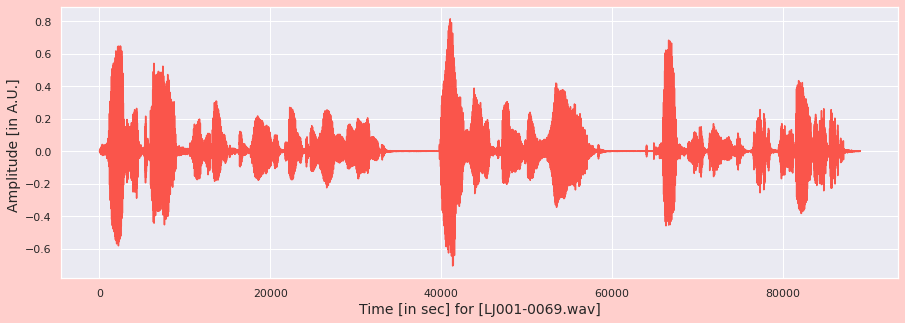


_________________________________________________________________________________________________________



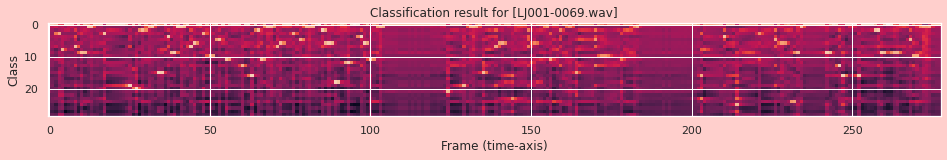

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  3,  8,  0,  0,  0,  7,  0,  9,  9,  1,  1,  0,  0,  0,  3,
         0,  0,  0,  0,  0,  0,  0, 19,  0, 20,  0,  2,  0,  1,  1,  0, 15, 15,
         0,  4,  9,  9,  1,  1,  1,  0,  7,  6,  0,  0,  3,  0, 10,  0,  0,  5,
         0, 11,  0,  0,  0,  0, 13,  0,  0, 16,  0,  2, 11,  0,  1,  1,  0,  7,
         6,  0,  0,  0,  3,  0,  5,  0,  1,  1,  1,  0,  0,  2,  6,  6,  6, 18,
        18,  0,  0, 12,  0,  0,  0,  4,  6,  0, 11,  0,  1,  1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 21,  0,
         0,  0,  0, 19,  0,  1,  1,  1,  0, 15,  0,  0,  0,  7,  0,  6,  0,  0,
        23,  0,  0,  0,  0,  2,  0,  6,  0,  0,  1,  0, 11,  0,  0,  2,  0,  0,
         1,  0, 15,  0,  0,  0,  0,  0,  5,  0, 10, 10,  0,  0,  0,  0, 11,  0,
         0,

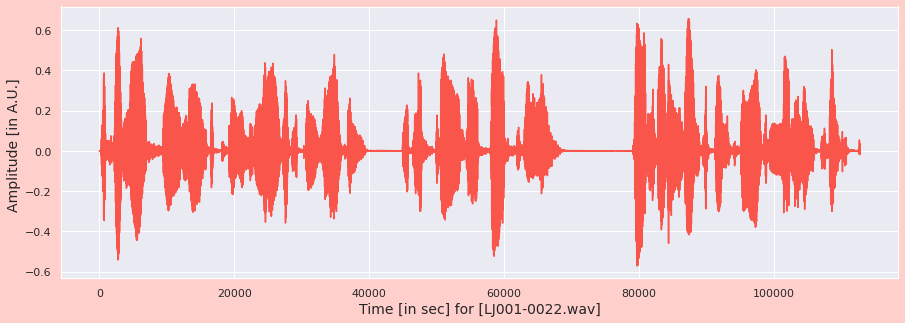


_________________________________________________________________________________________________________



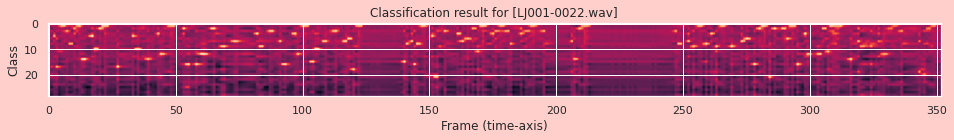

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  5, 17,  0,  1,  1,  3,  8,  8,  2,  1,  1, 14, 14,  0,  0,  5,
        10, 10,  2,  1,  1,  1,  0,  0,  0, 17,  0,  0,  0,  0,  0,  5,  0, 10,
         0,  0,  0, 14,  0,  0,  0,  4, 12, 12,  0,  1,  1,  1,  0,  0,  0,  2,
        16, 16,  0,  0, 16,  0, 12, 12, 12,  0,  2,  2,  0,  0,  9,  9,  0,  0,
         0,  7,  7,  0,  0,  0,  0,  0,  0,  0,  4,  9,  9,  0,  0,  3,  3,  0,
         0,  7, 16, 16,  0,  0,  0,  4, 12,  0,  1,  1,  0, 15, 15, 10, 10,  0,
         7,  7,  0,  0,  3,  3,  0,  0,  7,  7,  6,  6, 18,  0,  1,  1,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 15,  8,  0,  7,
        16,  8,  8,  1,  1,  0,  0,  5, 21, 21,  0,  0,  3,  0,  0,  0,  0,  4,
         4,  7,  0,  6,  0,  2,  0, 11,  1,  1,  1,  0,  0,  4,  3,  0,  1,  1,
         3,

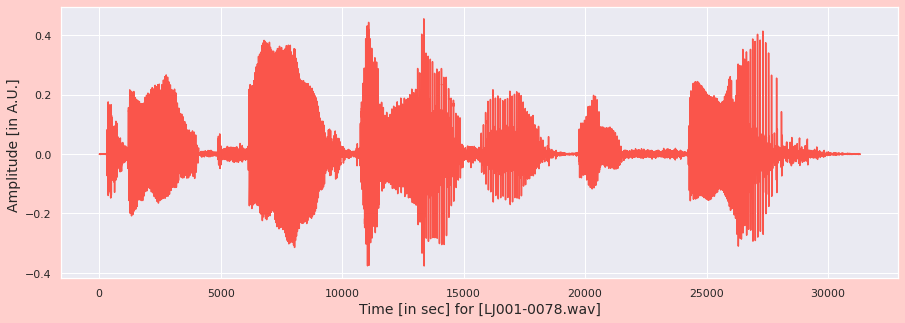


_________________________________________________________________________________________________________



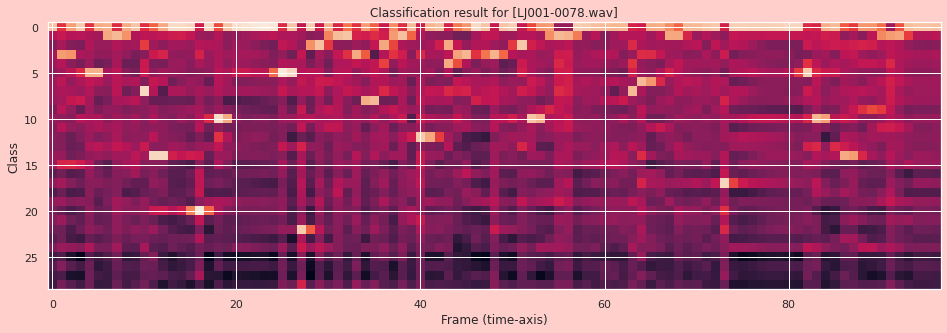

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  3,  0,  0,  5,  5,  0,  1,  0,  0,  7, 14, 14,  0,  0,  0, 20,  0,
        10,  0,  0,  0,  0,  0,  0,  5,  5, 22,  0,  2,  0,  1,  1,  3,  8,  8,
         2,  1,  1,  0, 12,  0,  0,  2,  3,  3,  0,  0,  3,  0,  0,  2, 10, 10,
         0,  1,  1,  0,  0,  0,  0,  0,  0,  7,  6,  0,  0,  1,  1,  0,  0,  0,
         0, 17,  0,  0,  0,  0,  0,  0,  0,  0,  5, 10,  0,  0, 14, 14,  0,  0,
         1,  1,  1,  0,  0,  0,  0])

Merge repeats  tensor([ 0,  3,  0,  5,  0,  1,  0,  7, 14,  0, 20,  0, 10,  0,  5, 22,  0,  2,
         0,  1,  3,  8,  2,  1,  0, 12,  0,  2,  3,  0,  3,  0,  2, 10,  0,  1,
         0,  7,  6,  0,  1,  0, 17,  0,  5, 10,  0, 14,  0,  1,  0])

labels ['T', 'O', '|', 'I', 'M', 'P', 'R', 'O', 'V', 'E', '|', 'T', 'H', 'E', '|', 'L', 'E', 'T', 'T', 'E', 'R', '|', 'I', 'N', 

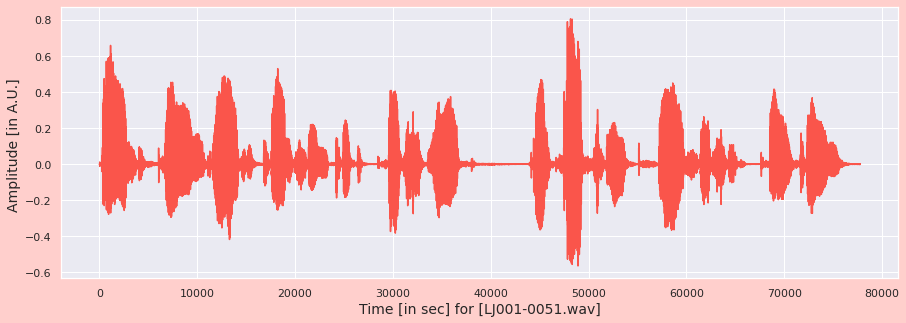


_________________________________________________________________________________________________________



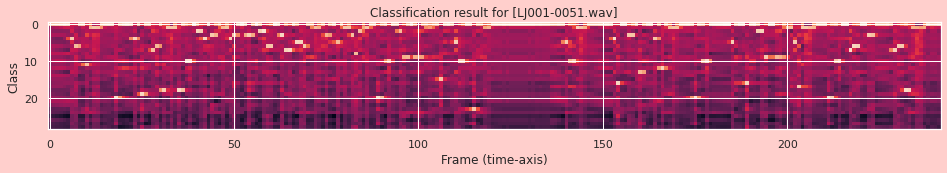

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  4,  6,  0,  0, 11,  1,  1,  1,  0,  0,  0,  0,
        20,  0,  0,  0,  0,  4,  0, 19,  0,  0,  7,  6,  0, 18,  1,  1,  1, 18,
        18, 10, 10,  0,  2,  2,  4,  0,  3,  3,  0,  1,  1,  4,  3,  0,  0,  0,
         3,  0,  0,  2,  2,  6,  6,  0,  0,  3,  7,  7,  0,  5,  5,  6,  0,  0,
         1,  1,  0,  3,  0,  0,  5,  0,  1,  1,  3,  8,  2,  1,  1,  0,  0, 20,
        20,  0, 10,  0,  0,  2,  9,  9,  0,  9,  9,  9,  0,  1,  0,  0, 15,  0,
         0,  0,  5, 10, 10,  0,  0, 23,  0,  0,  1,  1,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  5, 10, 10,  1,
         1,  1,  0,  0,  0,  0,  0,  0,  0,  4, 16,  0,  0,  3,  3,  0, 13,  0,
         0,  0,  4,  0, 12,  0,  1,  1,  1,  0,  0,  0,  0, 20,  0, 10, 10,  0,
         0,

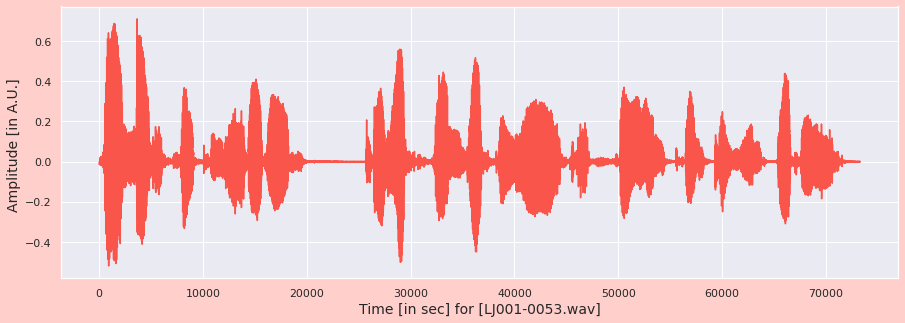


_________________________________________________________________________________________________________



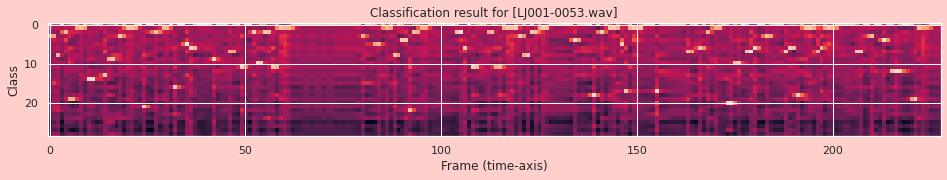

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  3,  8,  0,  2, 19, 19,  1,  1,  0, 14, 14,  0,  0, 13,  9,  9,  0,
         3,  0,  1,  1,  0,  0, 21,  0,  0,  2,  0,  1,  1,  0, 16,  0,  0,  5,
         6,  6,  0,  0,  0,  0,  9,  0,  0,  0,  7,  0,  0, 11,  0,  0,  2, 10,
        10,  2,  2, 11, 11,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  3,  0,  0,  0,  5,  0,  1,  0,  8,  0,
         4,  4, 22,  2,  2,  1,  1,  0,  0,  0,  0,  0,  0,  0,  2,  2,  6,  0,
        11, 11,  0,  0,  2,  2, 11, 11,  1,  1,  1,  1,  3,  8,  8,  2,  2,  1,
         1,  1,  0,  0,  0,  0,  0,  0,  4,  0,  0,  0,  0, 18,  0,  2,  0,  1,
         1,  1,  5, 17,  1,  1,  1,  1,  0,  0,  0, 17,  0,  0,  0,  0,  0,  0,
         0,  7,  0,  0,  6,  0,  2,  0,  1,  1,  0, 20, 20, 10, 10,  0,  7,  7,
         6,

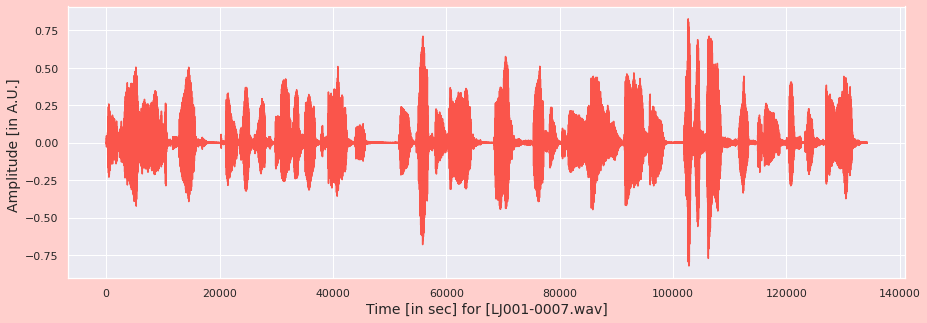


_________________________________________________________________________________________________________



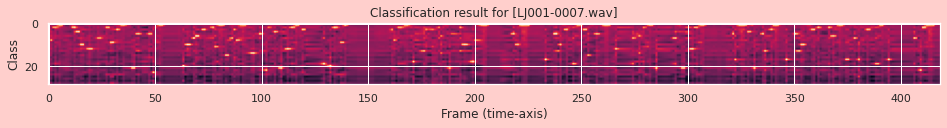

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  0,  2,  0,  1,  1,  0,  0,  0,  0,  0,  2,  4,  4, 10, 10,  0,
         0, 12, 12,  0,  0,  7,  7,  0,  0,  2,  2,  9,  9,  0,  3,  0,  1,  1,
         0,  0,  0, 21, 21,  0,  5,  0,  0,  0,  0,  5,  0, 23,  0,  0,  1,  1,
         0,  0,  0,  0,  0,  0,  0,  0,  0, 20,  0, 10, 10,  0,  7,  6,  6,  0,
         3,  3,  0,  0,  0,  2, 11,  0,  1,  1,  0, 15, 15,  0,  7,  3,  8,  8,
         1,  1,  1,  0,  0, 14, 14,  0,  0,  5,  0,  0, 22,  0,  0,  0,  4,  0,
        21, 21,  0,  0, 12, 12,  2,  2,  1,  0,  0,  3,  3,  0,  0,  0,  0,  0,
         0,  0,  0, 19,  0,  0, 20,  0,  2,  2,  0,  9,  9,  1,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,
         8,  0,  2,  2,  0,  1,  1,  0,  0, 18,  0,  0,  0, 13, 13,  3,  0,  0,
         3,

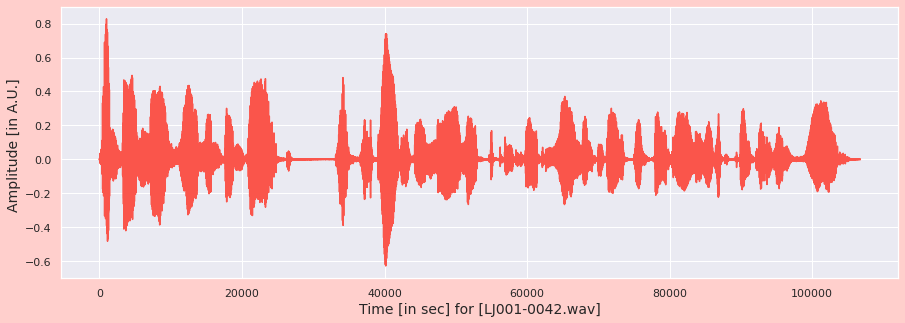


_________________________________________________________________________________________________________



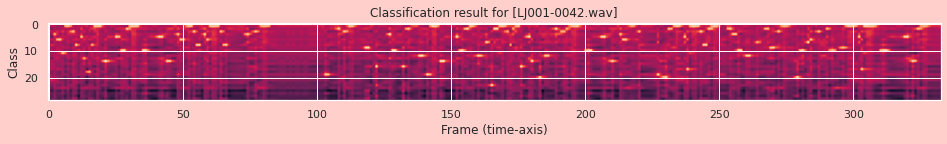

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  4,  6,  6, 11,  0,  1,  0,  3,  8,  0,  5, 13,  0, 18,  8,  1,
         1,  1,  0, 14,  0,  0,  0,  5,  5, 10, 10,  2,  1,  1,  1,  1,  0, 10,
        10,  0,  0,  0,  0,  5,  5,  0, 14, 14,  0,  0,  4,  6,  6,  0,  1,  1,
         3,  8,  8,  0,  4,  6,  1,  1,  1,  1,  3,  8,  8,  0,  0,  0,  0,  0,
         0,  0,  4,  0,  0,  3,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 19, 19,  0,  0,  0,
         2,  0,  3,  0,  1,  1,  0,  0,  0,  0,  9,  9,  0,  0, 16,  0,  0,  0,
         0,  4, 10, 10,  0,  0, 16,  0,  2,  0,  0,  0, 12, 12,  0, 19, 19,  1,
         1,  0, 14, 14,  0,  0,  0,  0,  5,  0, 10,  2,  2,  1,  1,  0, 12,  0,
         0,  7,  0, 23,  2,  2,  1,  1,  1,  3,  8,  2,  1,  1, 16,  0,  0,  5,
        14,

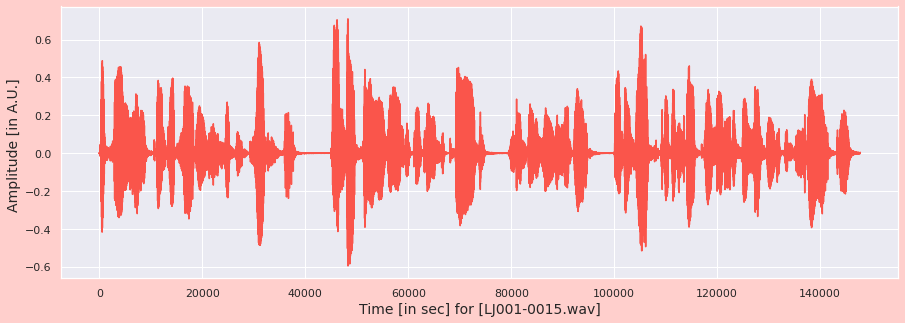


_________________________________________________________________________________________________________



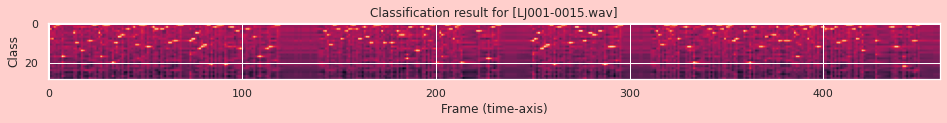

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  3,  8,  2,  1,  1,  0, 17,  0,  0,  0,  0,  0,  5, 10,  0,  0, 14,
         0,  0,  0,  9,  0,  1,  1,  0,  5, 17,  0,  1,  1,  1,  0, 20, 10, 10,
         7,  7,  6,  0,  0,  3,  0,  0,  2, 11, 11,  1,  1,  1,  0, 12, 12,  0,
         2,  3,  3,  0,  3,  3,  0,  2, 10, 10,  0,  9,  9,  1,  1,  1,  0,  0,
         0,  9,  8,  8,  5,  5, 13, 12,  0, 11,  1,  1, 21,  0,  2,  0,  1,  1,
         0, 21,  0,  0,  2,  2,  0,  4,  4, 13,  0,  0,  3,  3,  0,  0,  7,  0,
         0, 17,  0,  0,  0, 13, 12, 12,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,
         6, 11, 11,  1,  1,  3,  3,  8,  0,  0,  4,  3,  0,  1,  1,  3,  8,  8,
         0,  2,  7,  7, 10, 10,  1,  1,  1,  0,  4, 10,  0,  0,  0, 10,  0,  0,
         4,

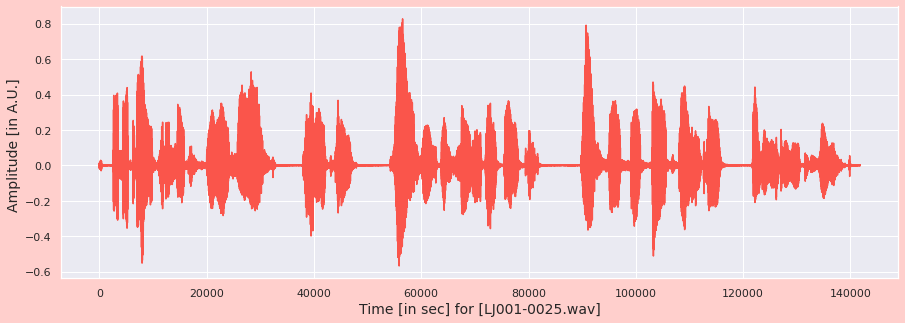


_________________________________________________________________________________________________________



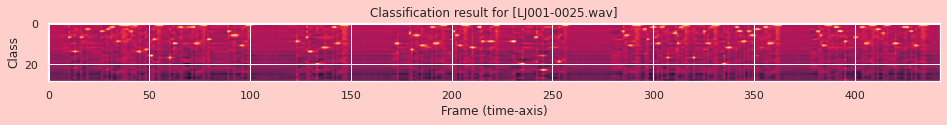

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  0,  0, 14,  0,  0,  7,  0,
         0,  3,  0,  0,  0,  0,  0,  0,  4,  0,  0,  3,  0,  2,  2,  0,  9,  0,
         1,  1,  1,  1,  1,  4,  1,  1,  0, 14,  0,  0, 13,  0, 16, 16,  8,  0,
         1,  1,  1,  0,  0,  0, 17,  0, 10, 10,  0,  2,  2,  0,  0,  0,  0,  2,
         2, 10, 10,  0,  1,  1,  1,  8,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,
         0,  6,  6,  6,  0,  0, 11,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  9,  0,  0,
         0,  0,  7, 14, 14,  0,  0, 20,  0,  0, 12, 12,  0,  0,  0,  2,  2, 10,
        10,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 10, 10,  0,  0,  0,  0,  0,  5,
        13,

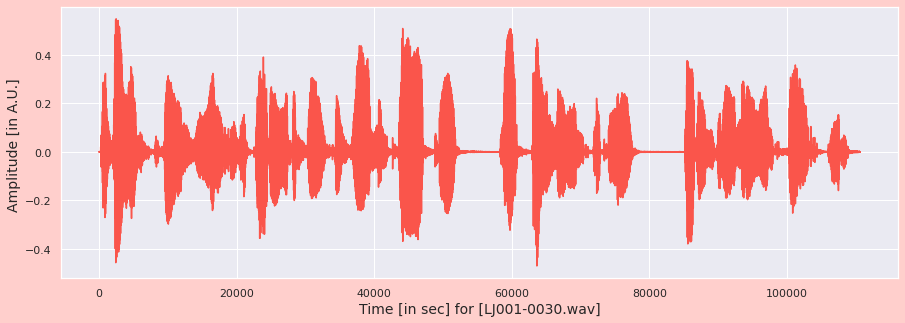


_________________________________________________________________________________________________________



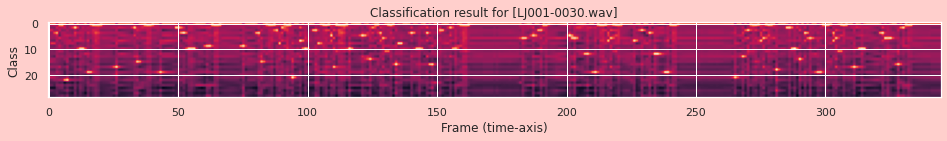

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  4,  1,  1,  0, 22,  0,  0,  2,  0, 10, 10,  0, 19, 19,  1,
         1,  1,  0,  0,  0,  0,  0,  0, 17,  0,  0,  0,  0,  0,  0,  2, 15,  0,
         0,  1,  1,  1,  0,  0,  0, 19,  0,  0,  0,  0,  0,  2,  2,  4,  4,  0,
        10, 10, 10,  0,  0,  0,  0,  9,  9,  1,  1,  1,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  9,  0,  0,  0,  0,  0,  4, 15,  0,  0,  1,  1,  1,  3,  8,
         2,  1,  1,  1, 21,  0,  0,  7,  0, 10,  0,  0,  0,  3,  8,  0,  1,  1,
         1,  5, 17,  1,  1,  1,  1,  0, 10,  0,  0,  0,  0,  5,  5,  0, 14,  2,
         0,  0,  4,  6,  0,  1,  1,  0, 16,  8,  8,  0,  0,  0,  4,  0, 10, 10,
         0,  0,  4,  0, 16,  0,  0,  3,  3,  0,  0,  2,  0, 10,  0,  1,  1,  1,
         1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,

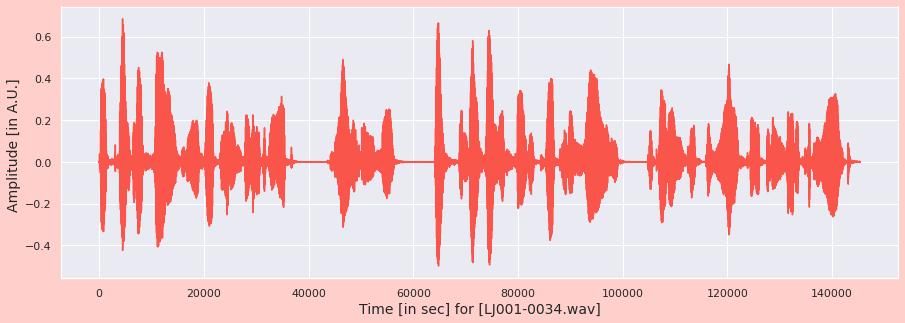


_________________________________________________________________________________________________________



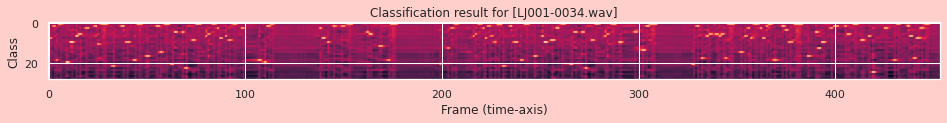

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  8,  0,  2, 19,  0,  1,  0,  0, 20, 20, 10, 10,  0,  7,  6,  6,  0,
         0,  3,  3,  0,  0,  0,  2, 11,  0,  1,  1,  1,  0,  0,  0, 22,  0,  0,
         0,  2,  2,  0, 10, 10,  0, 19, 19,  1,  1,  1,  0,  0, 17, 17,  0,  0,
         0,  2,  2, 15,  0,  1,  1,  1,  0, 21,  5,  5,  0,  0,  5,  0, 23,  0,
         0,  9,  9,  1,  1,  1,  0,  0,  7,  6,  0,  0,  1,  0,  3,  8,  8,  0,
         7,  0,  9,  0,  1,  1,  0,  0,  0,  3,  0,  0,  0,  0,  0,  0,  0, 19,
         0,  0, 20,  2,  2,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  8,  8,  0, 10,  0,
         0,  2,  0,  0,  0,  2,  2,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,
         5,  6,  6,  0,  0,  0, 12, 12,  0,  0,  0, 19,  1,  1,  1,  0,  0,  0,
         0,

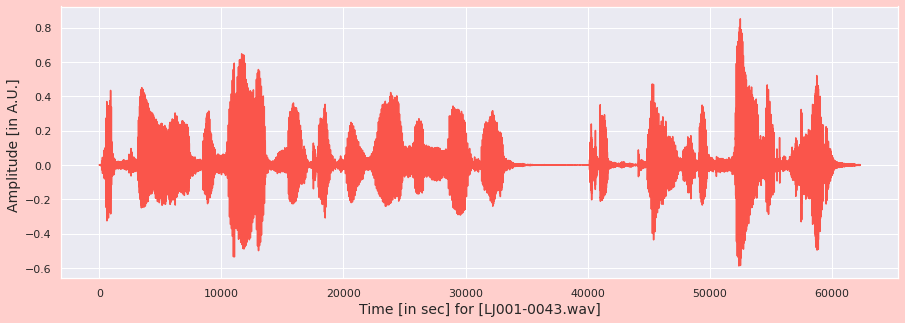


_________________________________________________________________________________________________________



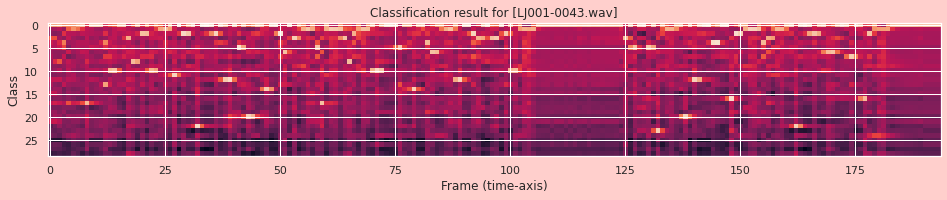

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  0,  0, 17,  0,  0,  0, 13, 10, 10,  0,  0,  3,
         8,  0,  2,  2, 10, 10,  1,  1,  0, 11,  0,  2,  2,  0, 22,  0,  0,  0,
         2,  0, 12, 12,  0,  5,  0, 20, 20,  0,  0, 14,  0,  0,  2,  6,  0,  3,
         0,  1,  1,  1,  5, 17,  1,  1,  1,  1,  3,  8,  2,  1,  1,  1,  0, 10,
        10,  0,  0,  0,  5,  0,  0, 14,  0,  0,  4,  6,  6,  0,  1,  1, 12, 12,
         0,  0,  2,  3,  0,  0,  3,  3,  0,  2, 10, 10,  1,  1,  1,  1,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,
         0,  5,  0,  0,  5,  0, 23,  0,  1,  1,  0,  0, 20,  0, 12,  0,  0,  0,
         4,  4,  0,  0, 16,  2,  2,  1,  1,  1,  1,  4,  3,  3,  1,  1,  0,  0,
        22,  0,  0,  0,  2,  0,  0,  6,  6,  0,  0,  0,  7,  0,  0, 16,  2,  0,
         1,

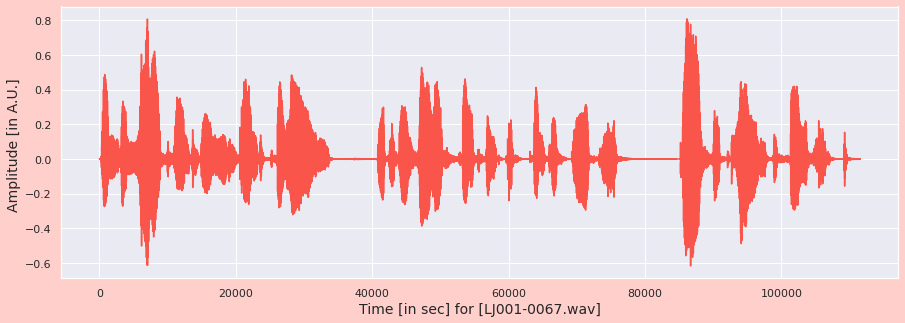


_________________________________________________________________________________________________________



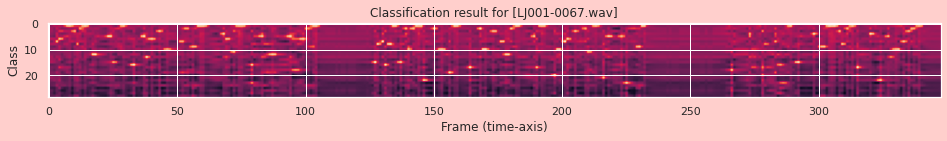

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  7,  6,  0,  0,  1,  1,  0,  3,  8,  2,  1,  1,  0,  0, 12,
        12,  0,  0,  0,  0,  5,  5, 15,  0,  0,  1,  1,  0,  0,  0, 16,  0,  0,
         0,  5, 13,  0,  6,  0,  0,  3,  0,  0, 10,  0,  0,  0,  0,  7,  7,  2,
         2,  0,  9,  9,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  4,  6,  6,  0,
        11,  1,  1,  1,  1,  0,  0, 16,  0,  0,  0,  5,  0,  0, 12, 12, 12,  0,
         0,  0,  0,  5,  5,  0, 18, 18,  6,  6,  2,  2,  0,  1,  1,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0, 15,  8,  0,  7, 16,  8,  8,  1,  1,  0, 15,  0,  2, 10,  0,  2,  1,
         1,  1, 22,  0,  0,  0,  2,  0, 10, 10,  0,  0, 19,  0,  1,  1,  0,  0,
         0,  0, 17,  0,  0,  0,  2, 10, 10,  0,  0,  3,  3,  0,  7,  7, 12, 12,
         2,

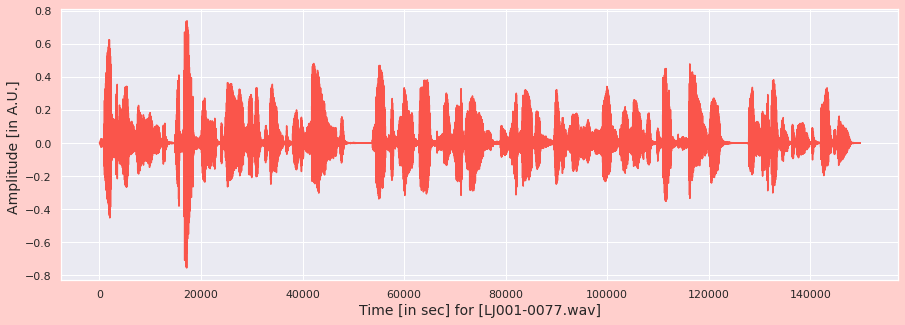


_________________________________________________________________________________________________________



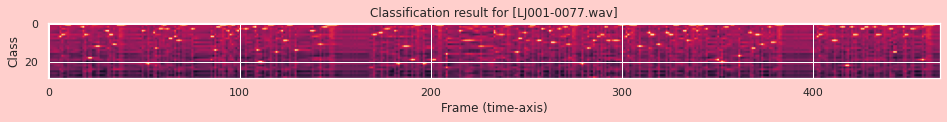

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  7,  6,  0,  1,  1,  1,  0,  0,  0,  0,  0,  0,
         2,  6,  0, 18, 18,  0,  0, 12, 12,  0,  0,  0,  4,  4,  6,  6, 11, 11,
         1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  4,  0,  0, 21,  0,
         0,  5, 13,  0,  3,  3,  1,  1,  3,  8,  8,  0,  7,  0,  9,  0,  1,  1,
         0,  0,  0,  3,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  7, 14,  2,  2,
         1,  1,  1,  0,  4,  6,  1,  1,  0,  4,  3,  0,  0,  3,  0,  0,  0,  0,
         2, 14, 20, 20,  0,  3,  0,  1,  1,  1,  0, 15,  0,  0,  4,  9,  9,  1,
         1,  0,  0, 14,  0,  0,  0,  0,  0,  0,  0,  4,  4,  0,  0,  0, 11,  0,
         2,  2,  1,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  6,  0,  0,  5,  5,  0,  0,  3,  0,  0,
         0,

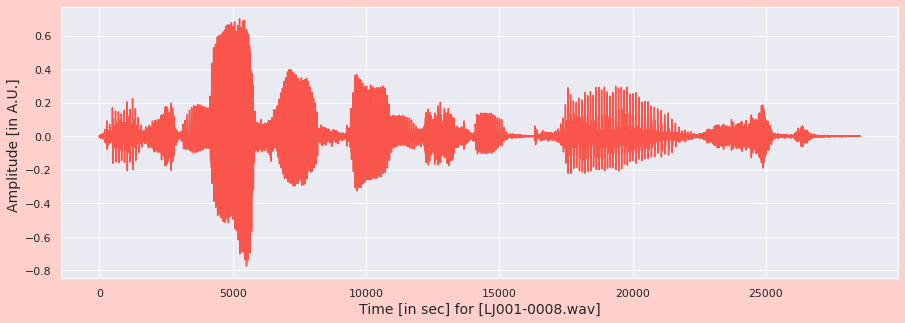


_________________________________________________________________________________________________________



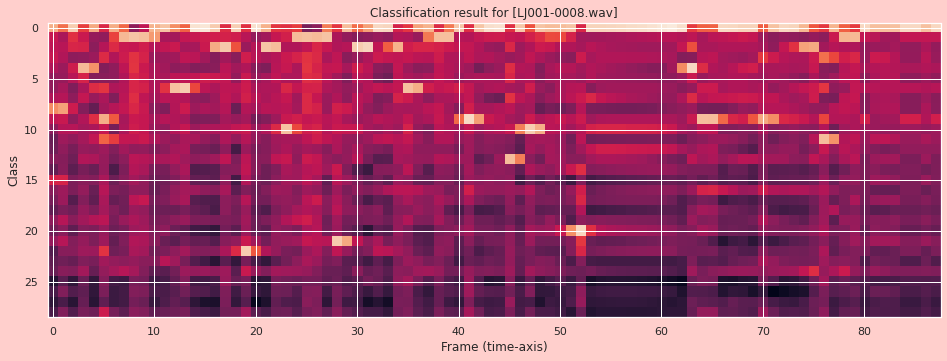

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  8,  0,  4,  0,  9,  0,  1,  1,  1,  0,  0,  6,  6,  0,  0,  0,  2,
         0, 22,  0,  2,  2, 10,  1,  1,  1,  1, 21,  0,  2,  2,  0,  0,  2,  6,
         6,  0,  1,  1,  0,  9,  0,  0,  0, 13,  0, 10,  0,  0,  0,  0, 20,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  4,  9,  9,  0,  0,  0,  0,  9,  0,
         0,  0,  0,  2, 11,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0])

Merge repeats  tensor([ 0,  8,  0,  4,  0,  9,  0,  1,  0,  6,  0,  2,  0, 22,  0,  2, 10,  1,
        21,  0,  2,  0,  2,  6,  0,  1,  0,  9,  0, 13,  0, 10,  0, 20,  0,  4,
         9,  0,  9,  0,  2, 11,  0,  1,  0])

labels ['H', 'A', 'S', '|', 'N', 'E', 'V', 'E', 'R', '|', 'B', 'E', 'E', 'N', '|', 'S', 'U', 'R', 'P', 'A', 'S', 'S', 'E', 'D', '|']

Transcript for [LJ001-0008.wav]: HAS|NEVER|BEEN|SURPASSED|

__

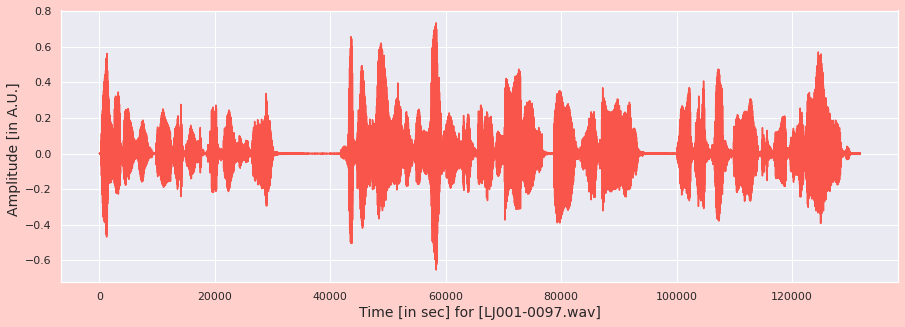


_________________________________________________________________________________________________________



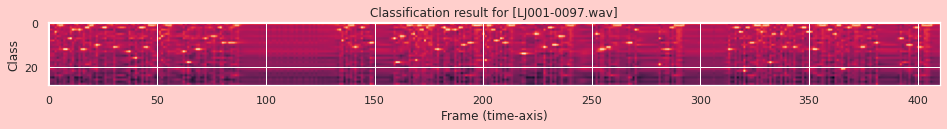

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  4,  0,  1,  1, 12, 12,  0,  7,  3,  0,  0,  3, 12, 12,  2,
         2,  1,  1,  0, 10,  0,  0,  2,  2,  0,  0,  0, 11,  0,  0,  0,  0,  0,
         0, 13,  0,  0, 16,  0,  2,  2, 11, 11,  0,  1,  1,  0,  0,  7,  6,  0,
         1,  1,  1,  0,  0,  0,  0,  0, 13,  0, 18, 18,  0,  0, 12, 12,  0,  0,
         7,  0,  0,  6,  6,  0,  0,  2,  9,  0,  0,  9,  9,  9,  1,  1,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  3,  8,  0,  2,  0,  1,  1, 11,  0,  0,
         2,  0,  0,  0,  9,  9,  0,  0,  0,  0,  0,  0,  0,  0,  0,  7, 18, 18,
         6,  6,  0,  1,  1,  1,  5, 17,  1,  1,  3,  8,  2,  1,  1,  1,  0, 12,
         0,

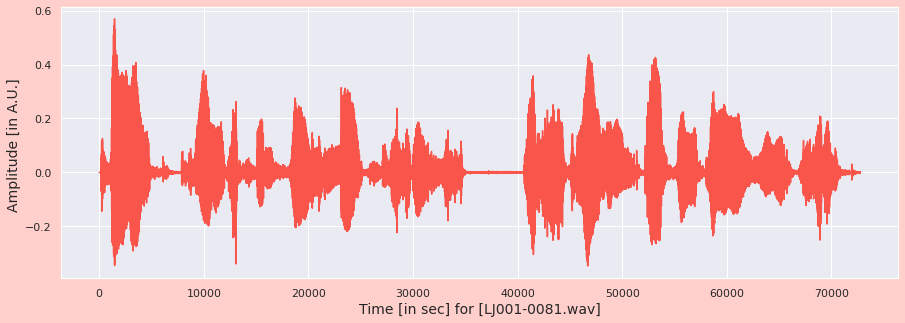


_________________________________________________________________________________________________________



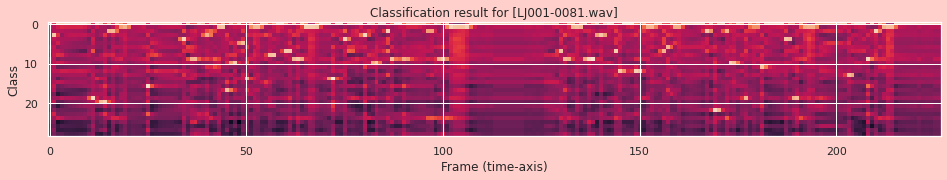

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  3,  0,  0,  0,  0,  0,  0,  0,  0,  0, 19,  0,  0, 20,  2,  2,  0,
         1,  1,  0,  0,  0,  0,  0, 16,  0,  0,  0,  0,  0,  0,  0,  0,  4,  0,
         9,  9,  0,  0,  3,  0,  0,  1,  1, 17,  0, 10,  0,  5, 14,  0,  1,  1,
         0,  0,  8,  8,  0,  0,  7,  7,  9,  9,  0,  1,  1,  1,  1,  0,  0,  0,
        14,  0,  0,  4,  0,  0,  0,  0,  3,  0,  0, 10,  0,  0,  2,  9,  0,  0,
         9,  0,  0,  0,  0,  0,  2,  2,  0,  9,  9,  0,  1,  1,  1,  1,  1,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  7,  9,  0,  1,  1,  0,  0,  9,  9,  0,  3,  0,  0,  0,
         7, 12,  0,  0,  0, 12, 12,  0,  1,  1,  0,  0,  7,  6,  0,  1,  1,  0,
         0,  0,  0,  0,  0,  2,  0, 22,  0,  0,  2, 10, 10,  0,  0, 19,  0,  1,
         0,

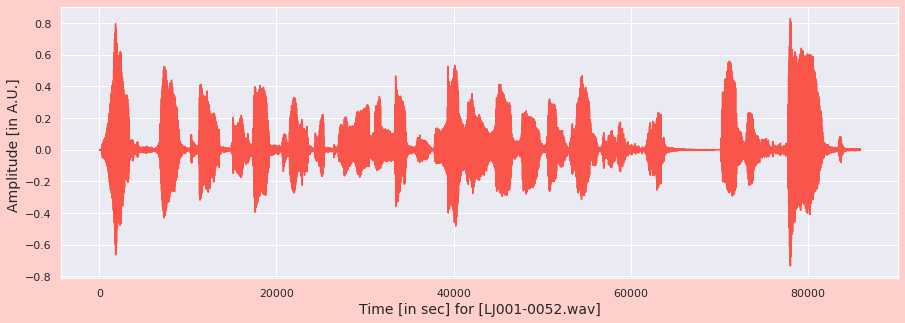


_________________________________________________________________________________________________________



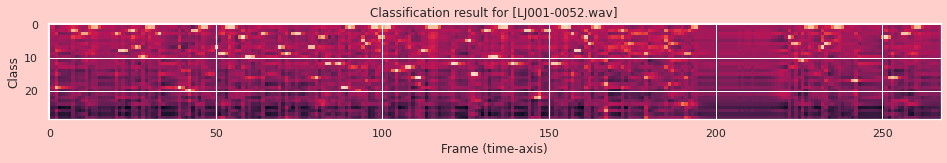

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0, 19,  0,  0,  0,  0,  2,  0,  0,  3,  3,  0,  1,  1,  0,  0,  0,
         0,  0,  3,  8,  8,  0,  0,  2,  7,  0, 10,  0,  1,  1,  0,  3,  0,  0,
         0,  0,  0, 19,  0,  0, 20,  2,  2,  0,  1,  1,  0,  0,  7,  9,  9,  1,
         1,  1,  0,  0,  4, 10, 10,  0,  0,  0,  3,  0,  0,  0,  0,  7,  0,  9,
         0,  0,  3,  3,  0,  0,  7,  7, 16,  0,  4, 12, 12,  0,  0, 12, 19, 19,
         1,  1,  0,  0,  5,  6,  0,  1,  1,  4,  1,  1,  1,  0, 14,  0,  0, 13,
        13,  0, 16, 16,  8,  0,  1,  1,  1,  0,  0,  0,  0, 12, 12,  0,  0,  0,
         5, 15, 15,  0,  0,  2, 10, 10, 10,  1,  1,  1,  0, 12,  0,  0,  0,  2,
         2,  0,  0, 22,  0,  0,  2, 12, 12,  0,  1,  1,  1,  3,  8,  8,  0,  4,
         6,  0,  1,  1,  0, 18,  0,  0,  0,  0,  2,  0,  6,  0,  0,  0,  0,  9,
         0,

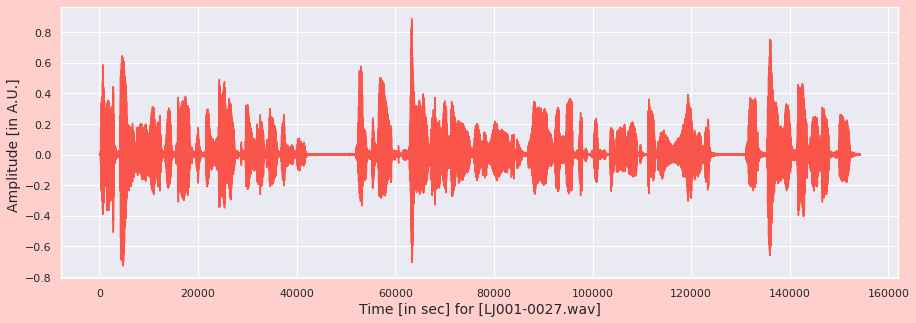


_________________________________________________________________________________________________________



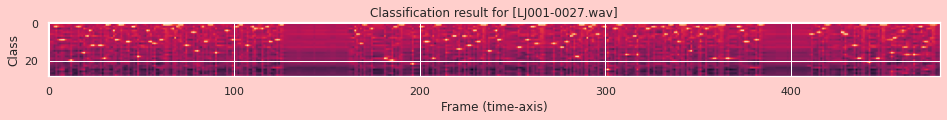

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  2,  0,  9,  9,  9,  0,  0,  0, 20,  0,  0,  0,  2,  0,
         0, 16,  0,  7,  4, 12, 12,  0,  0, 12, 12,  0, 19,  1,  1,  0,  0,  4,
         9,  9,  1,  1,  1,  0, 10, 10,  0,  2,  2,  0, 18,  0,  0,  0,  0,  4,
        10, 10,  0, 11,  0,  0,  9,  9,  1,  1,  1,  1,  0,  3,  8,  2,  1,  1,
         1,  0, 12,  0,  0,  0,  5,  0, 15,  0,  0,  2, 10, 10,  0,  1,  1,  0,
        16,  0,  0,  0,  0,  0,  4,  0,  0,  9,  0,  2,  0,  1,  1,  0,  0, 12,
         0,  0,  2,  3,  0,  0,  0,  3,  0,  0,  2, 10,  0,  0,  0,  9,  9,  1,
         1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  4,  6,  0, 11,  0,  1,  0,  0,  0,  3,  0,  0,  0,  0,  0,
         0,

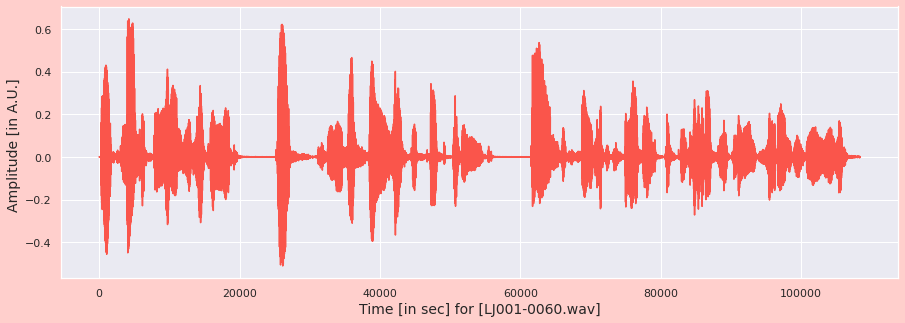


_________________________________________________________________________________________________________



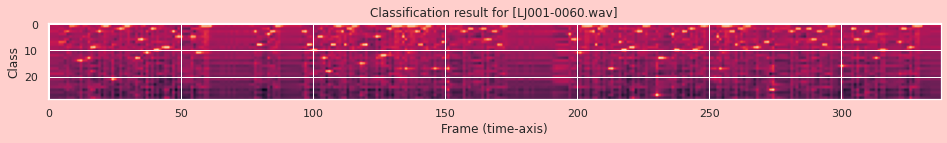

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 14,  0,  0, 13,  9,  9,
         0,  3,  0,  1,  1,  0, 21,  0,  0,  2,  0,  1,  1,  0,  0, 13, 13,  6,
         0, 11,  0,  2, 10, 10,  0,  0,  9,  9,  0,  3,  0,  5,  0,  0,  0,  0,
         5,  0, 11, 11,  1,  1,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  3,  8,  8,  0,  0,  4,  3,  3,  1,  1,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  3,  8,  8, 10,  0,  5,  5, 13,  0, 18,  8,
         8,  1,  1,  3,  8,  0,  2,  1,  1,  0, 15,  8,  8,  0,  0,  0,  5,  0,
        12, 12,  0,  2,  0,  1,  1,  1,  5, 17,  1,  1,  1,  3,  8,  8,  2,  1,
         1,  0, 17,  0,  0,  7,  0, 17,  0,  0,  0,  0,  0,  3,  0,  2,  0,  0,
         0,  0,  2,  0,  6,  0,  0,  3,  8,  0,  1,  1,  0,  0,  0,  0,  0,  0,
         0,

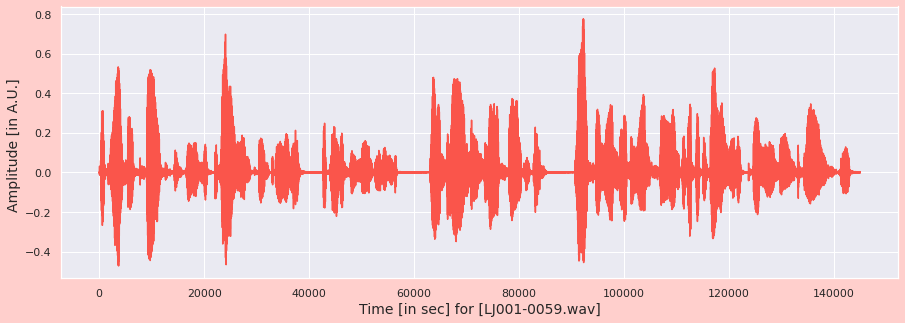


_________________________________________________________________________________________________________



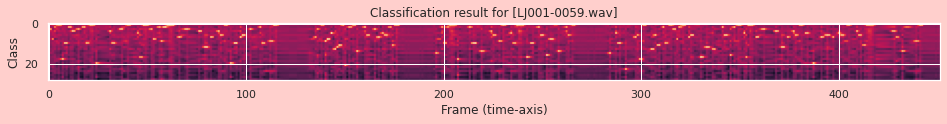

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 3,  3,  8,  2,  1,  1,  0, 18, 10, 10,  0,  2,  4,  4,  0,  3,  0,  0,
         2, 10, 10,  1,  1,  0, 20,  0,  0,  0,  0,  0,  0,  4, 10, 10,  0,  0,
         3,  3,  0,  0,  1,  1,  0,  0,  0,  5, 17, 17,  1,  1,  1,  0,  3,  8,
         0,  0,  2,  9,  2,  2,  1,  1,  1,  1,  0,  0,  7,  0,  0,  3,  3,  0,
         0,  0,  0,  0,  4,  4,  0, 12, 12,  0,  7,  7,  0,  0,  4,  6,  6,  1,
         1,  0, 20,  0, 10, 10,  0,  7,  6,  6,  0,  0,  3,  0,  0,  0,  0,  2,
        10, 10,  0,  0,  9,  9,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  7,  3,  0,  1,  1,  9,  8,  8,  5,
         0, 13, 12, 11, 11,  1, 21,  0,  2,  2,  1,  1, 14,  0,  0,  0,  2,  6,
         6,  0,  0,  3,  0,  7,  0,  5,  6,  6,  0,  2, 11,  1,  1,  1,  0,  0,
         0,

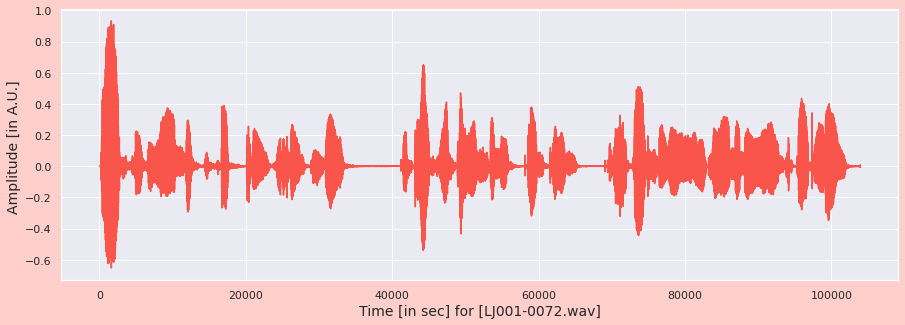


_________________________________________________________________________________________________________



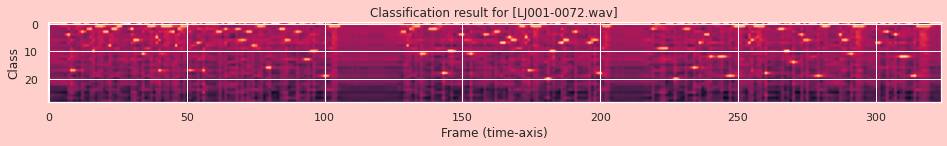

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  0,  0,  0,  4, 17, 17,  0,  0,  3,  0,  0,  2, 10,  0,
         1,  1,  3,  3,  8,  2,  2,  1,  1,  0,  0,  0,  2,  6,  6,  0, 11,  0,
         1,  1,  1,  5, 17,  1,  1,  1,  1,  3,  8,  2,  1,  1,  0, 17,  0,  0,
         7,  0, 17,  0,  0,  0,  0,  3,  3,  0,  2,  0,  0,  0,  2,  2,  6,  0,
         3,  3,  8,  0,  1,  1,  0, 16, 16,  0,  0,  0,  2,  2,  6,  0,  0,  0,
         3,  0,  0, 13, 13,  0, 10,  0,  0,  0, 19,  0,  1,  1,  1,  1,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  3,  8,  2,  0,  1,  1, 11,  0,  0,  0,  2,  2,  0,  0, 18,
         0, 10, 10,  0,  0,  4,  4,  0,  0, 11,  0,  0,  0,  0,  4,  4,  0,  0,
         3,  3,  7,  7,  0,  5,  6,  6,  0,  1,  1,  5, 17,  0,  1,  1,  1,  0,
         0,

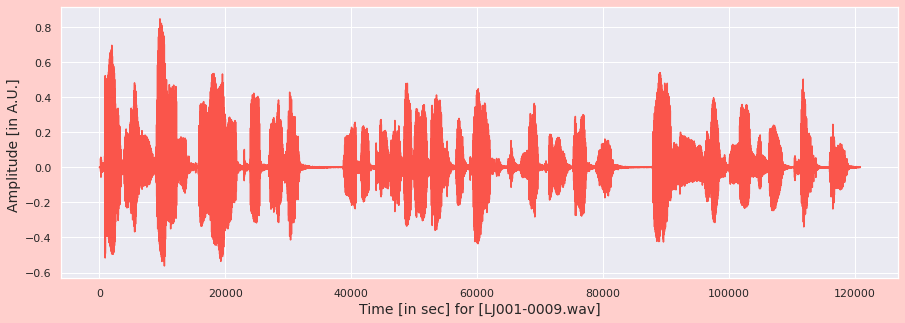


_________________________________________________________________________________________________________



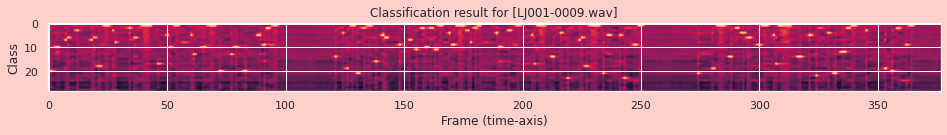

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0, 20,  0, 10, 10,  0,  0,  7,  6,  0,  0,  0,  3,  0,  0,  0,  0,  0,
         7,  6,  0, 18, 18,  1,  1,  1,  0,  3,  8,  0,  0,  0,  0,  0,  2,  0,
         6,  6,  0,  1,  1,  1,  1,  1,  0,  0, 17,  0,  0,  0,  5, 10,  0,  1,
         1,  0,  0,  0,  0,  0,  5, 13,  0,  0,  0, 10, 10,  0,  1,  1,  1,  0,
        20,  0,  0,  0,  0, 13,  0, 10,  0,  0, 20, 20,  0,  0,  0,  0,  5,  5,
         9,  9,  2,  2,  0,  1,  1,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0, 14,  0,  0,  4,  0,
        19,  0,  1,  1, 21, 21,  0,  2,  0,  1,  1,  0, 16,  0,  0,  5,  6,  6,
         0,  0,  0,  0,  9,  0,  0,  0,  7,  0,  0, 11,  0,  2,  2, 10, 10,  2,
         2, 11, 11,  1,  1,  0,  0,  4,  9,  9,  1,  1,  1,  1,  0,  3,  8,  0,
         2,

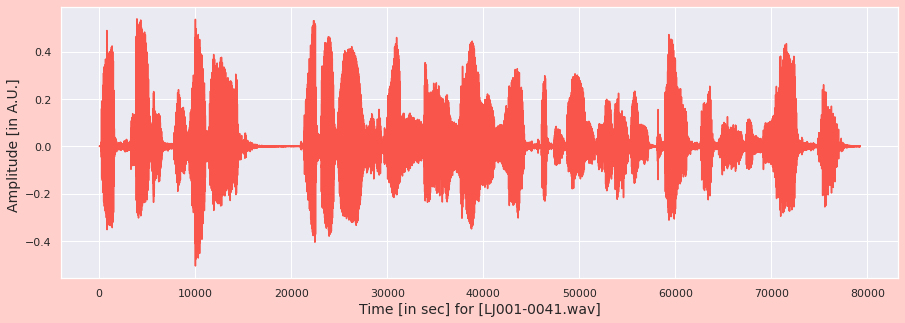


_________________________________________________________________________________________________________



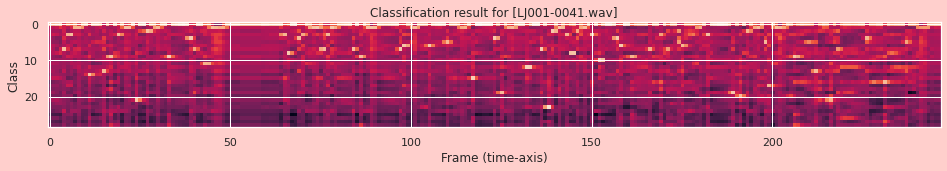

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')
Predict a sequence of tokens tensor([ 0,  0,  0,  0,  7,  3,  3,  1,  1,  0,  0, 14,  0,  0,  0, 13,  0,  9,
         0,  3,  0,  1,  1,  0, 21,  0,  0,  2,  0,  0,  1,  0,  0,  9,  0,  0,
         0,  0,  0,  4,  7,  0,  0, 11, 11,  1,  1,  1,  1,  0,  0,  0,  0,  0,
         0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  3,  8,  0,  0,  4,  3,  0,
         1,  1,  1,  7,  7,  3,  1,  1,  0,  0,  0,  0,  7,  0,  9,  0,  1,  1,
         1,  0,  0,  0,  0,  0,  0,  7,  6,  0,  1,  1,  0,  0,  0,  6,  0,  0,
         0,  0,  5,  0,  0,  0,  1,  1,  0, 15,  0,  0,  0,  0,  0,  4,  0, 19,
         0,  1,  1,  0,  0,  0, 12, 12,  0,  0,  7,  0, 23,  2,  0,  1,  1,  3,
         8,  8,  2,  1,  1,  0,  3,  0, 10, 10,  0,  0,  0,  4,  6,  0,  0,  9,
         0,  0,  0,  0,  7,  0,  0,  3,  0,  7,  0,  0,  5,  6,  0,  0,  0,  1,
         1,

In [43]:
%%time
for f in onlyfiles:
  decoding_method('/content/wavs/'+f)
  print('\n________________________________________________________________________________________________\n')

> DataFrame of the results

In [44]:
#save the results into the dataframe
df['transcript'] = result_ts
df['file_name'] = result_file_name

In [45]:
#sort the data fram by audio name 
df = df.sort_values(by='file_name', ascending=True)
df

,transcript,file_name
45,PRINTING|IN|THE|ONLY|SENSE|WITH|WHICH|WE|ARE|A...,LJ001-0001.wav
47,IN|BEING|COMPARATIVELY|MODERN|,LJ001-0002.wav
13,FOR|ALTHOUGH|THE|CHINESE|TOOK|IMPRESSIONS|FROM...,LJ001-0003.wav
40,PRODUCED|THE|BLOCK|BOOKS|WHICH|WERE|THE|IMMEDI...,LJ001-0004.wav
42,THE|INVENTION|OF|MOVABLE|METAL|LETTERS|IN|THE|...,LJ001-0005.wav
...,...,...
20,HAVE|NOW|COME|INTO|GENERAL|USE|AND|ARE|OBVIOUS...,LJ001-0096.wav
91,A|LITTLE|REDUCED|IN|UGLINESS|THE|DESIGN|OF|THE...,LJ001-0097.wav
2,AND|THE|WHOLE|EFFECT|IS|A|LITTLE|TOO|GREY|OWIN...,LJ001-0098.wav
5,IT|MUST|BE|REMEMBERED|HOWEVER|THAT|MOST|MODERN...,LJ001-0099.wav


> ## <a> Task 4: evaluate the performance of the trained model on the testing dataset using Word Error Rate `(WER)`, Match Error Rate `(MER)` </a>

> **Hint:** consider this package, [Link](https://pypi.org/project/jiwer/)

> ### <a> <center> WER vs MER

> **WER (word error rate)**, commonly used in ASR assessment, measures the cost of restoring the output word sequence to the original input sequence. And also it's the most common metric of measuring the performance of a Speech Recognition or Machine translation system

> <a> **`WER = ((S + D + I) / N) = ((S + D + I) / (S + D + C))`**

> where: 

> 1. `S` is the number of substitutions,

> 2. `D` is the number of deletions,
 
> 3. `I` is the number of insertions,

> 4. `C` is the number of correct words,

> 5. `N` is the number of words in the reference (N=S+D+C).

> Note: The lower the value, the better the performance of the ASR system, with a WER of 0 being a perfect score.

> [AWS Source](https://aws.amazon.com/blogs/machine-learning/evaluating-an-automatic-speech-recognition-service/)


>**MER (match error rate)** is the proportion of I/O word matches which are errors.

> [Source](https://www.isca-speech.org/archive/interspeech_2004/morris04_interspeech.html)

> We need to read the Excel file `labels_df` to get the string from it.

In [46]:
#reading the labels CSV file
labels_df = pd.read_csv('/content/labels.csv', sep = '|', names = ['file_Name', 'transcript', 'transcript_2'])
labels_df

,file_Name,transcript,transcript_2
0,LJ001-0001,"Printing, in the only sense with which we are ...","Printing, in the only sense with which we are ..."
1,LJ001-0002,in being comparatively modern.,"in being comparatively modern.,,,,,,,,,,,,,,,,,,,"
2,LJ001-0003,For although the Chinese took impressions from...,For although the Chinese took impressions from...
3,LJ001-0004,"produced the block books, which were the immed...","produced the block books, which were the immed..."
4,LJ001-0005,the invention of movable metal letters in the ...,the invention of movable metal letters in the ...
...,...,...,...
518,LJ002-0334,"Again, there was no regular allowance of fuel....","Again, there was no regular allowance of fuel...."
519,LJ002-0335,"so were candles, salt, pepper, mops and brooms...","so were candles, salt, pepper, mops and brooms..."
520,LJ002-0336,"indeed the place, with its oak floors caulked ...","indeed the place, with its oak floors caulked ..."
521,LJ002-0337,could not be made even to look clean while the...,could not be made even to look clean while the...


> Note: the `labels` csv file has `523` rows ,but we have only `100` rows in our dataframe . So we will choose the first `100` rows to evaluate the performance of the trained model.

> Another note: `transcript` and `transcript_2` columns they look a lot like each other , so we will handle first one.

In [47]:
labels_df = labels_df[:100]
labels_df = labels_df[['file_Name', 'transcript']]
labels_df

,file_Name,transcript
0,LJ001-0001,"Printing, in the only sense with which we are ..."
1,LJ001-0002,in being comparatively modern.
2,LJ001-0003,For although the Chinese took impressions from...
3,LJ001-0004,"produced the block books, which were the immed..."
4,LJ001-0005,the invention of movable metal letters in the ...
...,...,...
95,LJ001-0096,have now come into general use and are obvious...
96,LJ001-0097,a little reduced in ugliness. The design of th...
97,LJ001-0098,"and the whole effect is a little too gray, owi..."
98,LJ001-0099,"It must be remembered, however, that most mode..."


> As can be seen we don't have any duplications 

In [48]:
# data desctibtion
labels_df.describe()

,file_Name,transcript
count,100,100
unique,100,100
top,LJ001-0001,"Printing, in the only sense with which we are ..."
freq,1,1


> ### <A> Data Preprocessing before using `jiwer`

> 1. Convert to lower case
2. Remove punctuation and the separator
3. convert all whitespaces (tabs etc.) to single wspace

> Method `preprocess_text` is to handle both the prediction and label datasets

In [49]:
def preprocess_text(text):
  # Convert to lower case
  text = text.lower()
  # Remove punctuation
  text = re.sub(r'[^\w\s]', " ", text)
  # convert all whitespaces (tabs etc.) to single wspace
  text = re.sub(r"\s+", " ", text)
  text = text.strip()
  return text

> applying the `preprocess_text` Function on `transcript` column and create a new column called `preprocessed_transcript` column for both datasets.

In [50]:
%%time
# apply the preprocess_text Function on Transcript column and create a new column called preprocessed_transcript column
df['preprocessed_transcript'] = df['transcript']
df['preprocessed_transcript'] = df['preprocessed_transcript'].apply(lambda x: str(x))
df['preprocessed_transcript'] = df['preprocessed_transcript'].apply(lambda x: preprocess_text(x))

CPU times: user 5.13 ms, sys: 0 ns, total: 5.13 ms
Wall time: 6.95 ms


In [51]:
%%time
labels_df['preprocessed_transcript'] = labels_df['transcript']
labels_df['preprocessed_transcript'] = labels_df['preprocessed_transcript'].apply(lambda x: str(x))
labels_df['preprocessed_transcript'] = labels_df['preprocessed_transcript'].apply(lambda x: preprocess_text(x))

CPU times: user 4.4 ms, sys: 0 ns, total: 4.4 ms
Wall time: 4.43 ms


In [52]:
df.head()

,transcript,file_name,preprocessed_transcript
45,PRINTING|IN|THE|ONLY|SENSE|WITH|WHICH|WE|ARE|A...,LJ001-0001.wav,printing in the only sense with which we are a...
47,IN|BEING|COMPARATIVELY|MODERN|,LJ001-0002.wav,in being comparatively modern
13,FOR|ALTHOUGH|THE|CHINESE|TOOK|IMPRESSIONS|FROM...,LJ001-0003.wav,for although the chinese took impressions from...
40,PRODUCED|THE|BLOCK|BOOKS|WHICH|WERE|THE|IMMEDI...,LJ001-0004.wav,produced the block books which were the immedi...
42,THE|INVENTION|OF|MOVABLE|METAL|LETTERS|IN|THE|...,LJ001-0005.wav,the invention of movable metal letters in the ...


In [53]:
labels_df.head()

,file_Name,transcript,preprocessed_transcript
0,LJ001-0001,"Printing, in the only sense with which we are ...",printing in the only sense with which we are a...
1,LJ001-0002,in being comparatively modern.,in being comparatively modern
2,LJ001-0003,For although the Chinese took impressions from...,for although the chinese took impressions from...
3,LJ001-0004,"produced the block books, which were the immed...",produced the block books which were the immedi...
4,LJ001-0005,the invention of movable metal letters in the ...,the invention of movable metal letters in the ...


> checking for and dupicates

In [54]:
#data describtion
df.describe()

,transcript,file_name,preprocessed_transcript
count,100,100,100
unique,100,100,100
top,PRINTING|IN|THE|ONLY|SENSE|WITH|WHICH|WE|ARE|A...,LJ001-0001.wav,printing in the only sense with which we are a...
freq,1,1,1


In [55]:
#data describtion
labels_df.describe()

,file_Name,transcript,preprocessed_transcript
count,100,100,100
unique,100,100,100
top,LJ001-0001,"Printing, in the only sense with which we are ...",printing in the only sense with which we are a...
freq,1,1,1


> ### <a> Applying The Word Error Rate `(WER)` & Match Error Rate `(MER)`

In [56]:
# collect the score in a list
error_wer = [ wer(labels_df['preprocessed_transcript'][i], df['preprocessed_transcript'][i]) for i in range(100) ]
error_mer = [ mer(labels_df['preprocessed_transcript'][i], df['preprocessed_transcript'][i]) for i in range(100) ]

In [57]:
# new dataframe to put the result
result_df = pd.DataFrame()
result_df['audio_name'] = df['file_name']
result_df['predicted_transcript'] = df['preprocessed_transcript']
# we will use tolist function to ignore the unsorted index
result_df['labels_transcript'] = labels_df['preprocessed_transcript'].tolist()
result_df['WER_SCORE'] = error_wer
result_df['MER_SCORE'] = error_mer

In [58]:
result_df.head()

,audio_name,predicted_transcript,labels_transcript,WER_SCORE,MER_SCORE
45,LJ001-0001.wav,printing in the only sense with which we are a...,printing in the only sense with which we are a...,0.962963,0.896552
47,LJ001-0002.wav,in being comparatively modern,in being comparatively modern,4.750000,0.950000
13,LJ001-0003.wav,for although the chinese took impressions from...,for although the chinese took impressions from...,0.833333,0.833333
40,LJ001-0004.wav,produced the block books which were the immedi...,produced the block books which were the immedi...,0.928571,0.928571
42,LJ001-0005.wav,the invention of movable metal letters in the ...,the invention of movable metal letters in the ...,0.920000,0.920000


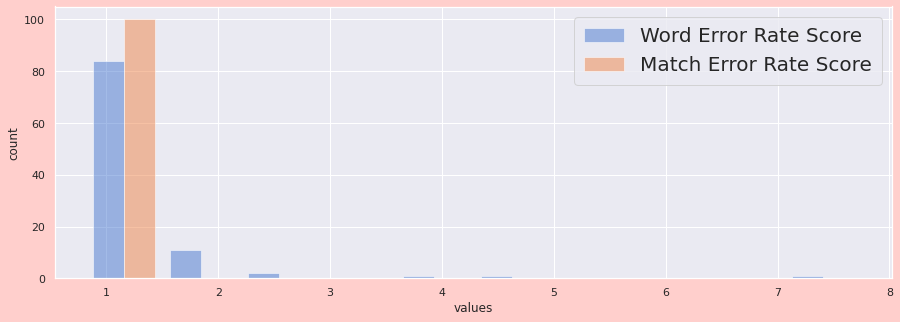

In [59]:
#plot
plt.figure(figsize=(15,5), facecolor='#ffcfcc')
plt.hist([result_df['WER_SCORE'],result_df['MER_SCORE']], label = ['Word Error Rate Score','Match Error Rate Score'], bins = 10, alpha = 0.5)
plt.legend(borderpad = 0.5, fontsize=20)
plt.ylabel('count')
plt.xlabel('values')
plt.show()


> ## <a> Task 5: check files with the worst performance and perform a simple error analysis, e.g.,

> ## <a> 1. What are the files having worser performance, 

> ## <a> 2. And what are the potential reasons, 


> ## <a> 3. Do they share any common patterns?


> *   ### <a> The files with the worst performance:

> As we know from the `WER` and `MER` comparison , The wave with `lower` `WER` value it has the `better` performance.


>  So , to know the files with the worst performance we need to get the `WER` with the higher values

In [60]:
# TODO code for task 5
result_df = result_df.sort_values(by='WER_SCORE', ascending=False)
result_df.head()

,audio_name,predicted_transcript,labels_transcript,WER_SCORE,MER_SCORE
90,LJ001-0008.wav,has never been surpassed,has never been surpassed,7.750000,1.000000
47,LJ001-0002.wav,in being comparatively modern,in being comparatively modern,4.750000,0.950000
73,LJ001-0045.wav,fourteen sixty nine fourteen seventy,1469 1470,4.000000,1.000000
78,LJ001-0078.wav,to improve the letter in form,to improve the letter in form,2.833333,1.000000
38,LJ001-0090.wav,with this change the art of printing touched b...,with this change the art of printing touched b...,2.555556,0.958333


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


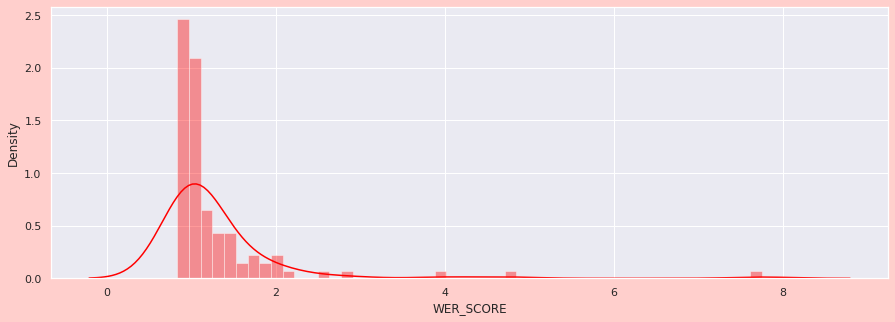

In [61]:
# the distribution of WER_SCORE
plt.figure(figsize=(15,5), facecolor='#ffcfcc')
sns.distplot(result_df['WER_SCORE'], color='red')
plt.show()

> As can be seen from this distribution, we can ignore values `greater than or equal` to `2.0`

In [139]:
# get all the records which has WER_SCORE less than or equal 2.0
# so the worst files will be greater than 2.0
temp_df = pd.DataFrame()
temp_df = result_df.loc[(result_df['WER_SCORE'] > 2.0)]
print('No. of rows : ',len(temp_df),'\n')
temp_df

No. of rows :  7 



,audio_name,predicted_transcript,labels_transcript,WER_SCORE,MER_SCORE
90,LJ001-0008.wav,has never been surpassed,has never been surpassed,7.750000,1.000000
47,LJ001-0002.wav,in being comparatively modern,in being comparatively modern,4.750000,0.950000
73,LJ001-0045.wav,fourteen sixty nine fourteen seventy,1469 1470,4.000000,1.000000
78,LJ001-0078.wav,to improve the letter in form,to improve the letter in form,2.833333,1.000000
38,LJ001-0090.wav,with this change the art of printing touched b...,with this change the art of printing touched b...,2.555556,0.958333
87,LJ001-0043.wav,further development of the roman letter took p...,a further development of the roman letter took...,2.090909,0.920000
49,LJ001-0084.wav,but for the beauty of the earlier work they mi...,but for the beauty of the earlier work they mi...,2.076923,0.964286


> What should the WER be if you want good transcripts? 

> The lower the `WER`, the more accurate the system. However, the `WER` threshold that determines whether an ASR system is suitable for your application ultimately depends on your needs, budget, and resources.

> By this threshold `2.0` we have `7` files with the worst performance but of course we can increase these number of files by decrease this threshold.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


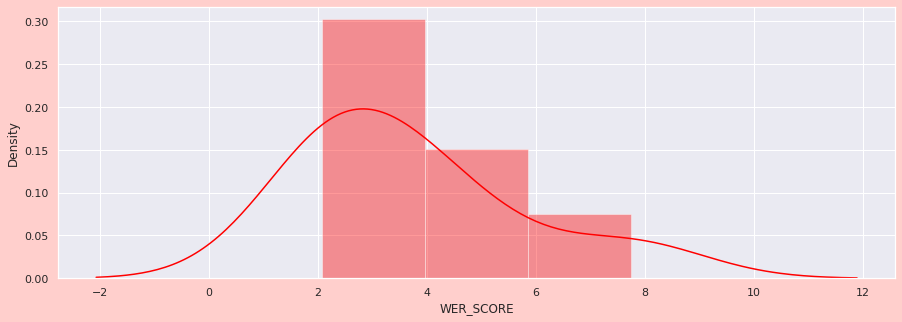

In [142]:
# plot distribution
plt.figure(figsize=(15,5), facecolor='#ffcfcc')
sns.distplot(temp_df['WER_SCORE'], color='red')
plt.show()

> If we need to get the worst performance according to `MER` method.

> we can save the Audio files with high performance values.




> *   ### <a> There are some potential reasons for that such as : 

> 


> #### 1. To quantify `WER`, there are three categories of errors:
 
>  *    <a>**Substitutions**</a> – When the system transcribes one word in place of another. Transcribing the fifth word as `this` instead of `the` is an example of a substitution error.


> *  <a>**Deletions**</a> – When the system misses a word entirely. In the example, the system deleted the first word `well`.


> *  <a>**Insertions**</a> – When the system adds a word into the transcript that the speaker didn’t say, such as `or` inserted at the end of the example.

> Of course, counting errors in terms of substitutions, deletions, and insertions isn’t always straightforward. If the speaker says`to get suga` and the system transcribes `kept shook or`, one person might count that as a deletion (`to`), two substitutions (`kept` instead of `get` and `shook` instead of `sugar`), and an insertion (`or`). A second person might count that as three substitutions (`kept` instead of `to`, `shook` instead of `get`, and `or` instead of `sugar`).

> #### 2. The preprocessing may not cover all cases such as:
* Common English Abbreviations for example:
  * `I'm` insted of `I am` , `I'll` insted of `I will` or `won't` insted of `will not`.
* misssing some punctuation.

> #### 3. Some smart assistant systems such as 'siri' have some issues with humans' names , they have different tone and accent .


> #### 4. Related issue is that `WER` by definition counts the number of whole word errors. Many tools define words as strings separated by spaces for this calculation, but not all writing systems use spaces to separate words. In this case, you may need to tokenize the text before calculating WER. 

> Alternatively, for writing systems where a single character often represents a word (such as Chinese), you can calculate a `character error rate` instead of a `word error rate`, using the same procedure.


> *   ### <a> Do they share any common patterns?

In [148]:
# this for loop to display the records to detect the patterns 
for i in range(len(temp_df)):
  print('Row with index : >>',i,'<<.')
  print('predicted_transcript :' , temp_df.iloc[i]['predicted_transcript'].split() ,' \nlabels_transcript    :' ,temp_df.iloc[i]['labels_transcript'].split())
  print('MER score : ',temp_df.iloc[i]['MER_SCORE'] , '  WER score : ',temp_df.iloc[i]['WER_SCORE'],'\n')
  print('____________________________________________________________________\n')

Row with index : >> 0 <<.
predicted_transcript : ['has', 'never', 'been', 'surpassed']  
labels_transcript    : ['has', 'never', 'been', 'surpassed']
MER score :  1.0   WER score :  7.75 

____________________________________________________________________

Row with index : >> 1 <<.
predicted_transcript : ['in', 'being', 'comparatively', 'modern']  
labels_transcript    : ['in', 'being', 'comparatively', 'modern']
MER score :  0.95   WER score :  4.75 

____________________________________________________________________

Row with index : >> 2 <<.
predicted_transcript : ['fourteen', 'sixty', 'nine', 'fourteen', 'seventy']  
labels_transcript    : ['1469', '1470']
MER score :  1.0   WER score :  4.0 

____________________________________________________________________

Row with index : >> 3 <<.
predicted_transcript : ['to', 'improve', 'the', 'letter', 'in', 'form']  
labels_transcript    : ['to', 'improve', 'the', 'letter', 'in', 'form']
MER score :  1.0   WER score :  2.8333333333333

> The number `['1469', '1470']` in the record with index `2` , the spelled using numerals rather than the alphabet.

> By applying these same strategies to both the reference and the hypothesis transcripts, we can ensure that different spelling choices aren’t counted as word errors.

> In the record with index `5` ,the system deleted the first character `a`

> So Do they share any common patterns?  The answer is `No` or `maybe Yes` if there is another reason but i haven't figured it out.

> But maybe we can figure out any patterns if we change the threshold.

# **<a>Resources.</a>**

There are a lot of resources, but these are among the most important sources that helped me and I learned from them.

**Note:** The code sources were mentioned to each cell separately.


> [Speech recognition pipeline tutorial](https://colab.research.google.com/github/pytorch/audio/blob/gh-pages/main/_downloads/ca83af2ea8d7db05fb63211d515b7fde/speech_recognition_pipeline_tutorial.ipynb#scrollTo=eptHo02sc_-P)

> [Evaluating an automatic speech recognition service](https://aws.amazon.com/blogs/machine-learning/evaluating-an-automatic-speech-recognition-service/)


> [Wav2vec2 a framework for self supervised learning of speech representations](https://towardsdatascience.com/wav2vec-2-0-a-framework-for-self-supervised-learning-of-speech-representations-7d3728688cae)


> [Jiwer ](https://pypi.org/project/jiwer/)

> [Speech representation and data exploration](https://www.kaggle.com/code/davids1992/speech-representation-and-data-exploration/notebook)

> [Speech recognition pipeline tutorial](https://pytorch.org/tutorials/intermediate/speech_recognition_pipeline_tutorial.html)

> [Kaggle Notebook Numbers anom1](https://www.kaggle.com/code/esraaashraf99/numbers-anom1)









